In [1]:
import os
import re
import glob
from pathlib import Path
import shutil
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.ticker as ticker
import pickle


- 1 Byte= 8 bits 2 Byte= 16 bits
- The number of digits = 2^(2 Byte)= 2^(16 bits)= 65536
- https://www.scaler.com/topics/c/data-types-in-c/
- here size_t is used that has a min size of 8 bytes 


## Preparing data functions

- drop 10 rows of any transfer CSV
- Remove faulty data that is beyond max and min transfer value

In [2]:
# https://pythonforundergradengineers.com/unicode-characters-in-python.html
print('\u0394')
print('-', '--', '-.', ':', 'None', ' ', '', 'solid', 'dashed', 'dashdot', 'dotted')
print('Omega: \u03A9') # Ω
print('Lamda: \u03BB') # λ  

Δ
- -- -. : None    solid dashed dashdot dotted
Omega: Ω
Lamda: λ


## arranging results into folders 


In [2]:
def transferAnalysisDoc(resultFolder, docSourceDataPath = None):
    """Folder name : resultFolder
    Subfolder 1: ajapath to the source folder
    """

    resultPath = os.path.join(os.getcwd(), resultFolder)
    os.makedirs(resultPath, exist_ok=True) 

    global printed

    for doc in glob.glob(f'{docSourceDataPath}/*'):
        print('sadfd', doc)
        docName = str(doc).split("/")[-1:]
        docName = re.sub(r"\"|\[|\'|\]", "", str(docName))
        print(docName)
        if docName == "CombinedPingPongLatency.png" or docName == 'pingPongDics.pickle':
            shutil.move(str(doc), str(resultPath))
            continue
        else:
            compiler = docName.split('.')[0].split('_')[-1]
            library = docName.split('.')[0].split('_')[-2]
            print(f'Compiler: {compiler} Library: {library}')

            validSubFolders = ['openMPIProcess', 'intelMPIProcess', 
                               'gnuCompiler', 'intelCompiler']
            if library not in validSubFolders or compiler not in validSubFolders:
                print(f'Invalid sub folder library->{library} and compiler->{compiler} used in\n{doc}')
                continue
    
        
        if library in ['openMPIProcess', 'intelMPIProcess'] and compiler in ['gnuCompiler', 'intelCompiler']:
            subFolderPath = os.path.join(resultPath, library, compiler)
            # print(subFolderPath)
            os.makedirs(subFolderPath, exist_ok=True)
        else:
            print(f'UnIdentified {compiler}/{library} name used in {doc}')
        shutil.move(str(doc), str(subFolderPath))

transferAnalysisDoc(resultFolder = 'Results_2', docSourceDataPath = "/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results" )


sadfd /home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results/pingPongDics.pickle
pingPongDics.pickle


Error: Destination path '/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/Results_2/pingPongDics.pickle' already exists

## code dev

In [3]:

def prepCsvData(path, minData = 0):
    """ Reads all csv files in a folder and returns a dataframe with the data from all the files.
    The dataframe is filtered to only include data between minData and maxData. """

    csv_files = glob.glob(os.path.join(path, "*.csv"))
    # print(len(csv_files))
    df = pd.concat([pd.read_csv(file).iloc[10:] for file in csv_files ], 
                   axis = 0, ignore_index=True)
    df.dropna(axis=0, inplace = True)
    df['BytesData(B)'] = df['BytesData(B)'] #.astype(int)
    df = df[(df['BytesData(B)'] > minData)] #&(df['BytesData'] <= maxData)] 
    df['Bits'] = df['BytesData(B)'] * 8
    dfs = df.groupby(['TransferPattern', 'ProcessID'])
    data = []
    for i, (name, df_) in enumerate(dfs):
        pattern, process  = name[0], name[1]
        if process == df_['SenderProcID'].unique():
            df_['SendTime'] = df_['TransitTime'] - df_['StartTime']
            df_['ReceiveTime'] = df_['EndTime'] - df_['TransitTime']
            df_['RoundTripTime'] = df_['EndTime'] - df_['StartTime']
        elif process != df_['SenderProcID'].unique():
            df_['SendTime'] = df_['EndTime'] - df_['TransitTime'] 
            df_['ReceiveTime'] = df_['TransitTime'] - df_['StartTime']
            df_['RoundTripTime'] = df_['EndTime'] - df_['StartTime']
        data.append(df_)
    data = pd.concat(data)
    data
    
    return data


def prepDicDataFrame(fileName, df): 
    """ Prepares a dictionary with one dataframe """
    fileName = re.sub(r"\"|\[|\'|\]", "", str(fileName))
    # print(fileName)
    data_ = {f'{fileName}':df}
    return data_


def extractFiles(source_path):
    """ Extracts the CSV files from the source path  """
    # Check if the source path exists
    if not os.path.exists(source_path):
        print(f"Source path {source_path} does not exist.")
        return
    # Extract directories that contains the CSV files into csvFilePath and 
    data_ = {}
    csvFilePath = []
    # goes all the way to store the paths with csv
    for root, directories, _ in os.walk(source_path):
        for directory in directories:
            directory_path = os.path.join(root, directory)
            # Check if the directory contains CSV files
            has_csv_files = False
            for filename in os.listdir(directory_path):
                if filename.endswith('.csv'):
                    has_csv_files = True
                    break
            if has_csv_files:
                csvFilePath.append(directory_path)

    print('Total csv files to be made: ', len(csvFilePath))
    for csvFile in csvFilePath:
        print(f"csv data for {csvFile.split('/')[-1:]} in {csvFile}")
        data_.update(prepDicDataFrame(fileName = csvFile.split('/')[-1:],
                                      df = prepCsvData(csvFile, minData = 0)))

    return data_, csvFilePath

path = '/home/gzextschak/Code_Files/PingPongLatency'
pingPongDfs, csvFilePaths = extractFiles(source_path = path)
for name, df in pingPongDfs.items():
    print(name)
# print(pingPongDfs.keys())
savePath = "/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results"
with open(f'{savePath}/pingPongDics.pickle', 'wb') as f:
    pickle.dump(pingPongDfs, f)

Total csv files to be made:  16
csv data for ['std96_same_openMPI_intel'] in /home/gzextschak/Code_Files/PingPongLatency/openMPI/intelCompiler/same/std96_same_openMPI_intel
csv data for ['med40_same_openMPI_intel'] in /home/gzextschak/Code_Files/PingPongLatency/openMPI/intelCompiler/same/med40_same_openMPI_intel
csv data for ['std96_diff_openMPI_intel'] in /home/gzextschak/Code_Files/PingPongLatency/openMPI/intelCompiler/diff/std96_diff_openMPI_intel
csv data for ['med40_diff_openMPI_intel'] in /home/gzextschak/Code_Files/PingPongLatency/openMPI/intelCompiler/diff/med40_diff_openMPI_intel
csv data for ['std96_same_openMPI_gnu'] in /home/gzextschak/Code_Files/PingPongLatency/openMPI/gnuCompiler/same/std96_same_openMPI_gnu
csv data for ['med40_same_openMPI_gnu'] in /home/gzextschak/Code_Files/PingPongLatency/openMPI/gnuCompiler/same/med40_same_openMPI_gnu
csv data for ['med40_diff_openMPI_gnu'] in /home/gzextschak/Code_Files/PingPongLatency/openMPI/gnuCompiler/diff/med40_diff_openMPI_gnu

## Available data
- following the common pdf page name and the differet splits of the name for the plots
    - parts = re.sub(r"\"|\[|\]|\'", "", name).split("_")
    - {partition}Partition_{nodeInfoText}Node_{process}Process_{compiler}Compiler
    - partition, nodeInfoText, process, compiler = f'{parts[0]}',f'{parts[1]}', f'{parts[2]}', f'{parts[3]}'

- print('Omega: \u03bc')

In [4]:
savePath = "/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results"
with open(f"{savePath}/pingPongDics.pickle", 'rb') as f:
    pingPongDfs = pickle.load(f)
    data_frames = pingPongDfs


for name, df in pingPongDfs.items():
    groupData = df.groupby('TransferPattern')
    print(f"Partition --> {name}")
    for i, (name, group_df) in enumerate(groupData):
        if name =='A2B':
            name = '(0-1-0)A2B'
        elif name == 'B2A':
            name = '(1-0-1)B2A'

        max_data = np.max(group_df['GigaBytesData(GB)'])

        print(f"** Pattern: {name} **")
        print(f"** Maximum Transfer Data: {max_data:.2f} GB**")  # Format for two decimal places

        print(f"\n *** Receive Time ***")
        print(f"   -- Minimum: {np.min(group_df['ReceiveTime']):.6f} seconds")  # Format for microseconds
        print(f"   -- Maximum: {np.max(group_df['ReceiveTime']):.6f} seconds")
        print(f"\n *** Send Time ***")
        print(f"   -- Minimum: {np.min(group_df['SendTime']):.6f} seconds")
        print(f"   -- Maximum: {np.max(group_df['SendTime']):.6f} seconds")
        print(f"\n *** Round Trip Time ***")
        print(f"   -- Minimum: {np.min(group_df['RoundTripTime']):.6f} seconds")
        print(f"   -- Maximum: {np.max(group_df['RoundTripTime']):.6f} seconds\n")

    print("===========================================================================\n")
        # print(df.head()) /
        # break
    # break
# df.describe().T
        # break
df.describe().T  
   

Partition --> std96_same_openMPI_intel
** Pattern: (0-1-0)A2B **
** Maximum Transfer Data: 1.84 GB**

 *** Receive Time ***
   -- Minimum: 0.000000 seconds
   -- Maximum: 0.504895 seconds

 *** Send Time ***
   -- Minimum: 0.000000 seconds
   -- Maximum: 0.504895 seconds

 *** Round Trip Time ***
   -- Minimum: 0.000000 seconds
   -- Maximum: 1.001710 seconds

** Pattern: (1-0-1)B2A **
** Maximum Transfer Data: 1.84 GB**

 *** Receive Time ***
   -- Minimum: 0.000000 seconds
   -- Maximum: 0.504582 seconds

 *** Send Time ***
   -- Minimum: 0.000000 seconds
   -- Maximum: 0.504580 seconds

 *** Round Trip Time ***
   -- Minimum: 0.000000 seconds
   -- Maximum: 1.001906 seconds


Partition --> med40_same_openMPI_intel
** Pattern: (0-1-0)A2B **
** Maximum Transfer Data: 1.84 GB**

 *** Receive Time ***
   -- Minimum: 0.000000 seconds
   -- Maximum: 0.506408 seconds

 *** Send Time ***
   -- Minimum: 0.000000 seconds
   -- Maximum: 0.506392 seconds

 *** Round Trip Time ***
   -- Minimum:

,count,mean,std,min,25%,50%,75%,max
ProcessID,360360.0,5.000000e-01,5.000007e-01,0.000000e+00,0.000000e+00,5.000000e-01,1.000000e+00,1.000000e+00
Iterations,360360.0,5.055000e+02,2.857886e+02,1.100000e+01,2.580000e+02,5.055000e+02,7.530000e+02,1.000000e+03
BytesData(B),360360.0,1.170515e+08,3.530123e+08,1.000000e+00,2.560000e+02,6.553600e+04,1.434891e+07,1.977327e+09
GigaBytesData(GB),360360.0,1.090127e-01,3.287683e-01,9.313226e-10,2.384186e-07,6.103516e-05,1.336346e-02,1.841529e+00
StartTime,360360.0,4.757905e+06,1.361943e+03,4.756454e+06,4.756468e+06,4.757281e+06,4.759168e+06,4.760453e+06
TransitTime,360360.0,4.757905e+06,1.361948e+03,4.756454e+06,4.756468e+06,4.757281e+06,4.759168e+06,4.760453e+06
EndTime,360360.0,4.757905e+06,1.361952e+03,4.756454e+06,4.756468e+06,4.757281e+06,4.759168e+06,4.760453e+06
SenderProcID,360360.0,5.000000e-01,5.000007e-01,0.000000e+00,0.000000e+00,5.000000e-01,1.000000e+00,1.000000e+00
Bits,360360.0,9.364121e+08,2.824098e+09,8.000000e+00,2.048000e+03,5.242880e+05,1.147913e+08,1.581861e+10
SendTime,360360.0,1.081696e-02,3.270767e-02,1.778826e-07,3.017485e-07,2.228236e-05,1.192654e-03,2.557161e-01


In [5]:
df.head()

,ProcessID,Iterations,TransferPattern,BytesData(B),GigaBytesData(GB),StartTime,TransitTime,EndTime,SenderProcID,Bits,SendTime,ReceiveTime,RoundTripTime
1980,0,11,A2B,256.0,2.384186e-07,4.756465e+06,4.756465e+06,4.756465e+06,0.0,2048.0,2.859160e-07,0.000003,0.000003
1981,0,12,A2B,256.0,2.384186e-07,4.756465e+06,4.756465e+06,4.756465e+06,0.0,2048.0,3.017485e-07,0.000003,0.000003
1982,0,13,A2B,256.0,2.384186e-07,4.756465e+06,4.756465e+06,4.756465e+06,0.0,2048.0,2.887100e-07,0.000003,0.000003
1983,0,14,A2B,256.0,2.384186e-07,4.756465e+06,4.756465e+06,4.756465e+06,0.0,2048.0,3.036112e-07,0.000003,0.000003
1984,0,15,A2B,256.0,2.384186e-07,4.756465e+06,4.756465e+06,4.756465e+06,0.0,2048.0,3.054738e-07,0.000003,0.000003


## PLotting the histograms

- ['std96_diff_MPI_intel']
- ['med40_diff_MPI_intel']
- ['std96_same_MPI_intel']
- ['med40_same_MPI_intel']
- ['std96_diff_openMP_intel']
- ['med40_diff_openMP_intel']
- ['med40_same_openMP_intel']
- ['std96_same_openMP_intel']
- ['std96_diff_MPI_gcc']
- ['med40_diff_MPI_gcc']
- ['std96_same_MPI_gcc']
- ['med40_same_MPI_gcc']
- ['std96_diff_openMP_gcc']
- ['med40_diff_openMP_gcc']
- ['std96_same_openMP_gcc']
- ['med40_same_openMP_gcc']

In [4]:
def histogram_plot(group_data, transfer_size, parts): #partition, nodeInfoText, process, compiler):

    """
    _summary_: Plots the histogram for the data
    
    Args:
        group_data (dataframe): Dataframe containing the data
        transfer_size (int): Data transfer size
        nodeInfoText (string): Node information
        partition (string): Partition information
        compiler (string): Compiler information 

    Returns:    
        None

    """

    data_h = group_data.groupby("TransferPattern")
    time_list = ['Receive', 'Send', 'RoundTrip']
    # _dtype = 'GigaBytesData(GB)'
    _hue = 'ProcessID'

    partition, nodeInfoText, process, compiler = f'{parts[0]}',f'{parts[1]}', f'{parts[2]}', f'{parts[3]}'

    if transfer_size > 0 and transfer_size < 1024: _transfer_size = f'{transfer_size * 1024.0 * 1024.0 * 1024.0}' + ' (Bytes)'
    elif transfer_size > 1024 and transfer_size < 1024 * 1024: _transfer_size = f'{transfer_size * 1024 * 1024}' + ' (MB)'
    elif transfer_size > 1024 * 1024 and transfer_size < 1024 * 1024 * 1024: _transfer_size = f'{transfer_size * 1024}' + ' (GB)'

    fig, axes = plt.subplots(2,3 , figsize=(30, 15), sharex = True, sharey = False) 
    fig.suptitle(f'{partition}Partition_{nodeInfoText}Node_{process}Process_{compiler}Compiler\n for {_transfer_size}')

    for i, (name, d) in enumerate(data_h):          
        sns.set_style("darkgrid", {'grid.linestyle': '--'}) 
        for j, time in enumerate(time_list):
            _time = f'{time}'+'Time'
            sns.histplot(data = d, x = _time, bins = 50, kde = True, hue = _hue, ax = axes[i][j]).set_title(f'{name}_{_time}')

    for i, ax in enumerate(axes.flatten()):
        ax.grid(True)
        ax.tick_params(axis = 'both', direction = 'in', labelleft = True, labelright = True)
    fig.tight_layout(pad=2.0)
    # plt.show()
    pdf.savefig(fig)
    # pdf.savefig(f"{savePath}")
    # plt.savefig(f"{savePath}/{plotName}.png")



In [5]:
## creating histograms med40_diff_openMPI_gnu
savePath = "/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results"
with open(f"{savePath}/pingPongDics.pickle", 'rb') as f:
    pingPongDfs = pickle.load(f)
    data_frames = pingPongDfs

for i, (name, df) in enumerate(data_frames.items()):

    parts = re.sub(r"\"|\[|\]|\'", "", name).split("_")
    pdfName = f'HitogramsTransferTime_{parts[0]}Partition_{parts[1]}Node_{parts[2]}Process_{parts[3]}Compiler'
    
    if os.path.isfile(f"/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/{pdfName}.pdf"):
        print(f"{pdfName} Present")
        continue
    else:
        print(f"{pdfName} notPresent X")
        pdf = PdfPages(f'{pdfName}.pdf')
        B_data = df.groupby('GigaBytesData(GB)')
        print('=========', name, len(B_data))

        for i, (transfer_size, group_data) in enumerate(B_data):
            histogram_plot(group_data, transfer_size, parts)
            # break
        pdf.close()
        print(f"created {pdfName}")
    # break

    

HitogramsTransferTime_std96Partition_sameNode_openMPIProcess_intelCompiler notPresent X
========= std96_same_openMPI_intel 91


/home/gzextschak/Code_Files/.venv/lib64/python3.6/site-packages/ipykernel_launcher.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


created HitogramsTransferTime_std96Partition_sameNode_openMPIProcess_intelCompiler
HitogramsTransferTime_med40Partition_sameNode_openMPIProcess_intelCompiler notPresent X
========= med40_same_openMPI_intel 91
created HitogramsTransferTime_med40Partition_sameNode_openMPIProcess_intelCompiler
HitogramsTransferTime_std96Partition_diffNode_openMPIProcess_intelCompiler notPresent X
========= std96_diff_openMPI_intel 91
created HitogramsTransferTime_std96Partition_diffNode_openMPIProcess_intelCompiler
HitogramsTransferTime_med40Partition_diffNode_openMPIProcess_intelCompiler notPresent X
========= med40_diff_openMPI_intel 91
created HitogramsTransferTime_med40Partition_diffNode_openMPIProcess_intelCompiler
HitogramsTransferTime_std96Partition_sameNode_openMPIProcess_gnuCompiler notPresent X
========= std96_same_openMPI_gnu 92
created HitogramsTransferTime_std96Partition_sameNode_openMPIProcess_gnuCompiler
HitogramsTransferTime_med40Partition_sameNode_openMPIProcess_gnuCompiler notPresent X
=

## Latency vs packet size 
### PLotting linear for each transfer data 

In [4]:
def LinePlot(data, parts, savePath, xscale, yscale, timescale):

    data_h = data.groupby("TransferPattern")
    time_list = ['Receive', 'Send', 'RoundTrip']
    _dtype = 'GigaBytesData(GB)'#'BytesData(B)'#'GigaBytesData(GB)'
    _hue = 'ProcessID'

    partition, nodeInfoText, process, compiler = f'{parts[0]}',f'{parts[1]}',f'{parts[2]}',f'{parts[3]}'
    plotName = f"LatencyPlots_{yscale}Scale_{partition}Partition_{nodeInfoText}Node_{process}Process_{compiler}Compiler.pdf"

    fig, axes = plt.subplots(4, 2, figsize=(20, 15), sharex = False, sharey = False)
    fig.suptitle(f'Latency Plots - DataPacket vs Time ({xscale}scale)\n{partition}Partition_{nodeInfoText}Node_{process}Process_{compiler}Compiler', fontsize = 20)

    for i, (name, d) in enumerate(data_h):
        if name == 'A2B': name = 'A2B TransferPattern (0->1->0) 0-sender; 1-receiver'
        elif name == 'B2A': name = 'B2A TransferPattern (1->0->1) 1-sender; 0-receiver'
        sns.set_style("darkgrid", {'grid.linestyle': '--'}) 
        for j, time in enumerate(time_list):
            _time = f'{time}'+'Time'
            y_value = d[_time] * timescale
            x_value = d[_dtype]
            sns.lineplot(data = d, x = x_value, y = y_value, hue = _hue, estimator = 'mean',
                         ax = axes[j][i] ).set_title(f'{_time}(\u03bcs) vs {_dtype}')
        sns.lineplot(data = d, x = x_value, y = data['RoundTripTime'] * timescale, 
                     ax = axes[j+1][i]).set_title(f'RoundTripTime(\u03bcs) vs {_dtype} -both processor')
        fig.text(0.15 * (3.2 * i + 1), 0.92, f'{name}', fontsize = 14)

    for i, ax in enumerate(axes.flatten()):
        ax.grid(True)
        ax.set_yscale(xscale)
        ax.set_xscale(yscale)
        ax.tick_params(axis = 'both', direction = 'in', labelleft = True, labelright = True)

    fig.tight_layout(pad = 3.0)
    fig.text(0.01, 0.5, 'Time (\u03bcs)', va = 'center', ha = 'center', rotation = 'vertical', fontsize = 14)
    fig.text(0.5, 0.01, 'Message data (GB)', va = 'center', ha = 'center',  fontsize = 14)
    plt.savefig(f"{savePath}/{plotName}")
    plt.show()

    return 


std96_same_openMPI_intel - separted:- std96 same openMPI intel


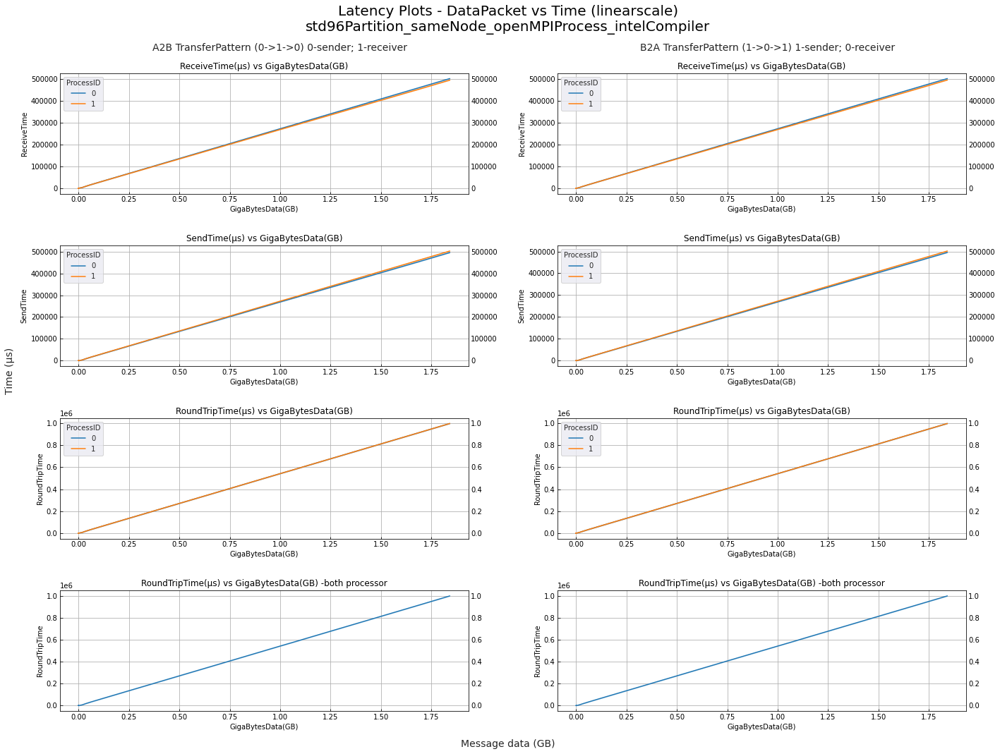

med40_same_openMPI_intel - separted:- med40 same openMPI intel


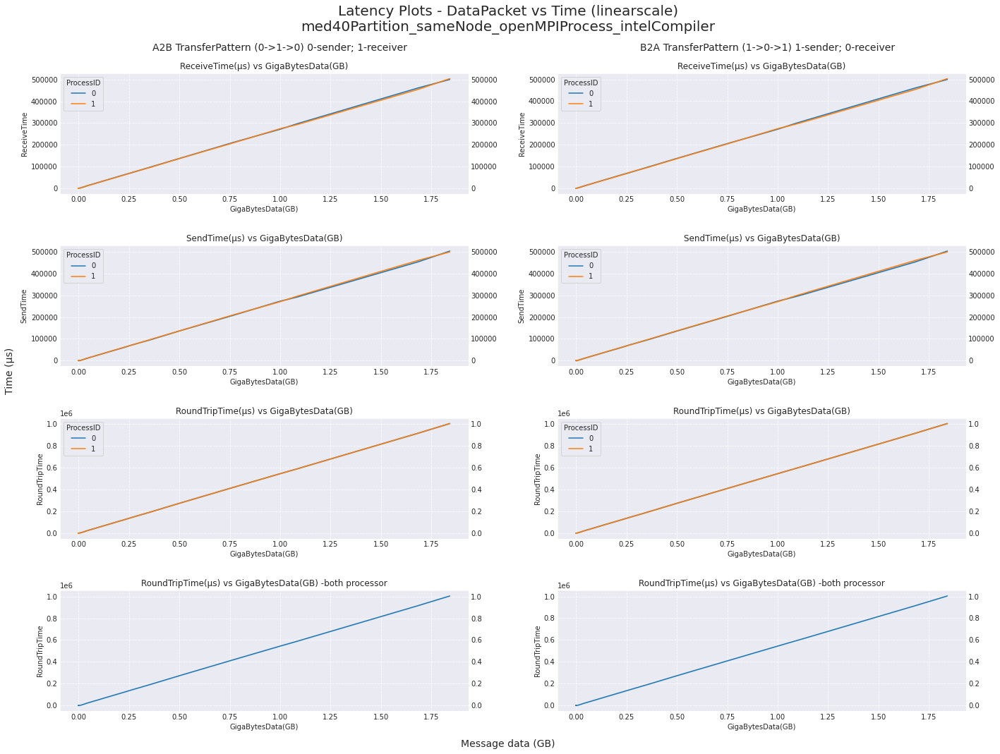

std96_diff_openMPI_intel - separted:- std96 diff openMPI intel


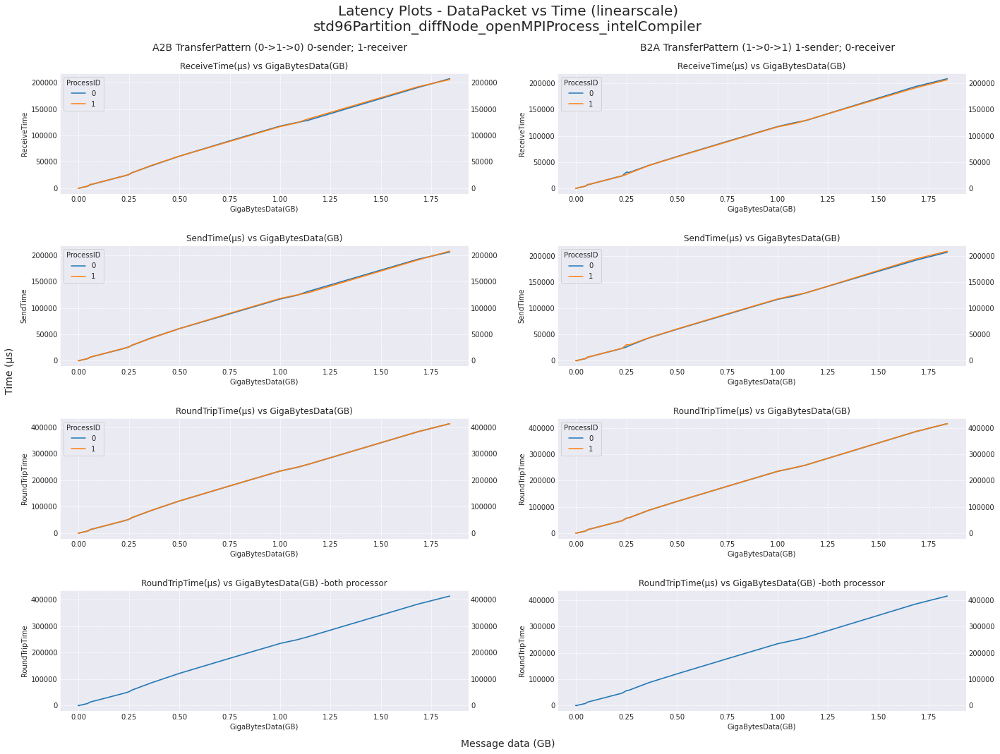

med40_diff_openMPI_intel - separted:- med40 diff openMPI intel


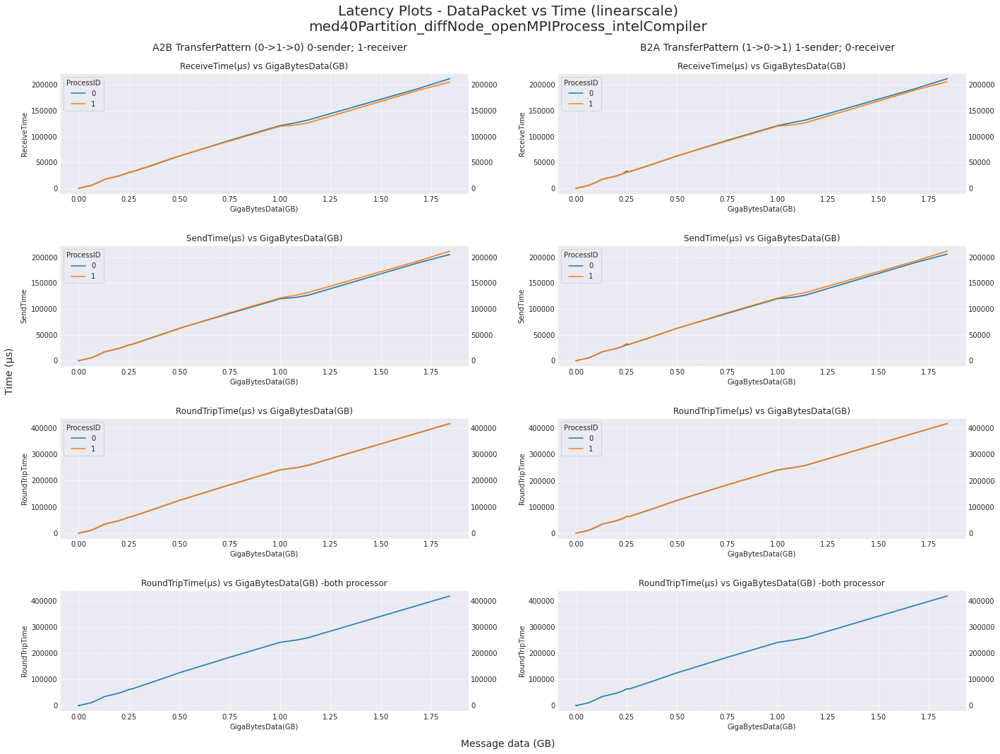

std96_same_openMPI_gnu - separted:- std96 same openMPI gnu


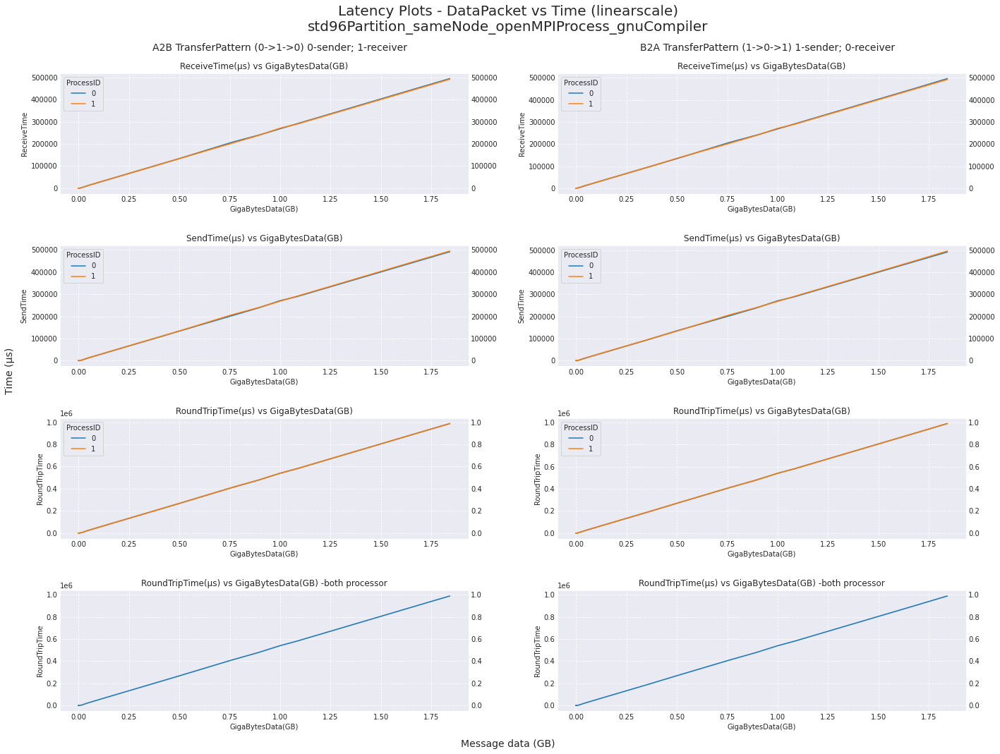

med40_same_openMPI_gnu - separted:- med40 same openMPI gnu


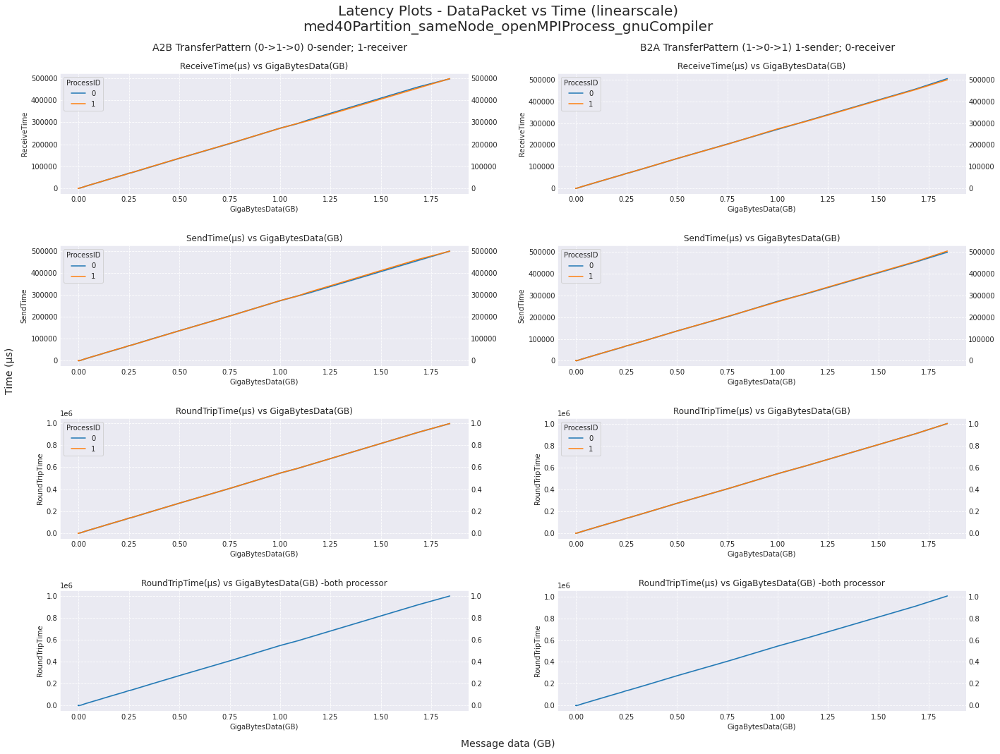

med40_diff_openMPI_gnu - separted:- med40 diff openMPI gnu


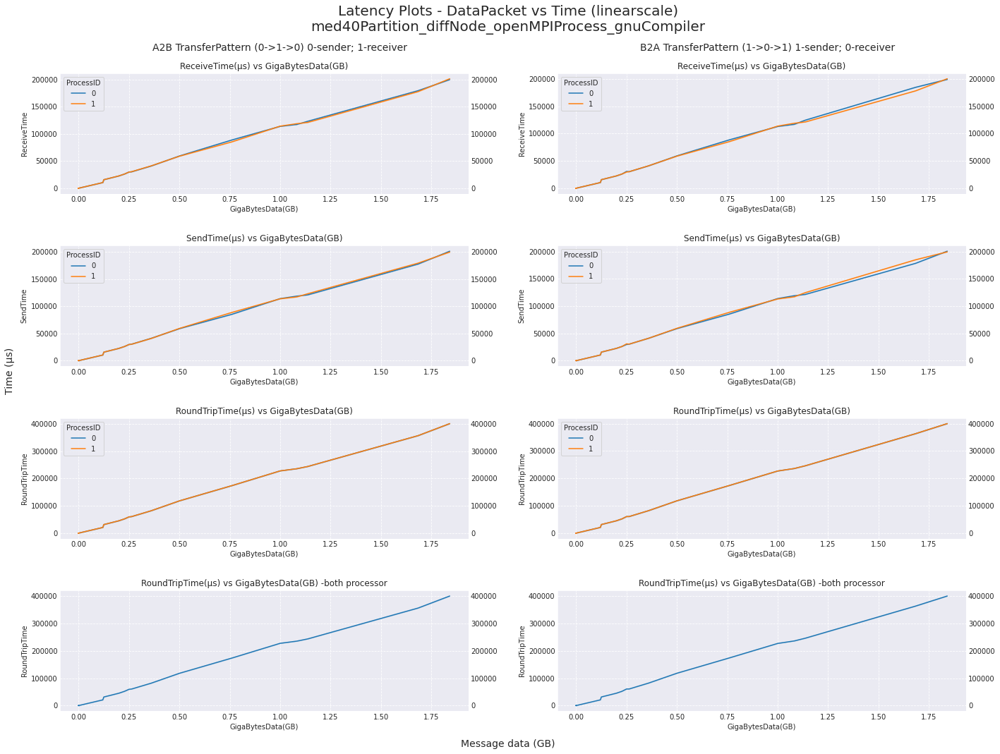

std96_diff_openMPI_gnu - separted:- std96 diff openMPI gnu


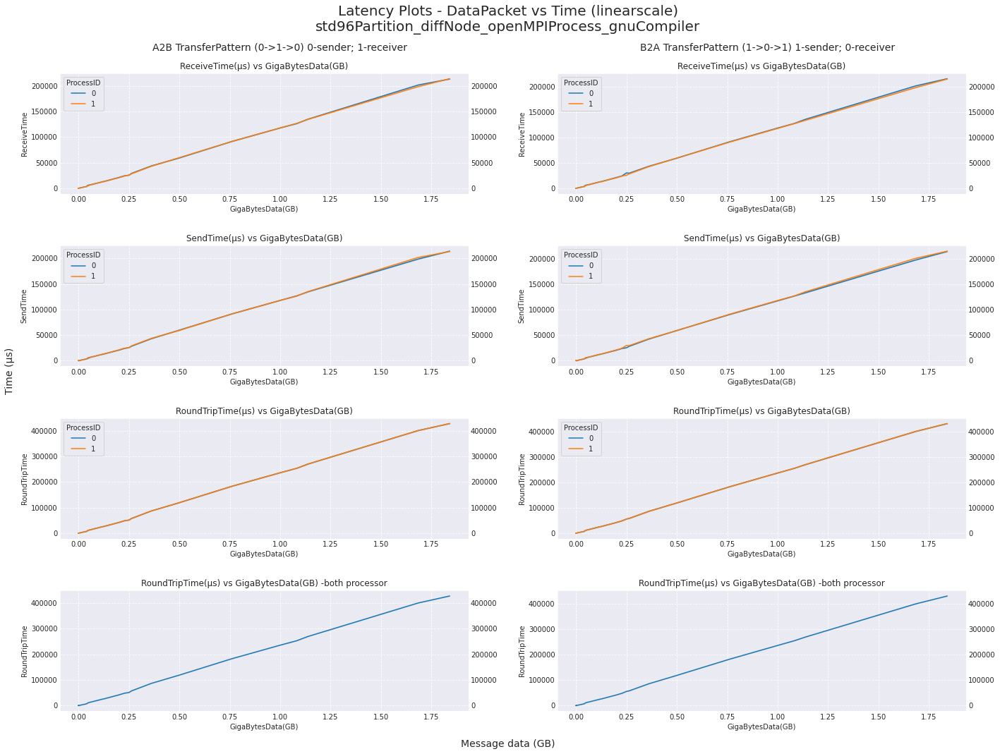

med40_same_intelMPI_intel - separted:- med40 same intelMPI intel


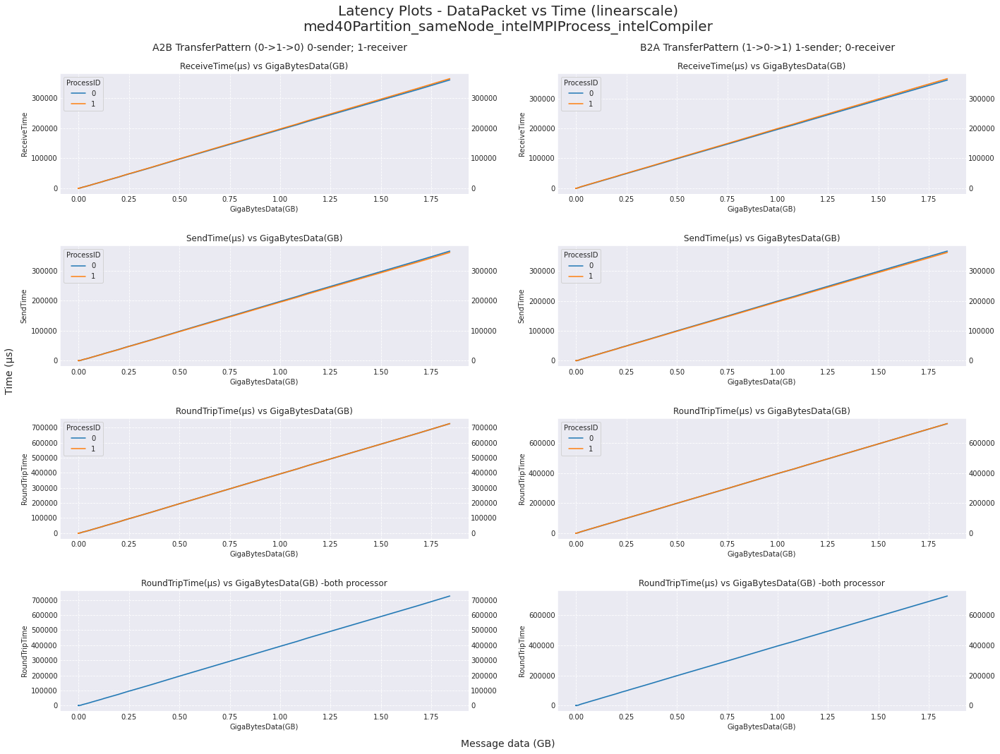

std96_same_intelMPI_intel - separted:- std96 same intelMPI intel


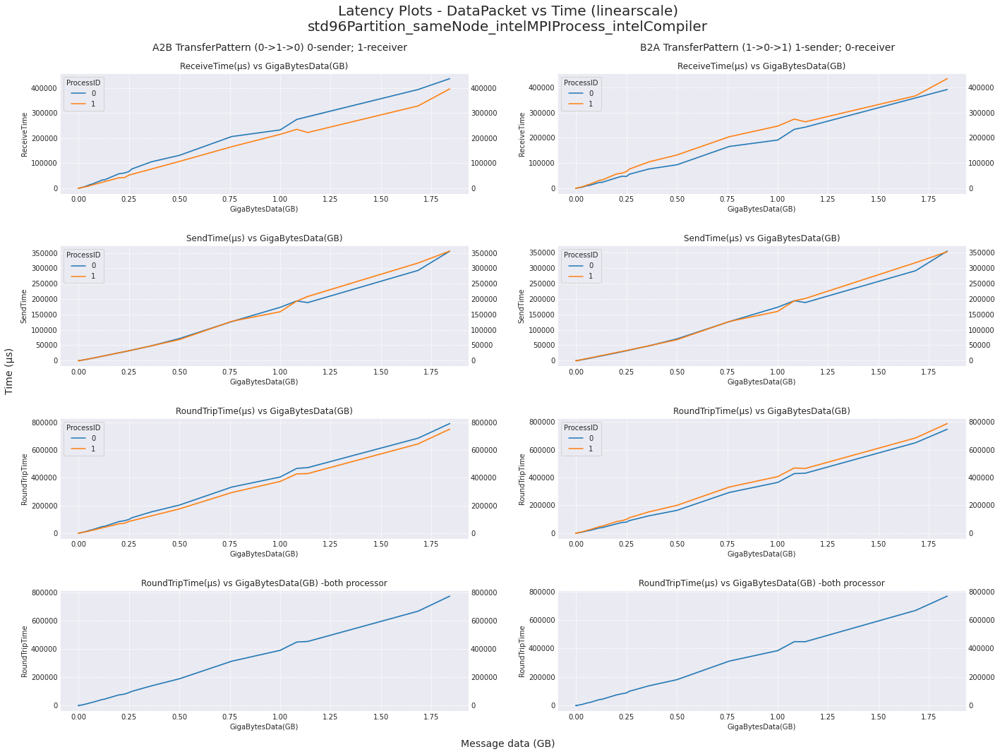

std96_diff_intelMPI_intel - separted:- std96 diff intelMPI intel


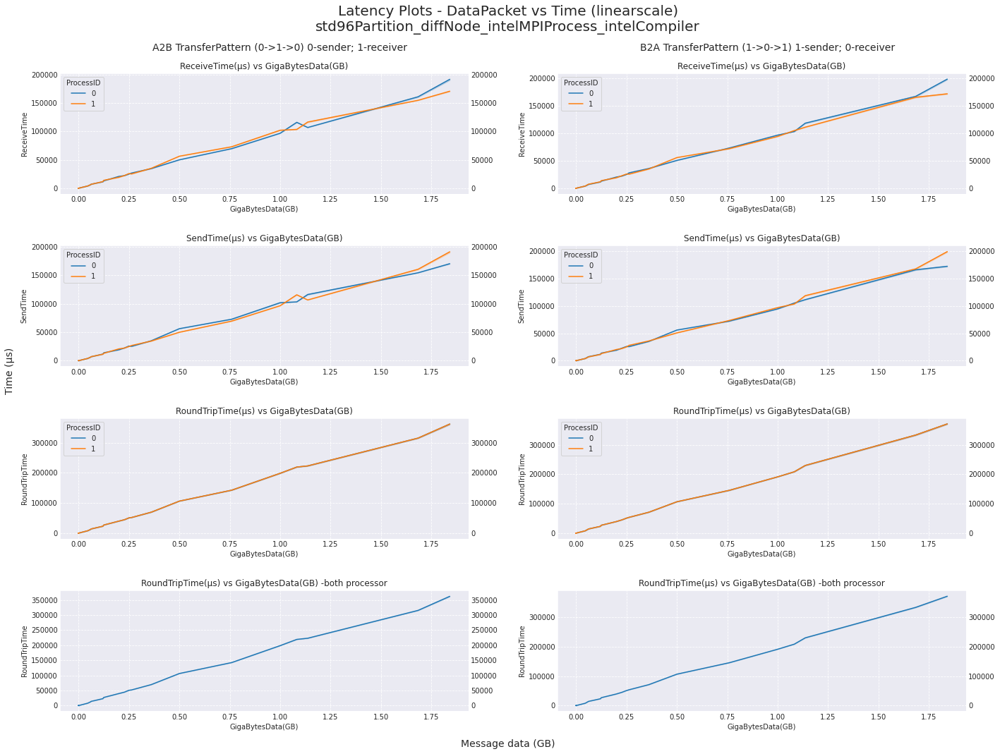

med40_diff_intelMPI_intel - separted:- med40 diff intelMPI intel


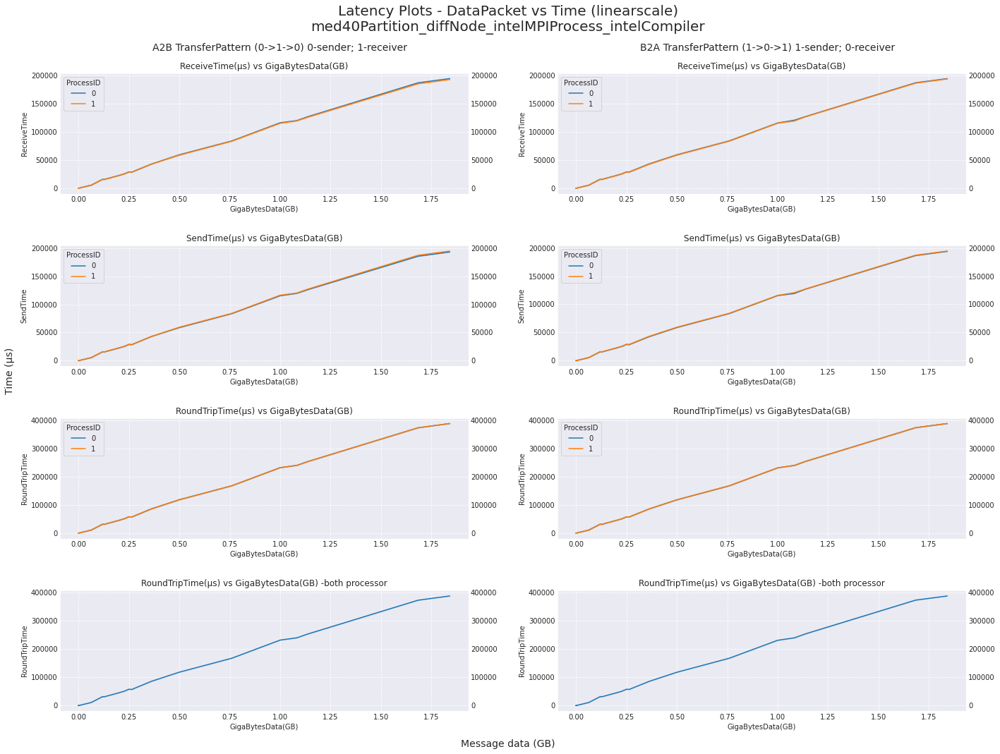

std96_same_intelMPI_gnu - separted:- std96 same intelMPI gnu


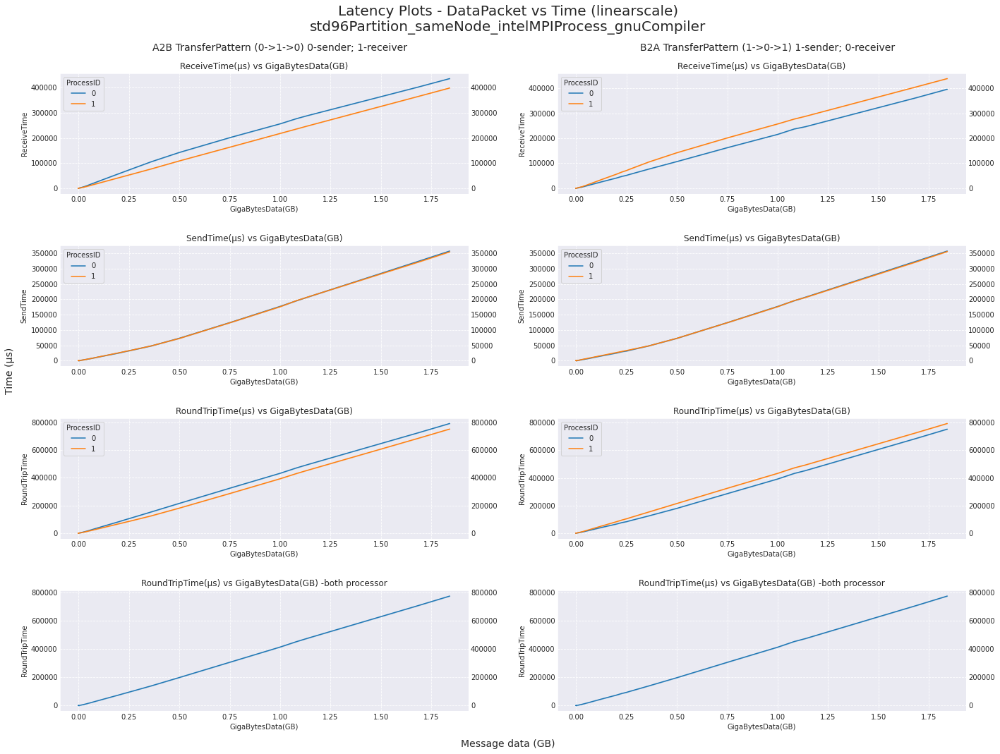

med40_same_intelMPI_gnu - separted:- med40 same intelMPI gnu


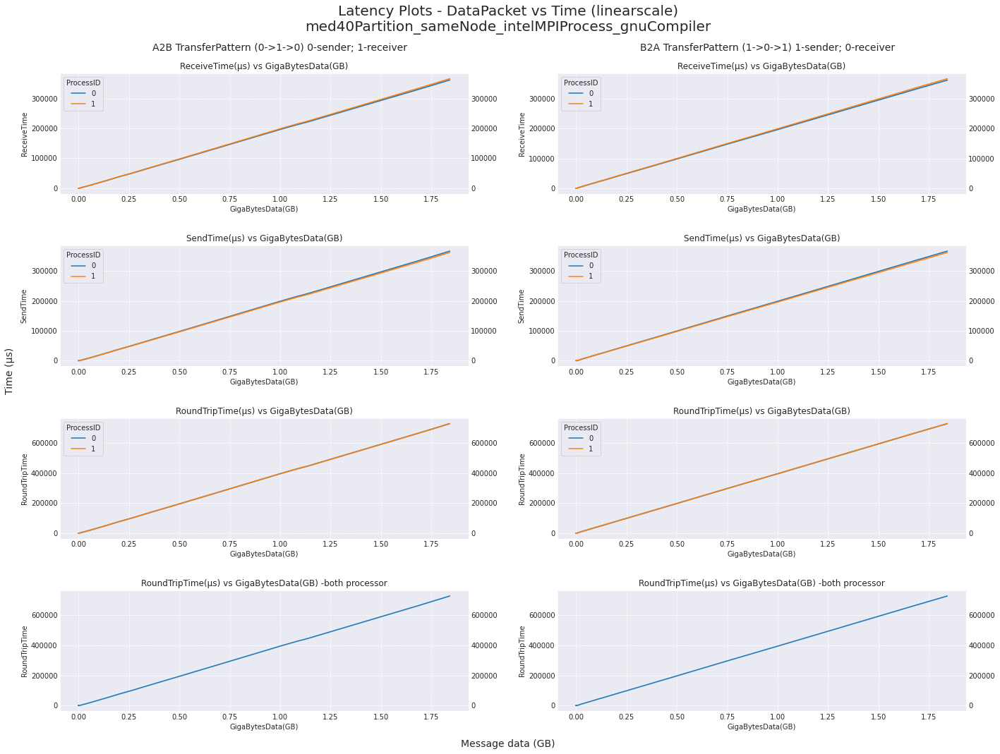

med40_diff_intelMPI_gnu - separted:- med40 diff intelMPI gnu


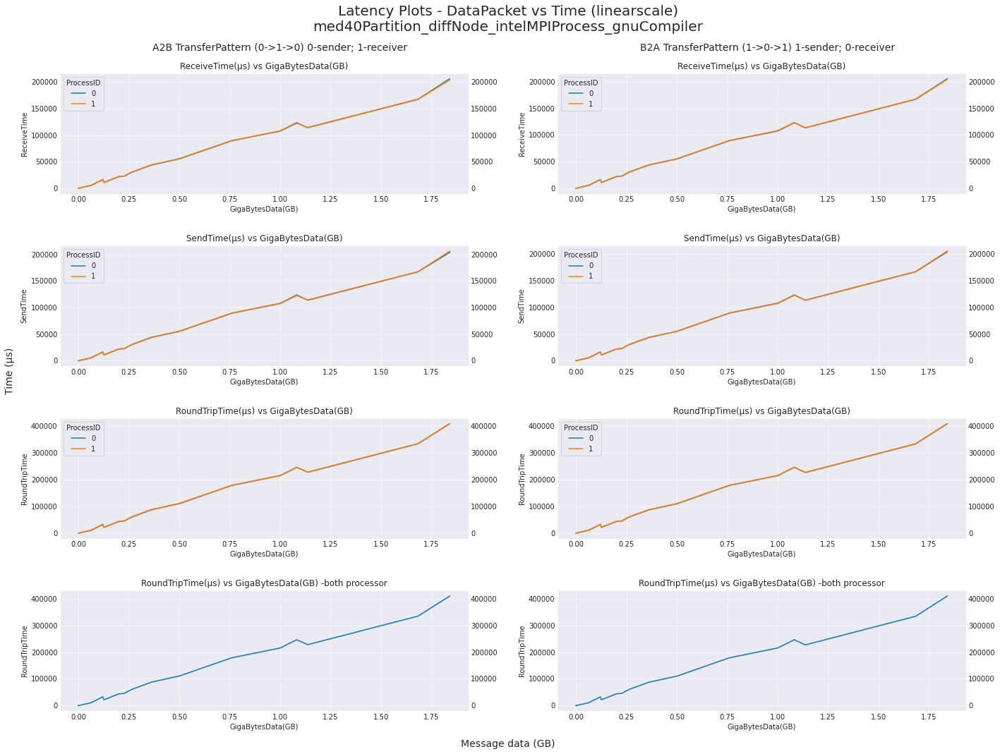

std96_diff_intelMPI_gnu - separted:- std96 diff intelMPI gnu


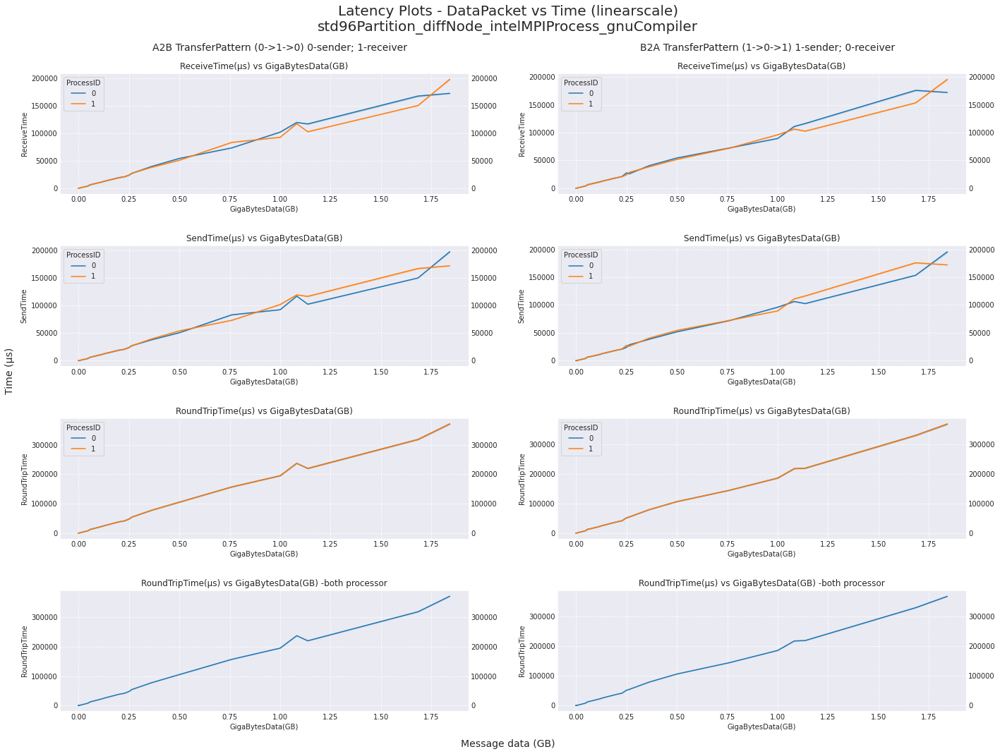

In [5]:
savePath = "/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results"
with open(f"{savePath}/pingPongDics.pickle", 'rb') as f:
    pingPongDfs = pickle.load(f)
    data_frames = pingPongDfs

xscale = yscale = 'linear'
timescale = 1e6

for i, (name, df) in enumerate(data_frames.items()):
    parts = re.sub(r"\"|\[|\]|\'", "", name).split("_")
    print(name, '- separted:-', f'{parts[0]}',f'{parts[1]}',f'{parts[2]}',f'{parts[3]}')
    LinePlot(df, parts, savePath, xscale, yscale, timescale)   
    # break

std96_same_openMPI_intel - separted:- std96 same openMPI intel


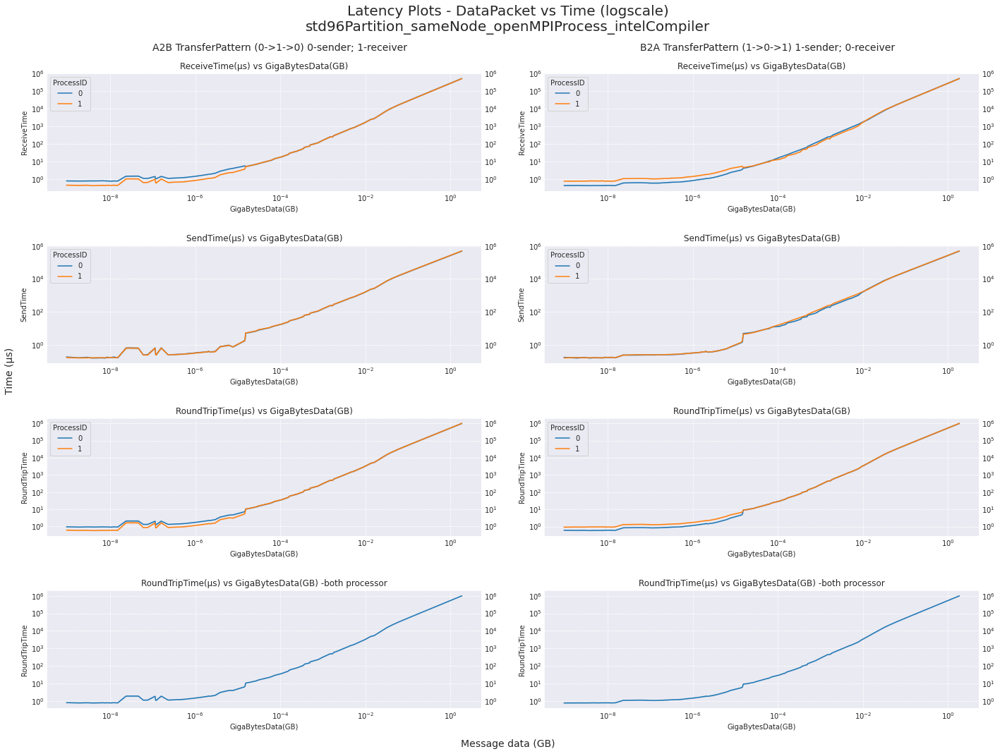

med40_same_openMPI_intel - separted:- med40 same openMPI intel


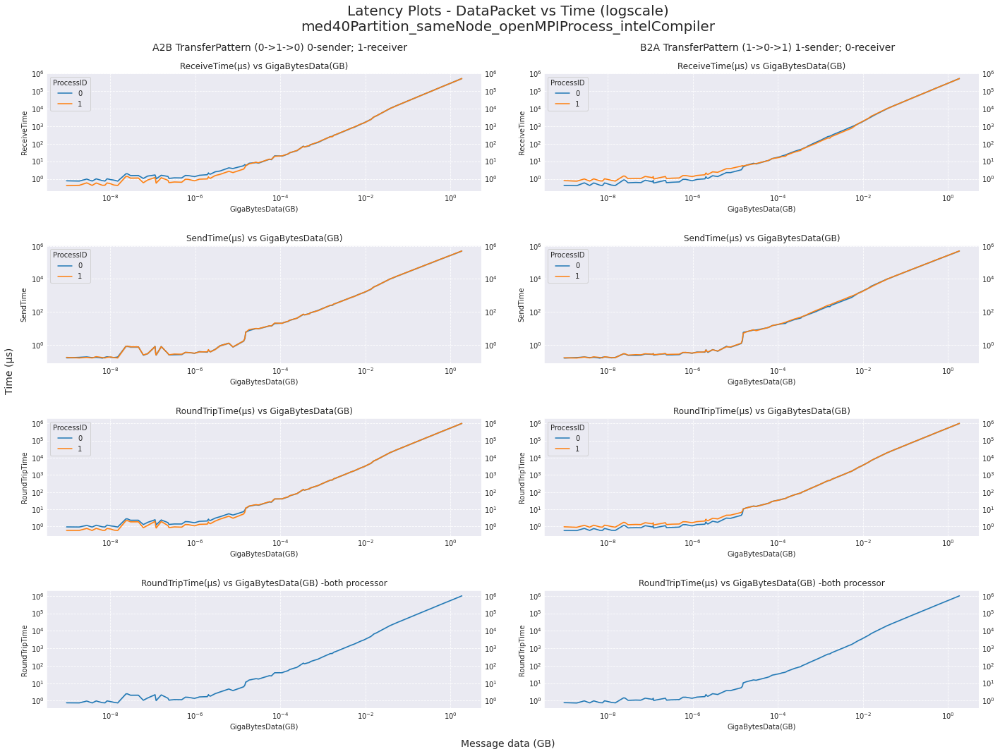

std96_diff_openMPI_intel - separted:- std96 diff openMPI intel


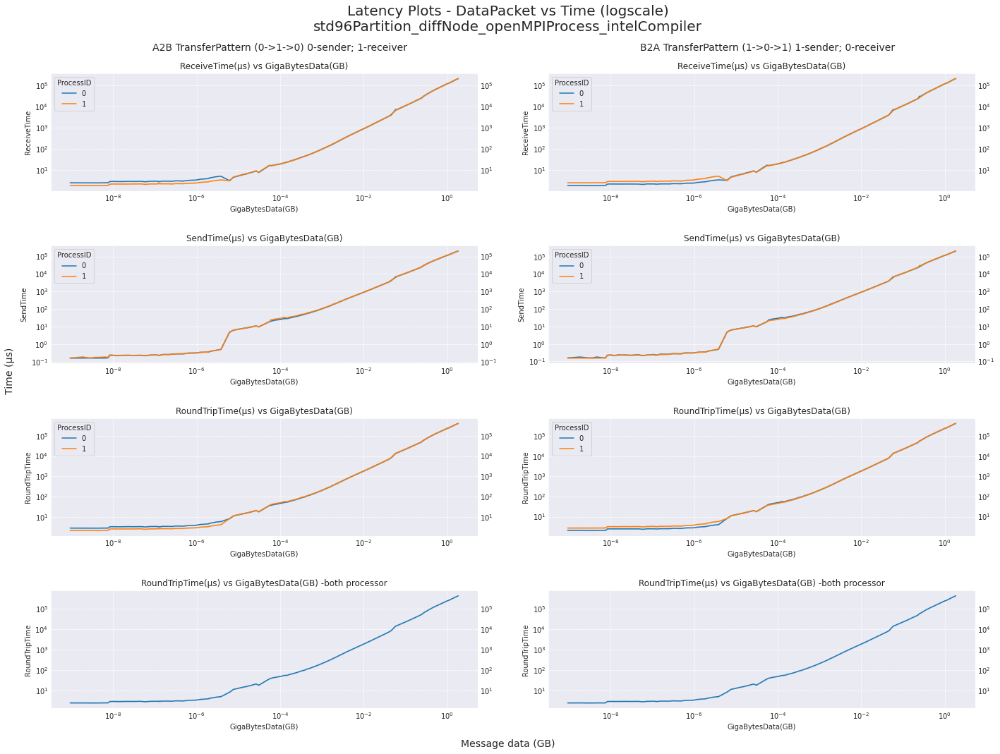

med40_diff_openMPI_intel - separted:- med40 diff openMPI intel


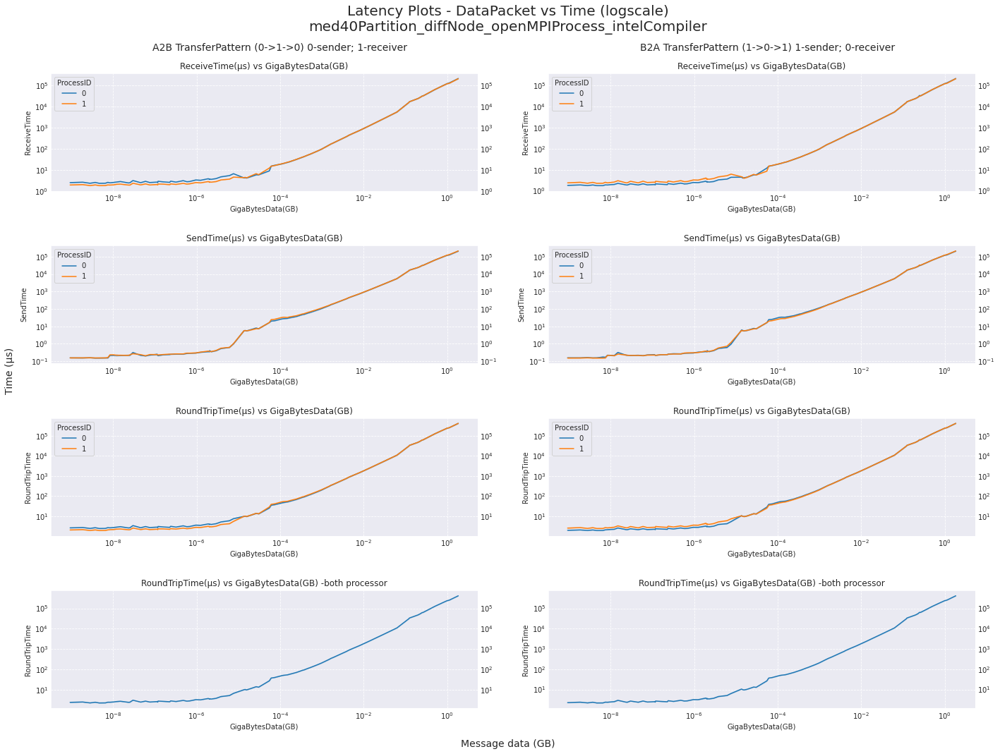

std96_same_openMPI_gnu - separted:- std96 same openMPI gnu


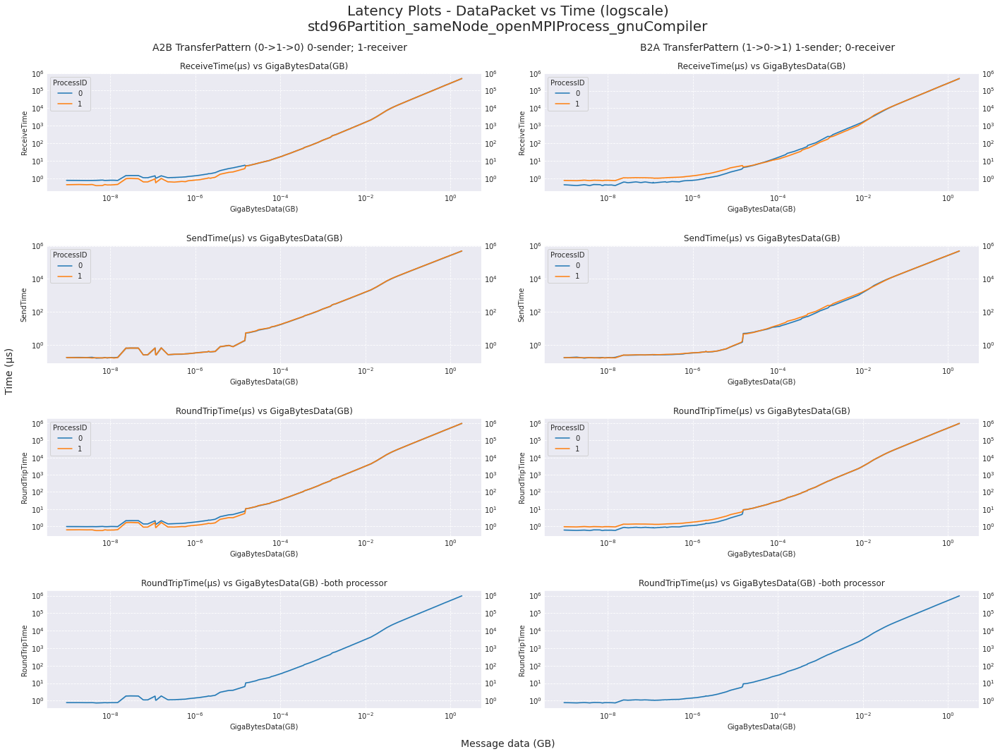

med40_same_openMPI_gnu - separted:- med40 same openMPI gnu


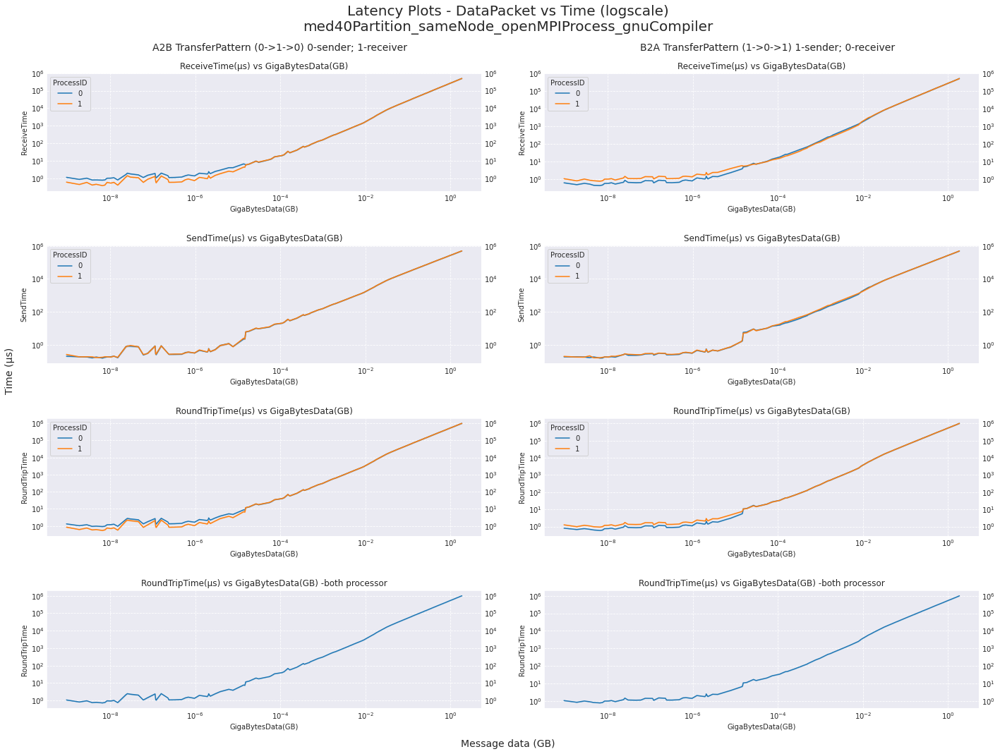

med40_diff_openMPI_gnu - separted:- med40 diff openMPI gnu


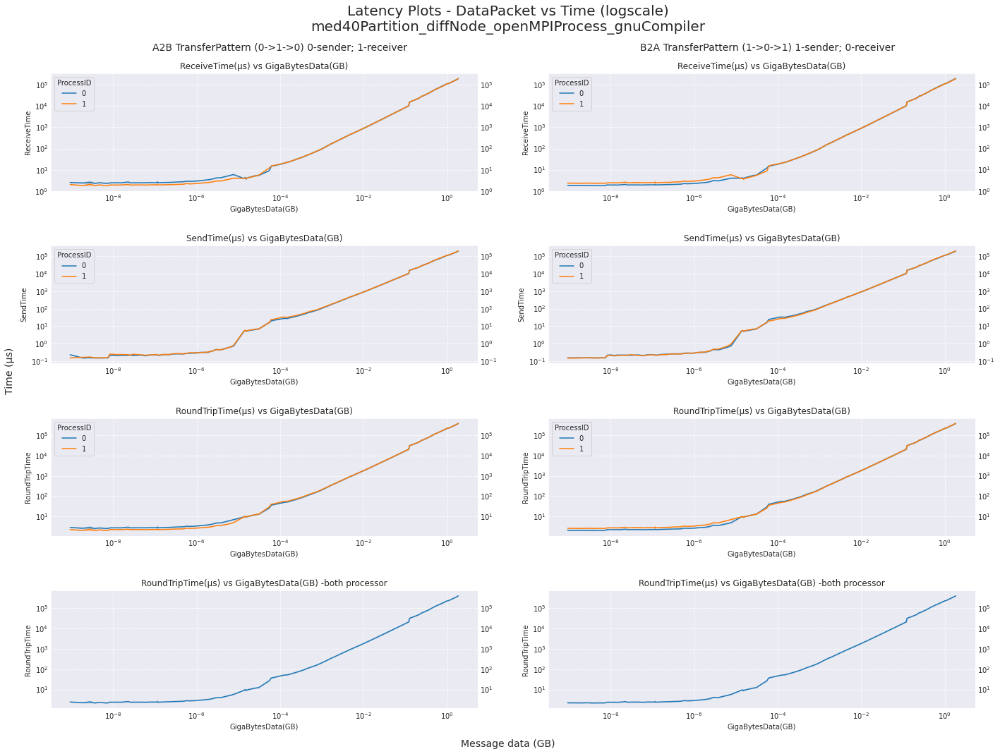

std96_diff_openMPI_gnu - separted:- std96 diff openMPI gnu


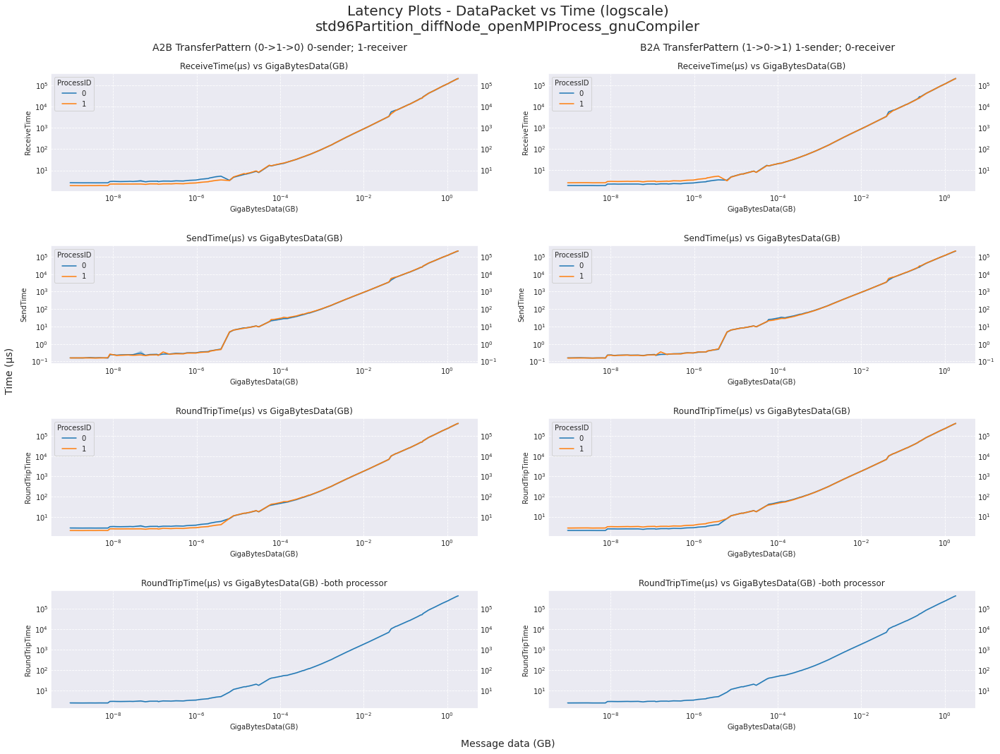

med40_same_intelMPI_intel - separted:- med40 same intelMPI intel


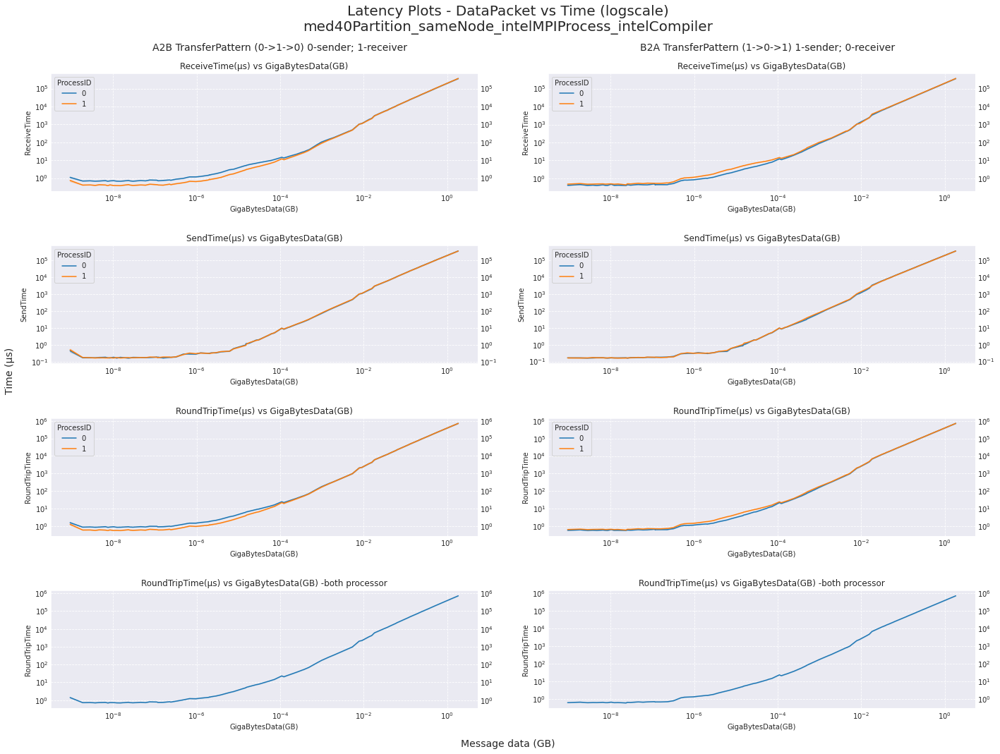

std96_same_intelMPI_intel - separted:- std96 same intelMPI intel


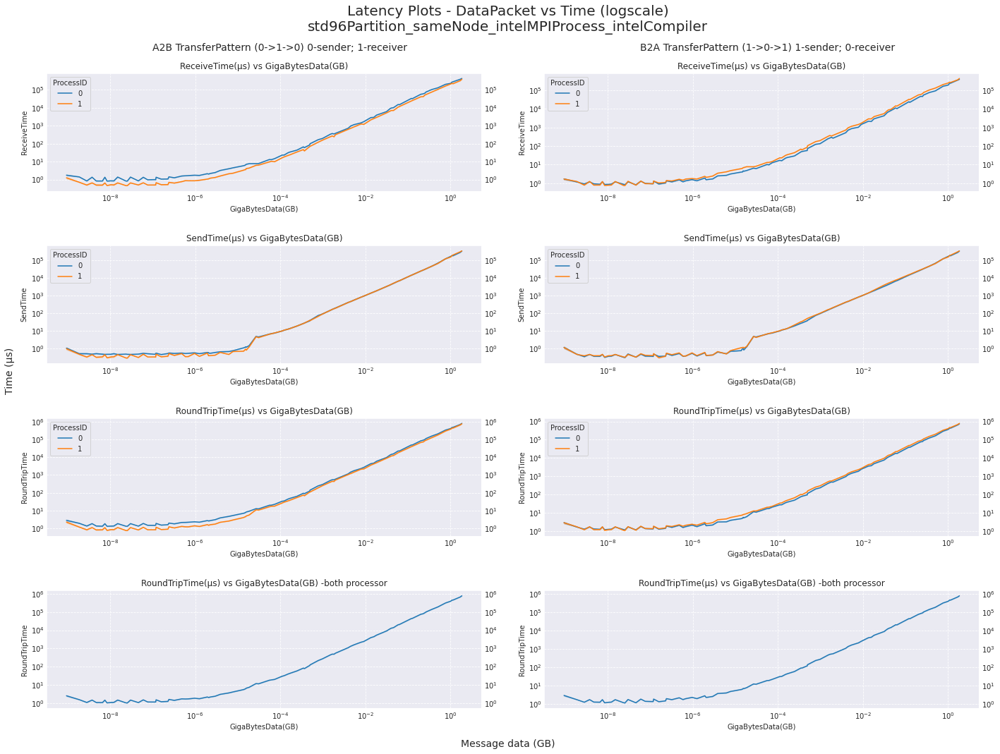

std96_diff_intelMPI_intel - separted:- std96 diff intelMPI intel


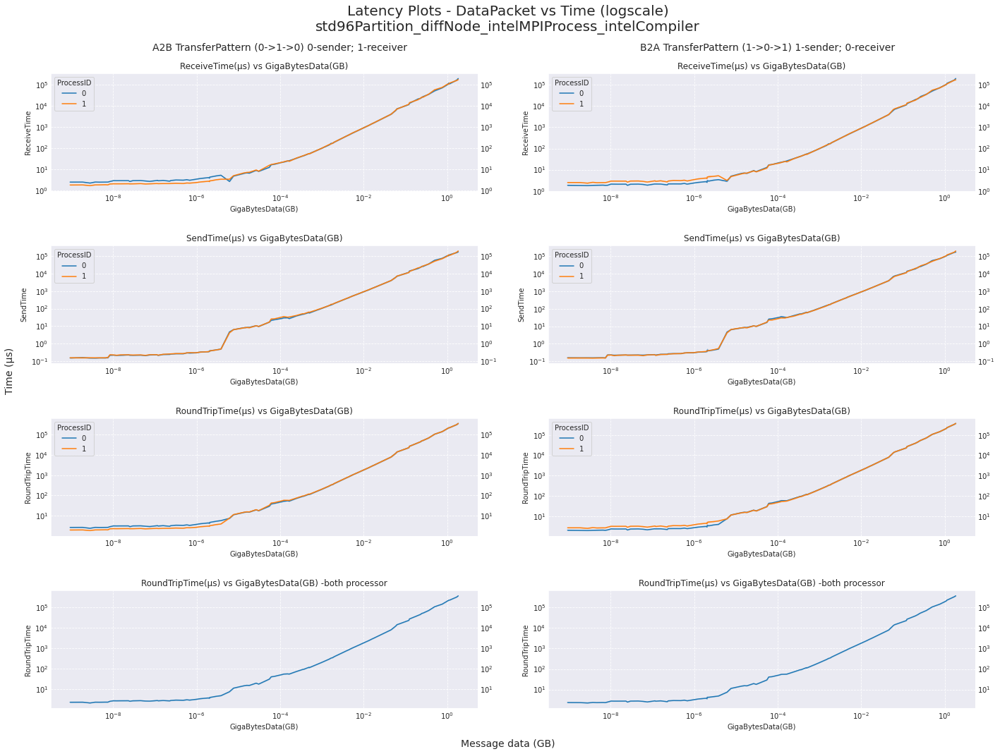

med40_diff_intelMPI_intel - separted:- med40 diff intelMPI intel


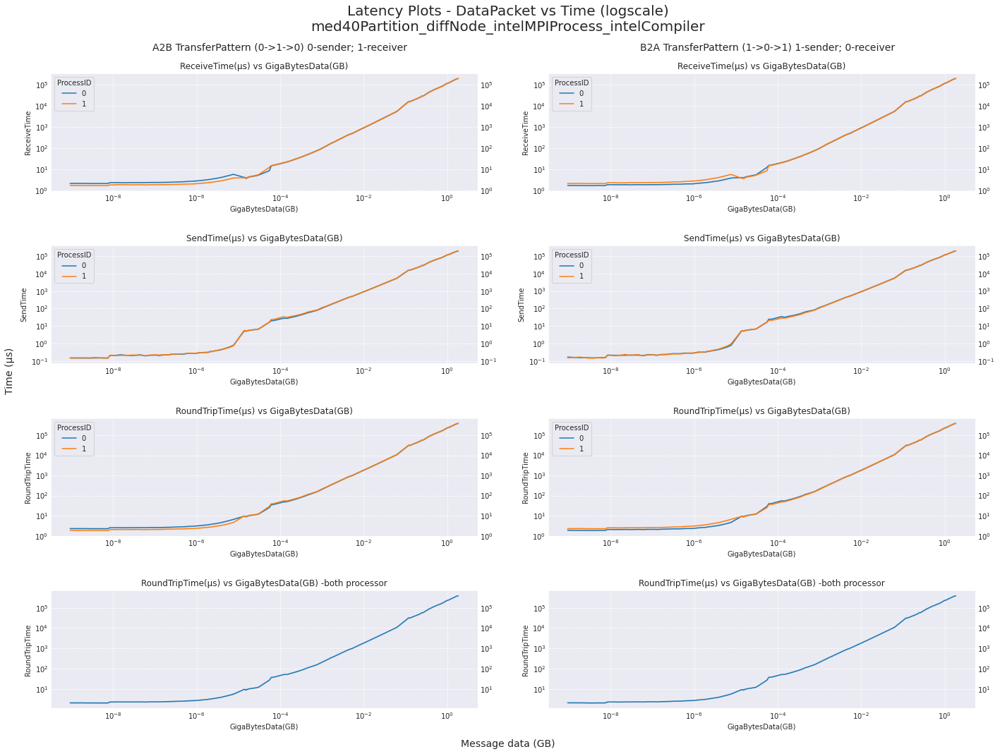

std96_same_intelMPI_gnu - separted:- std96 same intelMPI gnu


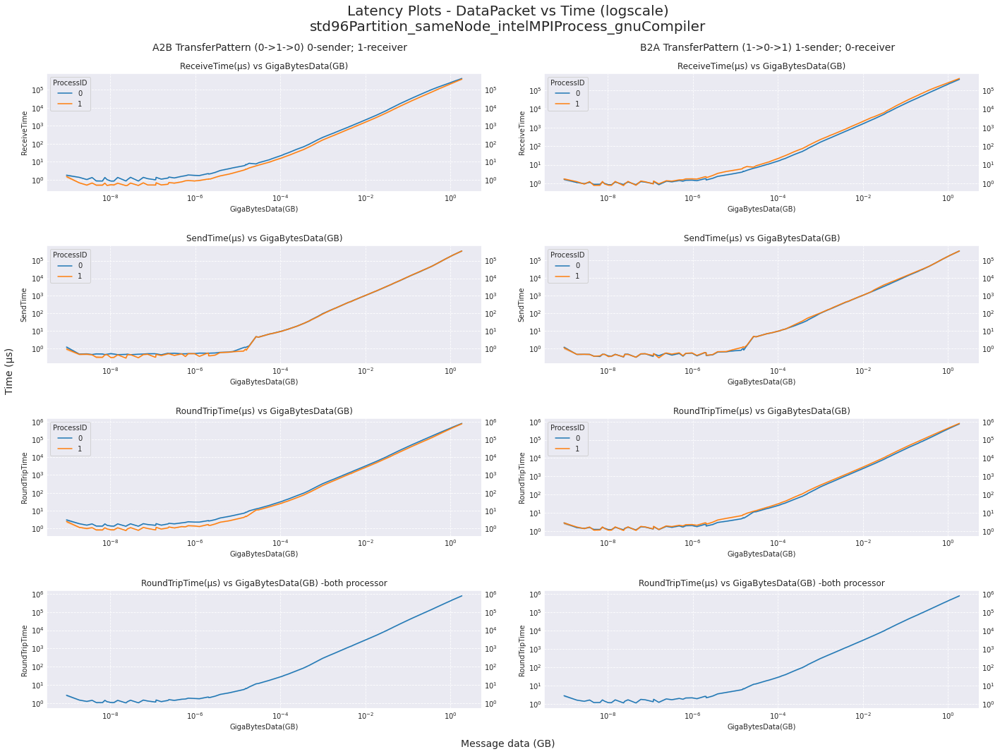

med40_same_intelMPI_gnu - separted:- med40 same intelMPI gnu


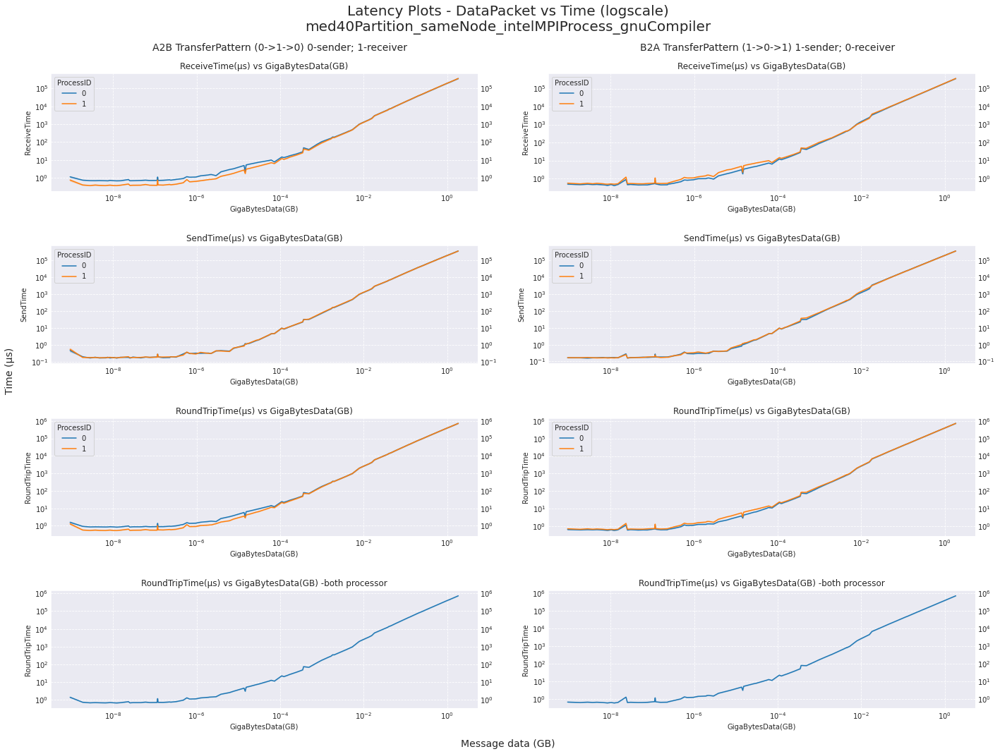

med40_diff_intelMPI_gnu - separted:- med40 diff intelMPI gnu


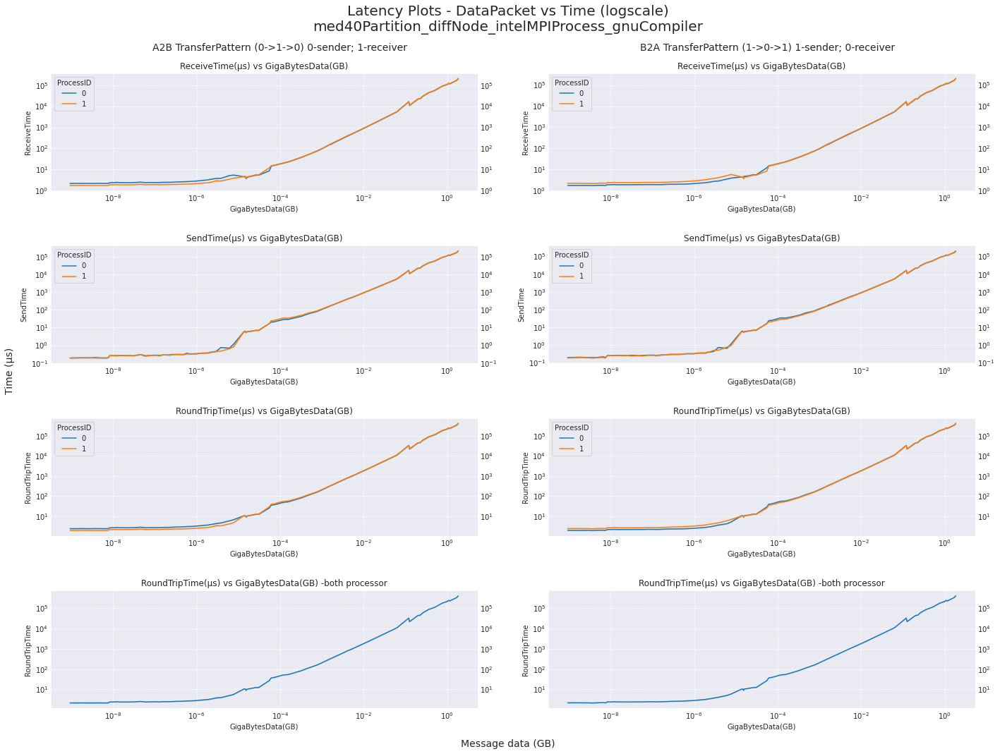

std96_diff_intelMPI_gnu - separted:- std96 diff intelMPI gnu


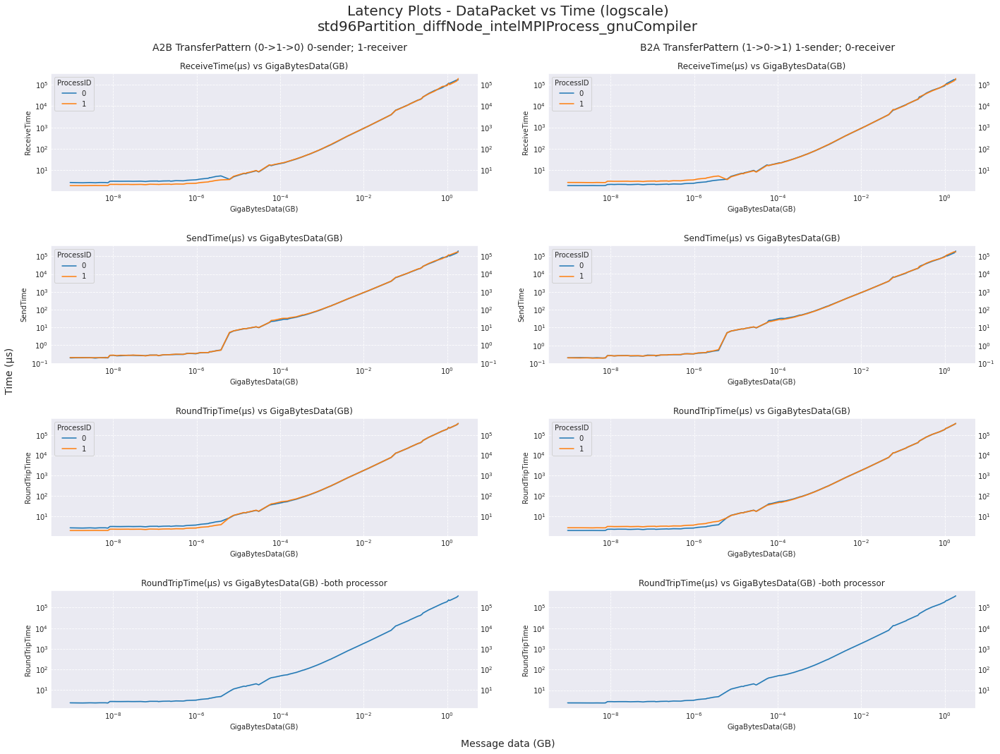

In [6]:
savePath = "/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results"
with open(f"{savePath}/pingPongDics.pickle", 'rb') as f:
    pingPongDfs = pickle.load(f)
    data_frames = pingPongDfs
    
xscale = yscale = 'log'
timescale = 1e6

for i, (name, df) in enumerate(data_frames.items()):

    parts = re.sub(r"\"|\[|\]|\'", "", name).split("_")
    print(name, '- separted:-', f'{parts[0]}',f'{parts[1]}',f'{parts[2]}',f'{parts[3]}')
    LinePlot(df, parts, savePath, xscale, yscale, timescale)  

## Bandwidth vs packet size
#### Data Transfer rate
plotting data/time vs Data (Gb/sec vs gb)

In [11]:
def trasnferRateLinePlots(data, parts, savePath, xscale, yscale):

    data_h = data.groupby("TransferPattern")
    time_list = ['Receive', 'Send', 'RoundTrip']
    _dtype = 'GigaBytesData(GB)'#'BytesData(B)'#'GigaBytesData(GB)'
    _hue = 'ProcessID'

    partition, nodeInfoText, process, compiler = f'{parts[0]}',f'{parts[1]}',f'{parts[2]}',f'{parts[3]}'
    plotName = f"TransferRatePlots_{yscale}Scale_{partition}Partition_{nodeInfoText}Node_{process}Process_{compiler}Compiler"

    fig, axes = plt.subplots(4,2, figsize=(20, 15), sharex = False, sharey = False)
    fig.suptitle(f'BandWidth Plots - DataPacket vs Time ({xscale}scale)\n{partition}Partition_{nodeInfoText}Node_{process}Process_{compiler}Compiler', fontsize = 20)

    for i, (name, d) in enumerate(data_h):
        if name == 'A2B': name = 'A2B TransferPattern (0->1->0) 0-sender; 1-receiver'
        elif name == 'B2A': name = 'B2A TransferPattern (1->0->1) 1-sender; 0-receiver'
        sns.set_style("darkgrid", {'grid.linestyle': '--'}) 

        for j, time in enumerate(time_list):
            _time = f'{time}'+'Time'
            y_value = d[_dtype] / d[_time]
            x_value = d[_dtype]
            sns.lineplot(data = d, x = x_value, y = y_value, hue = _hue, estimator = 'mean',
                         ax = axes[j][i] ).set_title(f'{time} Data Transfer rate (GB/Sec) vs {_dtype}') 
        sns.lineplot(data = d, x = x_value, y = x_value / data['RoundTripTime'], 
                     ax = axes[j+1][i]).set_title(f'{time} Data Transfer rate (GB/Sec) vs {_dtype} -both processor')
        fig.text(0.15 * (3.2 * i + 1), 0.92, f'{name}', fontsize = 14)

    for i, ax in enumerate(axes.flatten()):
        ax.grid(True)
        ax.set_yscale(xscale)
        ax.set_xscale(yscale)
        ax.tick_params(axis = 'both', direction = 'in', labelleft = True, labelright = True)

    fig.tight_layout(pad=3.0)
    fig.text(0.01, 0.5, 'DataTransferRate (GB/Sec)', va = 'center', ha = 'center', rotation = 'vertical', fontsize = 14)
    fig.text(0.5, 0.01, 'Message data transfered(GB)', va = 'center', ha = 'center',  fontsize = 14)
    plt.savefig(f"{savePath}/{plotName}.png")
    return 



std96_same_openMPI_intel - separted:- std96 same openMPI intel
med40_same_openMPI_intel - separted:- med40 same openMPI intel
std96_diff_openMPI_intel - separted:- std96 diff openMPI intel
med40_diff_openMPI_intel - separted:- med40 diff openMPI intel
std96_same_openMPI_gnu - separted:- std96 same openMPI gnu
med40_same_openMPI_gnu - separted:- med40 same openMPI gnu
med40_diff_openMPI_gnu - separted:- med40 diff openMPI gnu
std96_diff_openMPI_gnu - separted:- std96 diff openMPI gnu
med40_same_intelMPI_intel - separted:- med40 same intelMPI intel
std96_same_intelMPI_intel - separted:- std96 same intelMPI intel
std96_diff_intelMPI_intel - separted:- std96 diff intelMPI intel
med40_diff_intelMPI_intel - separted:- med40 diff intelMPI intel
std96_same_intelMPI_gnu - separted:- std96 same intelMPI gnu
med40_same_intelMPI_gnu - separted:- med40 same intelMPI gnu
med40_diff_intelMPI_gnu - separted:- med40 diff intelMPI gnu
std96_diff_intelMPI_gnu - separted:- std96 diff intelMPI gnu


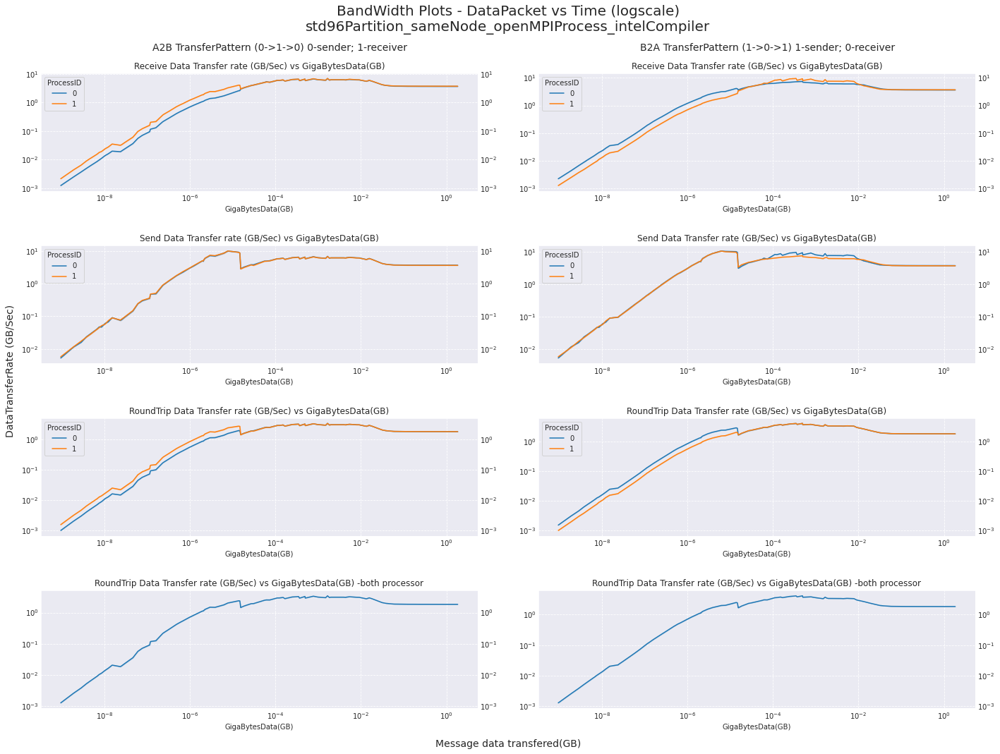

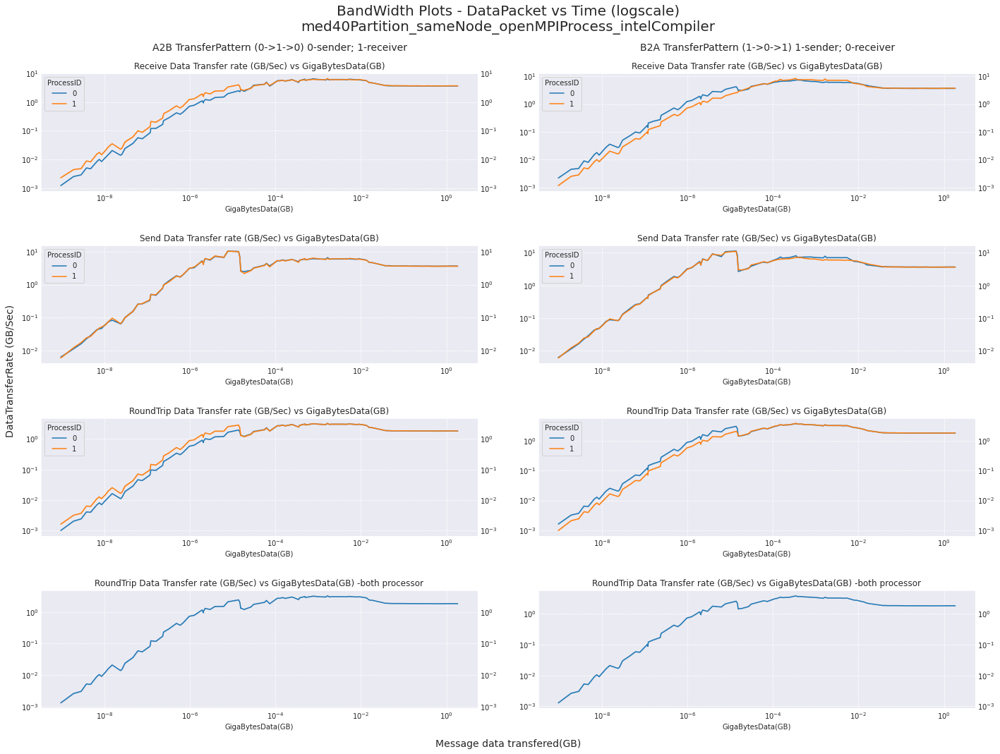

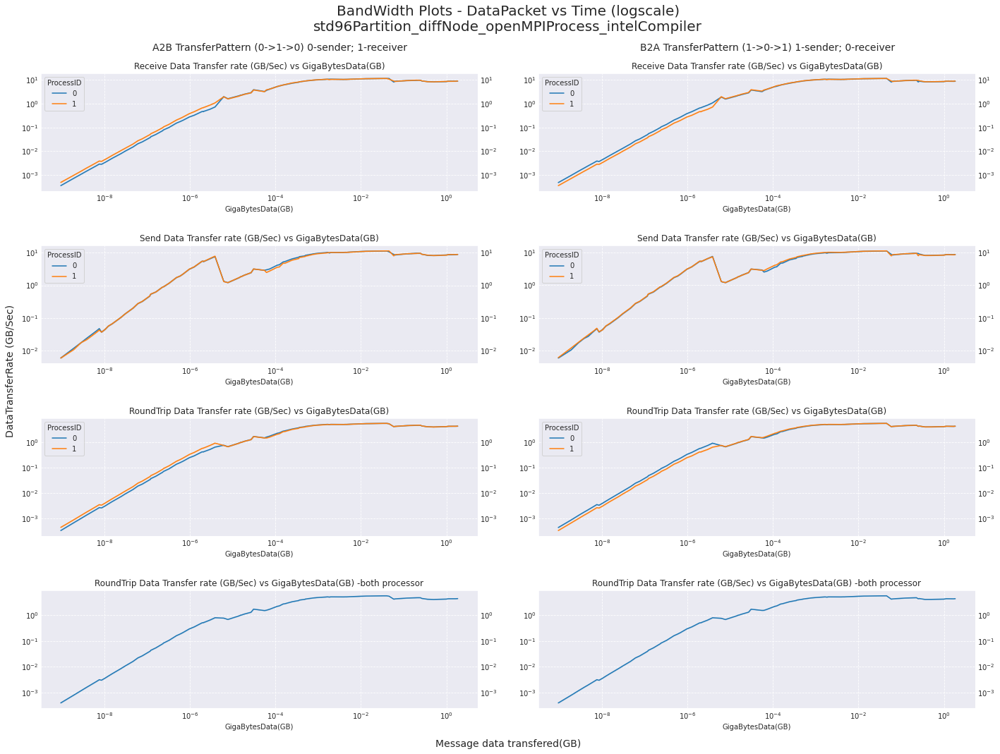

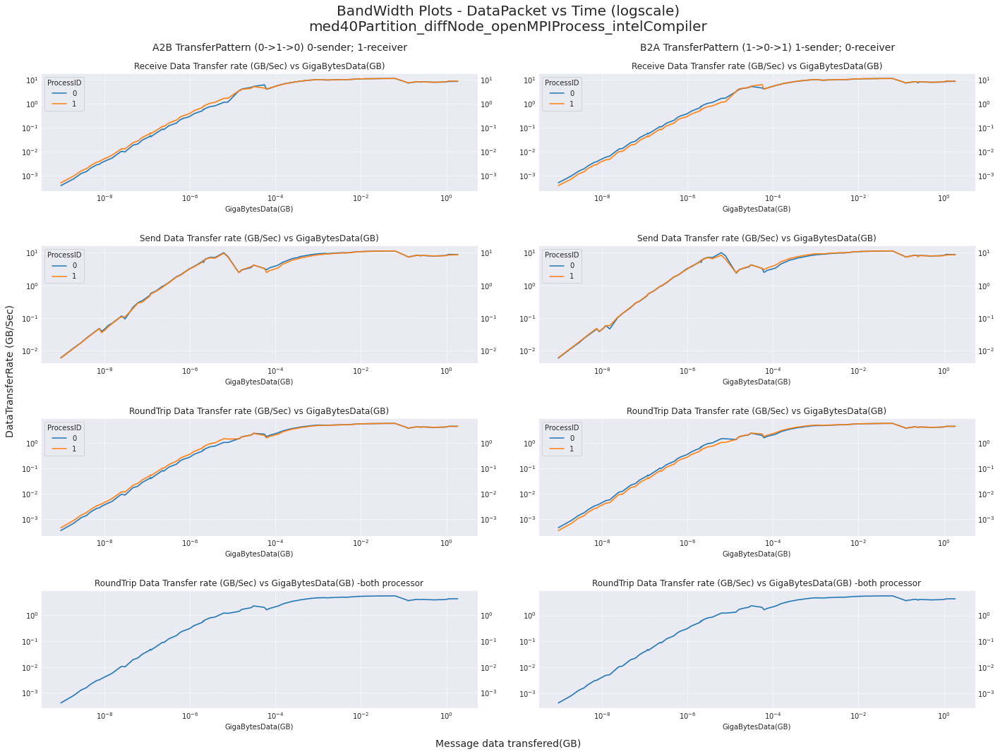

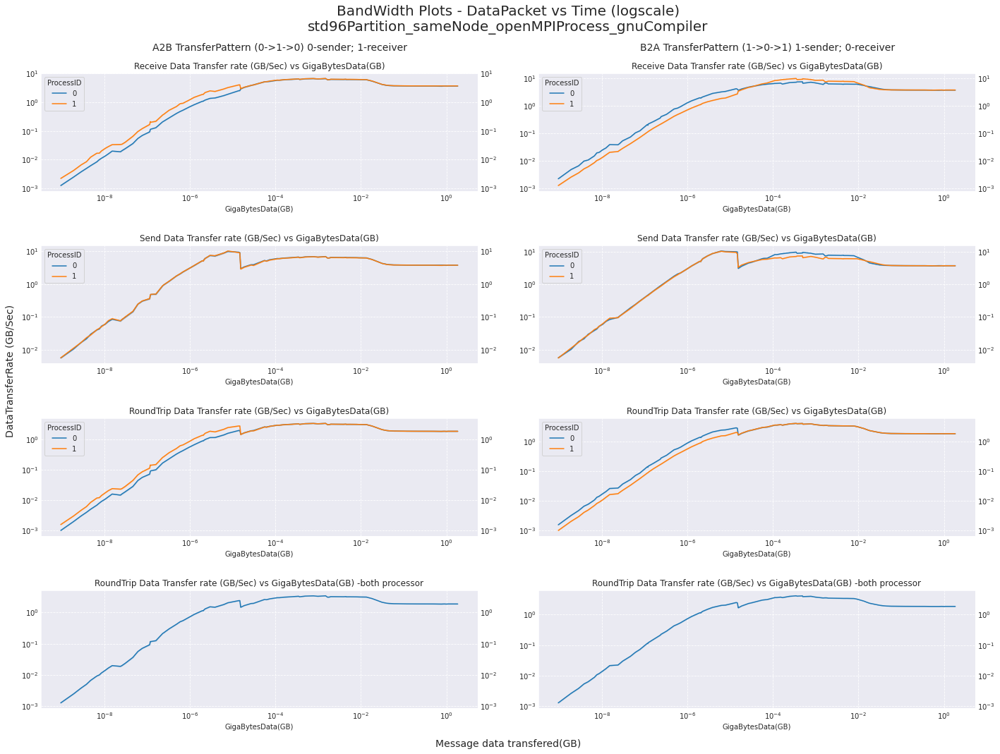

...

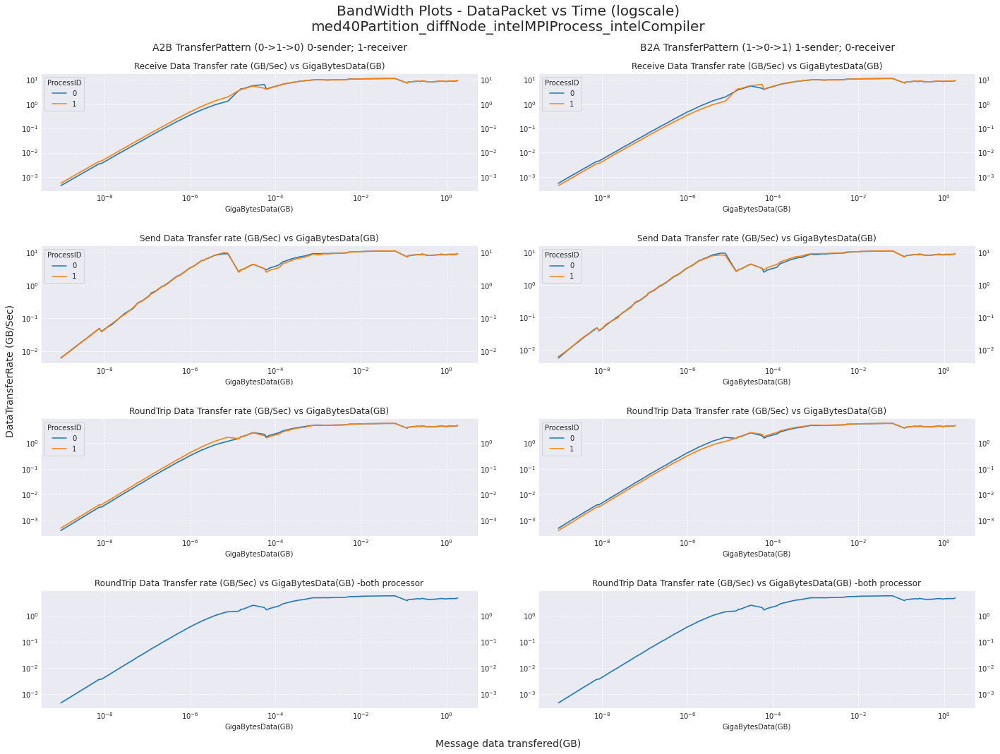

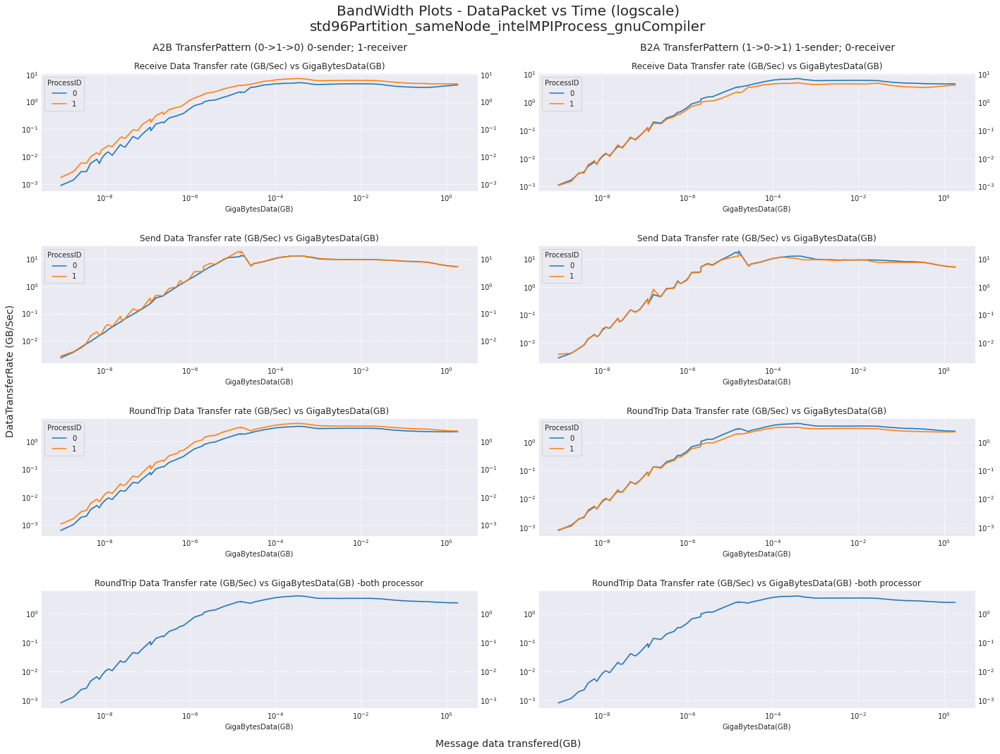

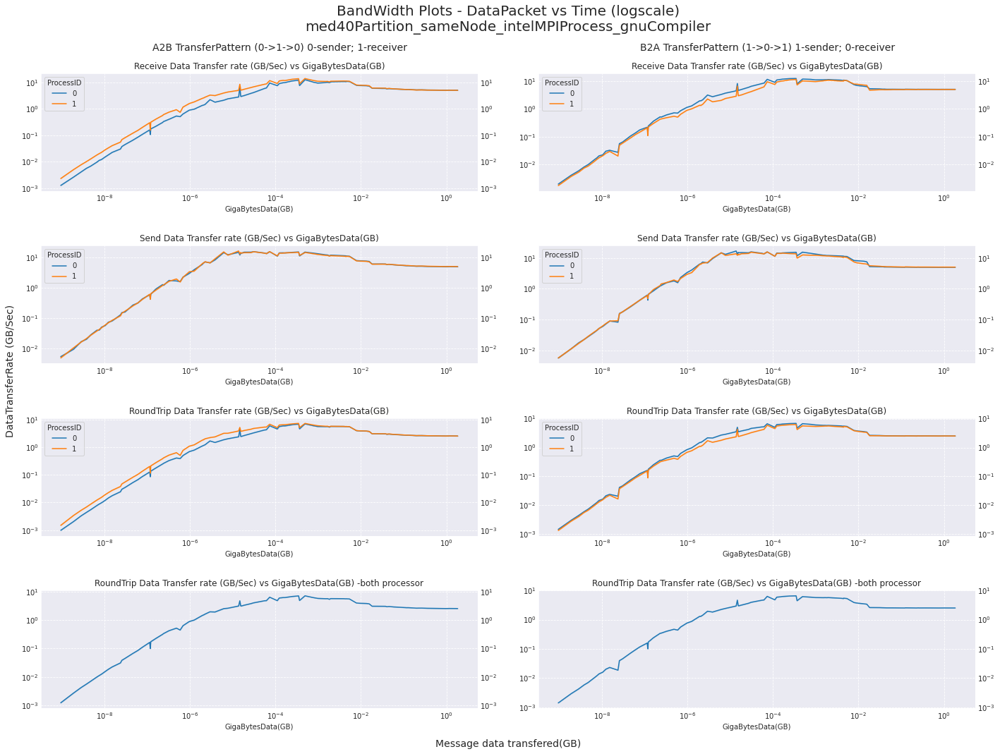

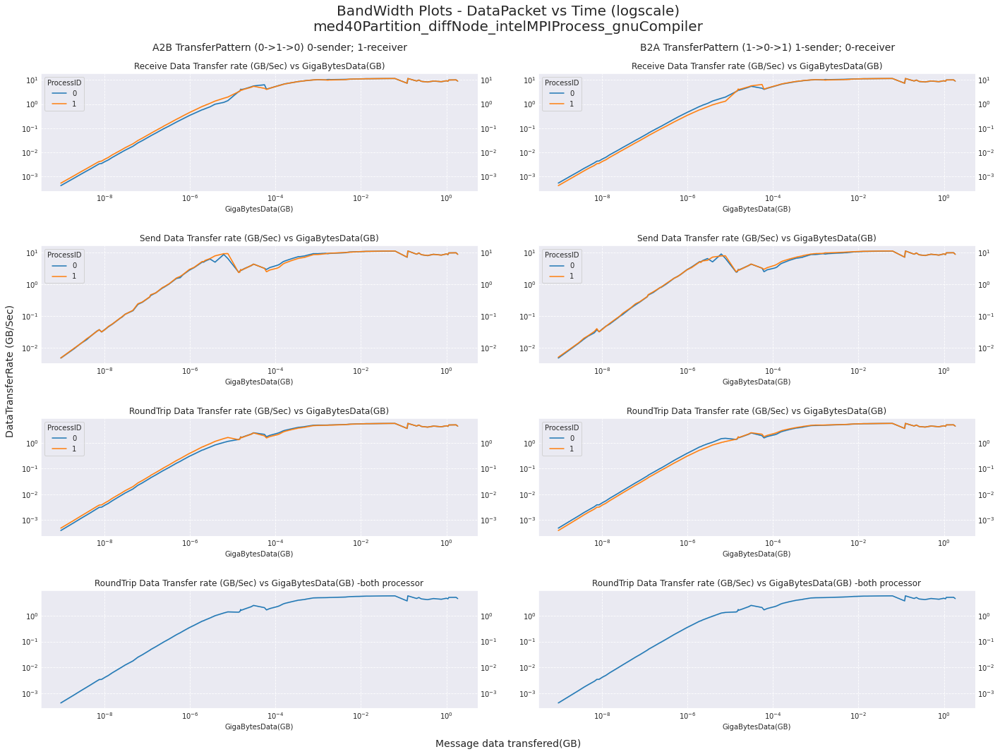

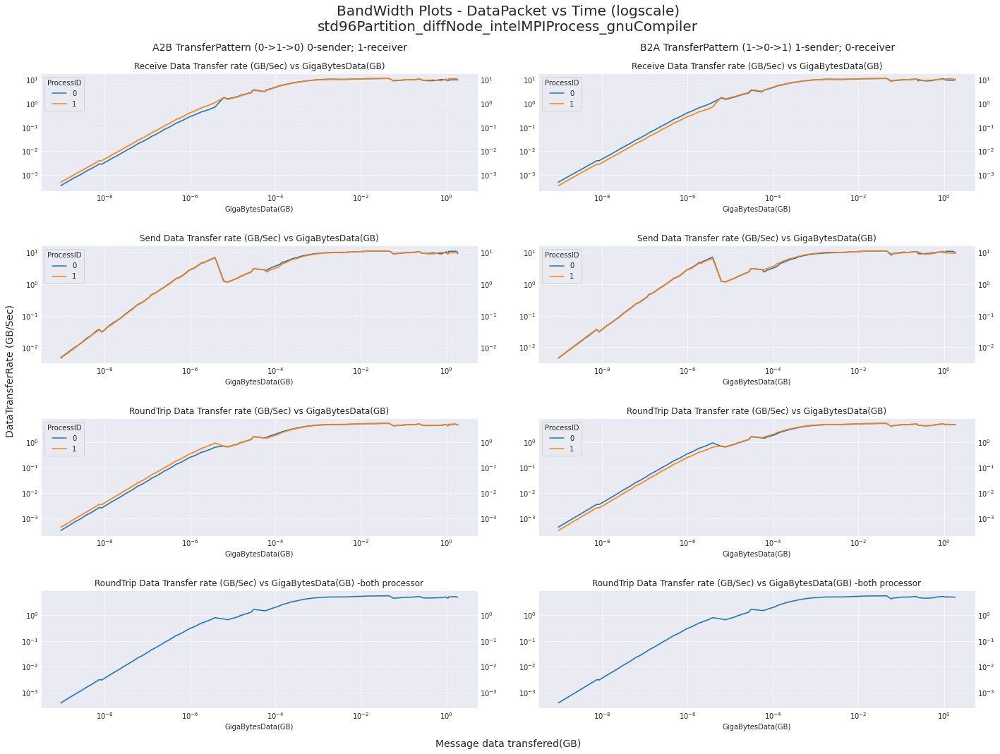

In [10]:
## log scale plots for all setups
savePath = "/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results"
with open(f"{savePath}/pingPongDics.pickle", 'rb') as f:
    pingPongDfs = pickle.load(f)
    data_frames = pingPongDfs

xscale = yscale = 'log'

for i, (name, df) in enumerate(data_frames.items()):
    parts = re.sub(r"\"|\[|\]|\'", "", name).split("_")
    print(name, '- separted:-', f'{parts[0]}',f'{parts[1]}',f'{parts[2]}',f'{parts[3]}')
    trasnferRateLinePlots(df, parts, savePath, xscale, yscale)    
    # break



std96_same_openMPI_intel - separted:- std96 same openMPI intel
med40_same_openMPI_intel - separted:- med40 same openMPI intel
std96_diff_openMPI_intel - separted:- std96 diff openMPI intel
med40_diff_openMPI_intel - separted:- med40 diff openMPI intel
std96_same_openMPI_gnu - separted:- std96 same openMPI gnu
med40_same_openMPI_gnu - separted:- med40 same openMPI gnu
med40_diff_openMPI_gnu - separted:- med40 diff openMPI gnu
std96_diff_openMPI_gnu - separted:- std96 diff openMPI gnu
med40_same_intelMPI_intel - separted:- med40 same intelMPI intel
std96_same_intelMPI_intel - separted:- std96 same intelMPI intel
std96_diff_intelMPI_intel - separted:- std96 diff intelMPI intel
med40_diff_intelMPI_intel - separted:- med40 diff intelMPI intel
std96_same_intelMPI_gnu - separted:- std96 same intelMPI gnu
med40_same_intelMPI_gnu - separted:- med40 same intelMPI gnu
med40_diff_intelMPI_gnu - separted:- med40 diff intelMPI gnu
std96_diff_intelMPI_gnu - separted:- std96 diff intelMPI gnu


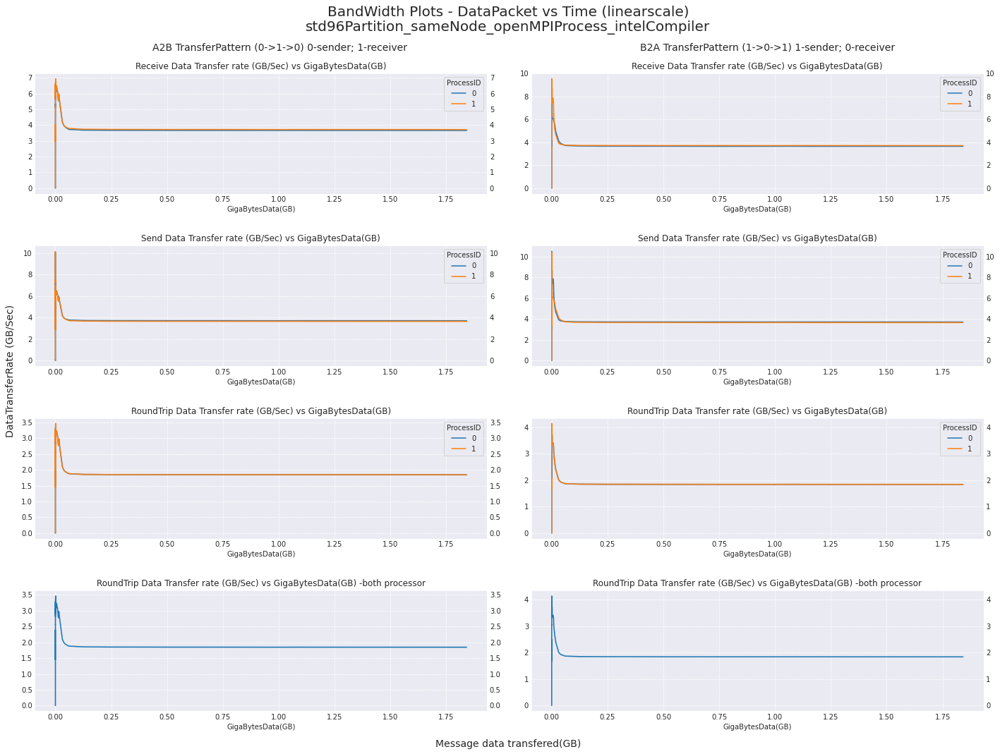

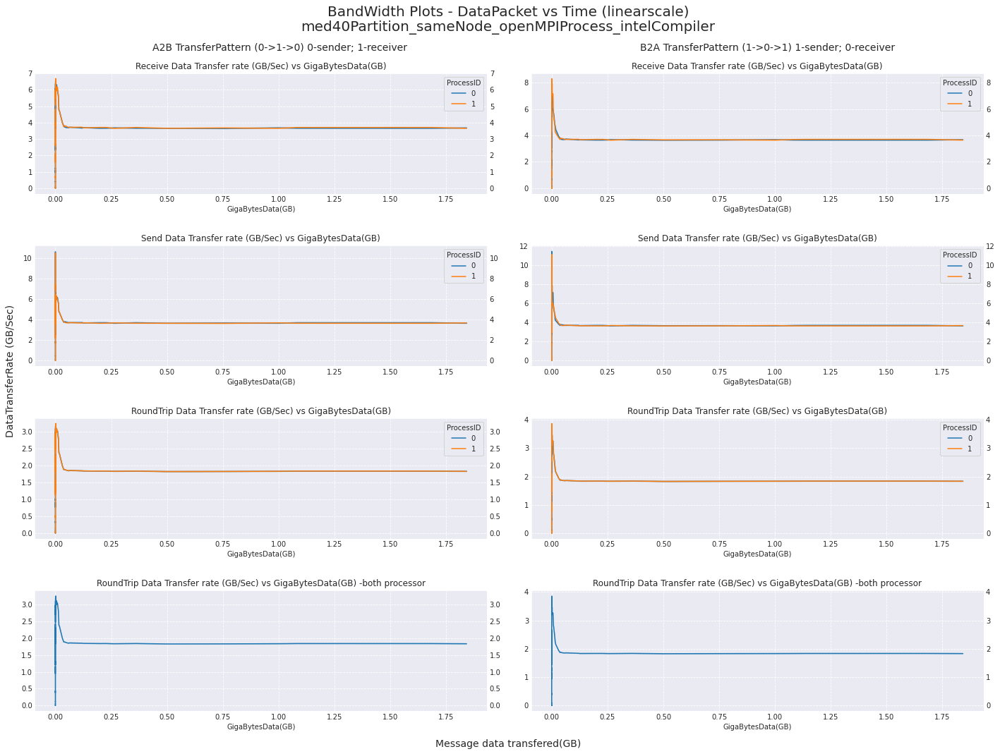

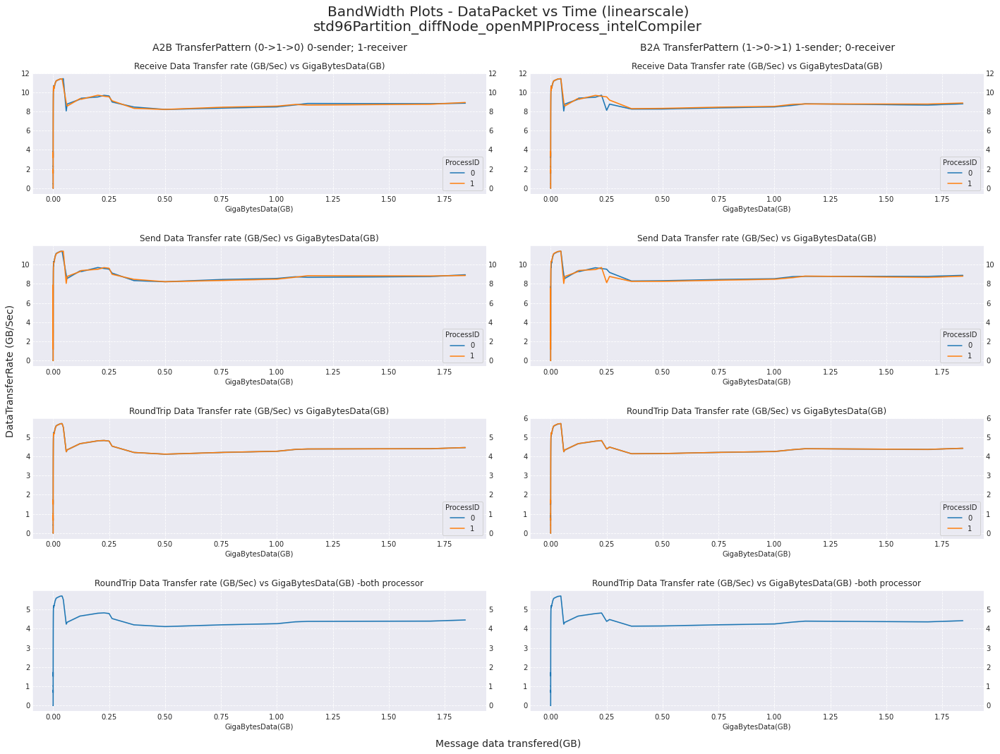

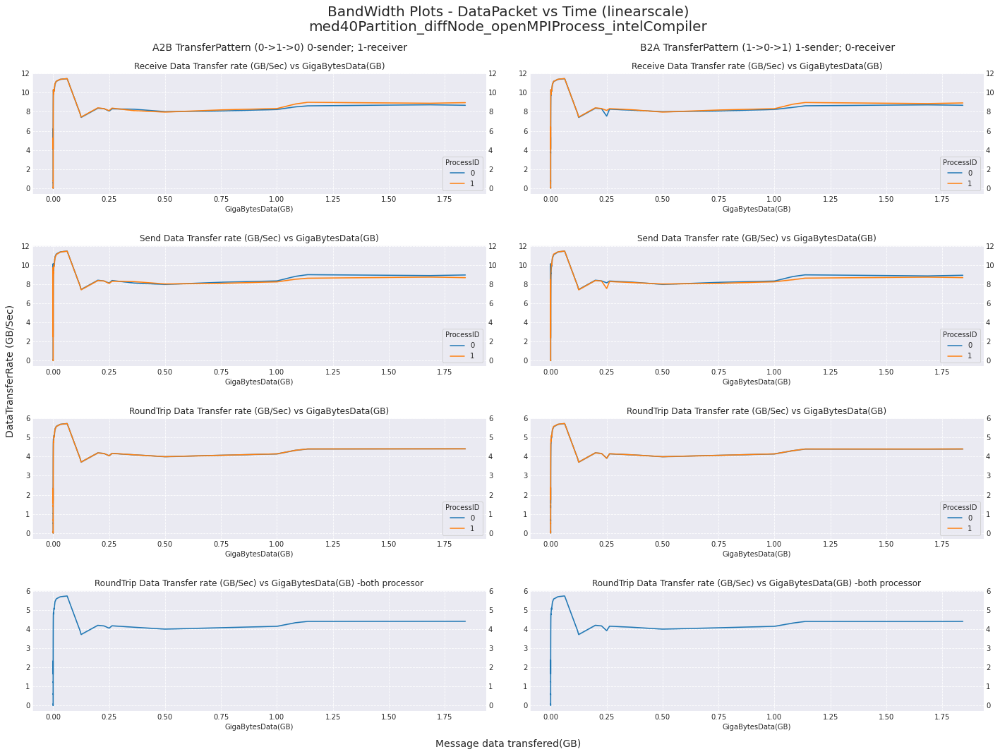

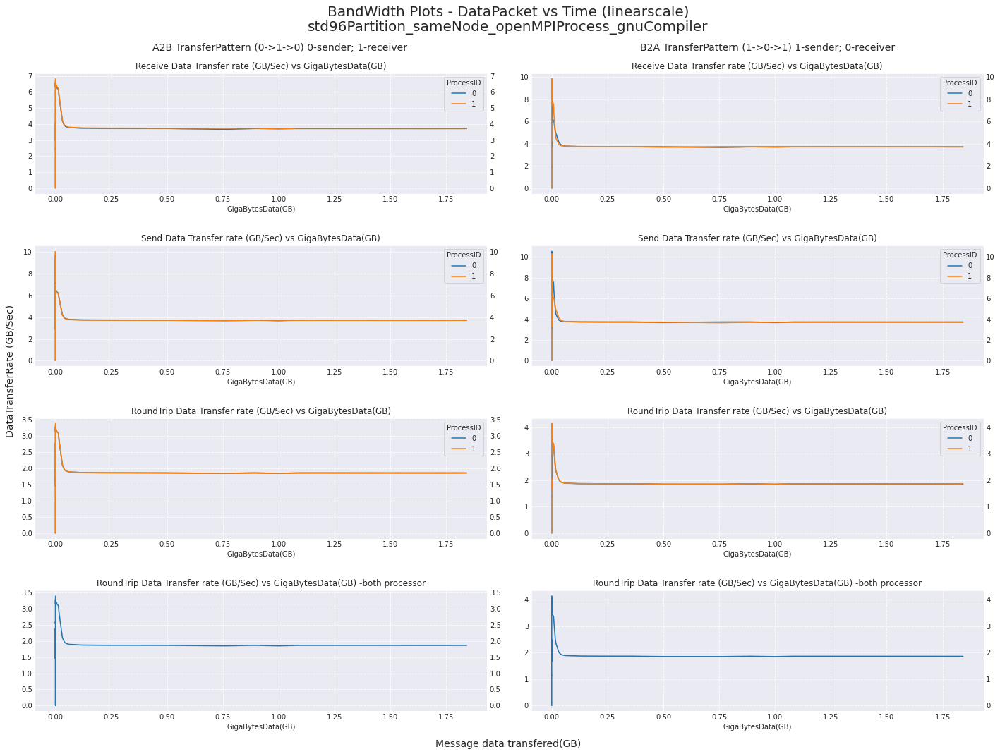

...

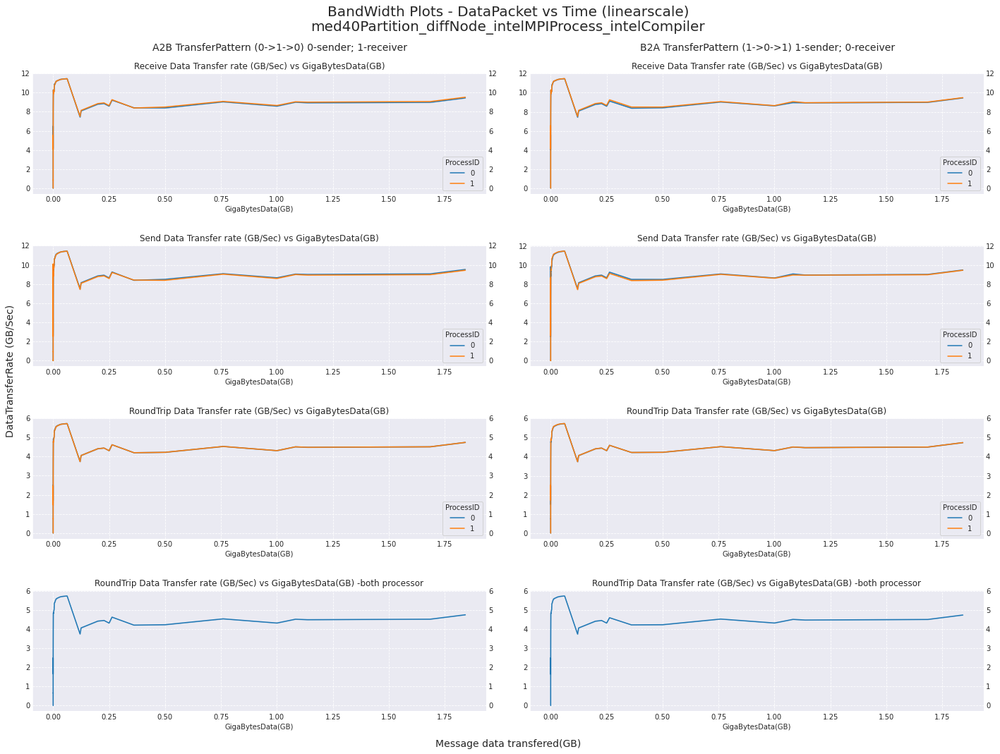

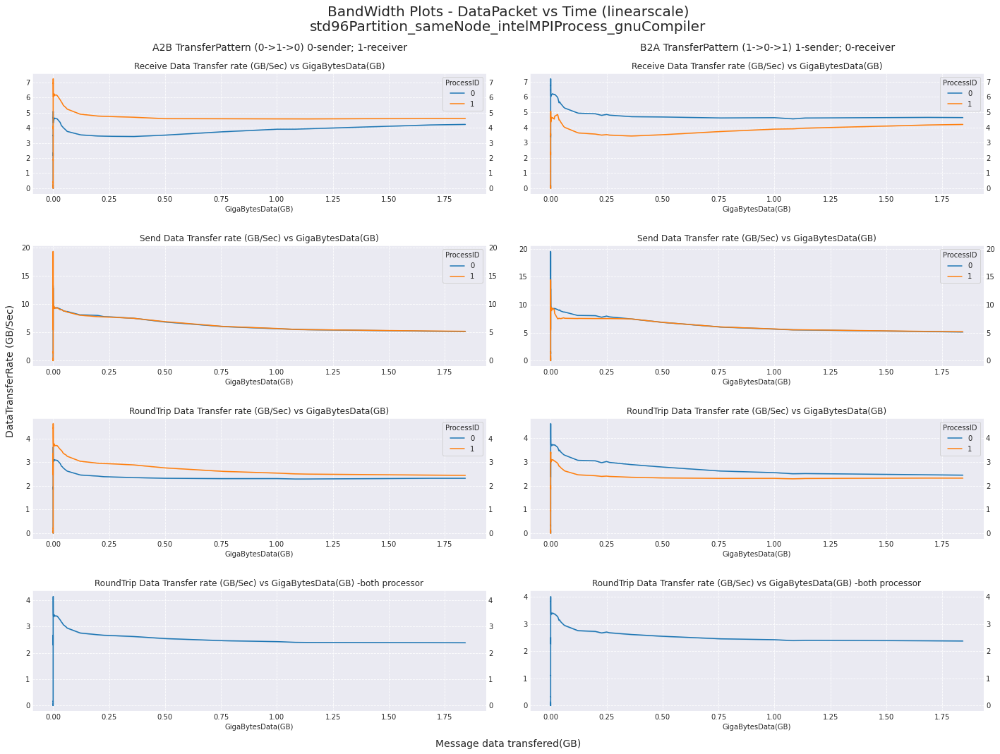

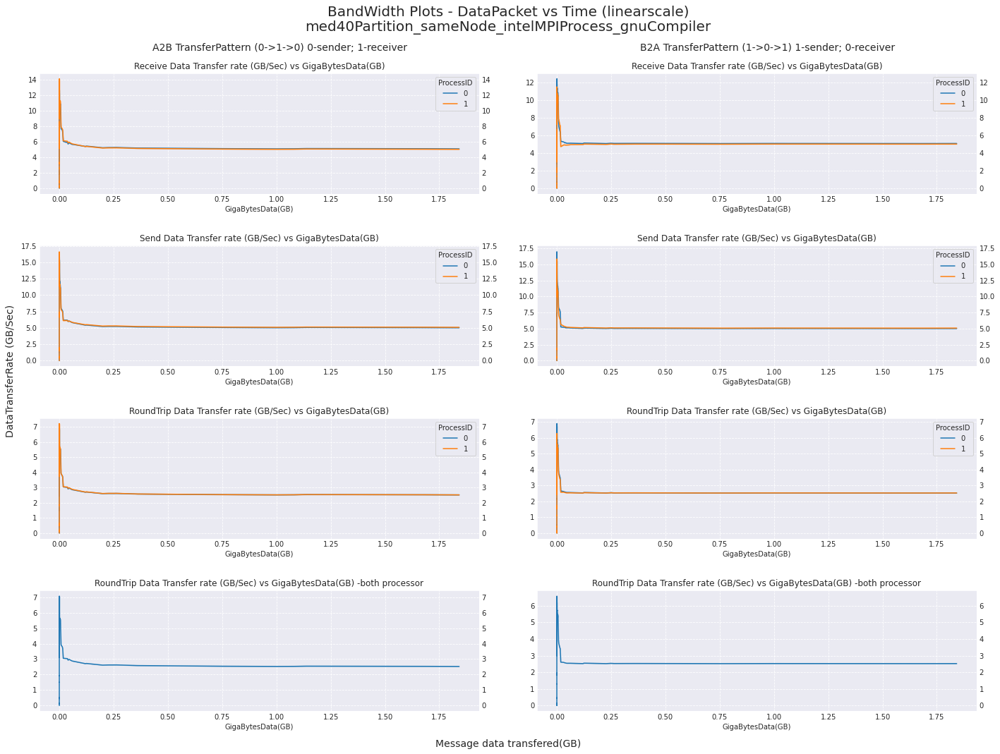

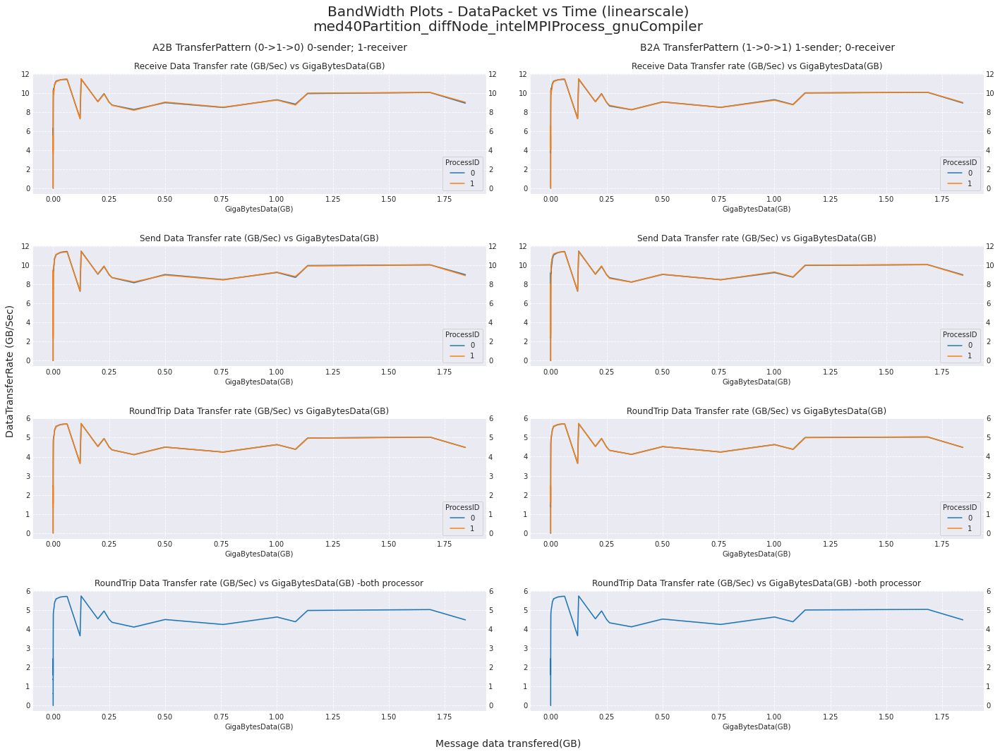

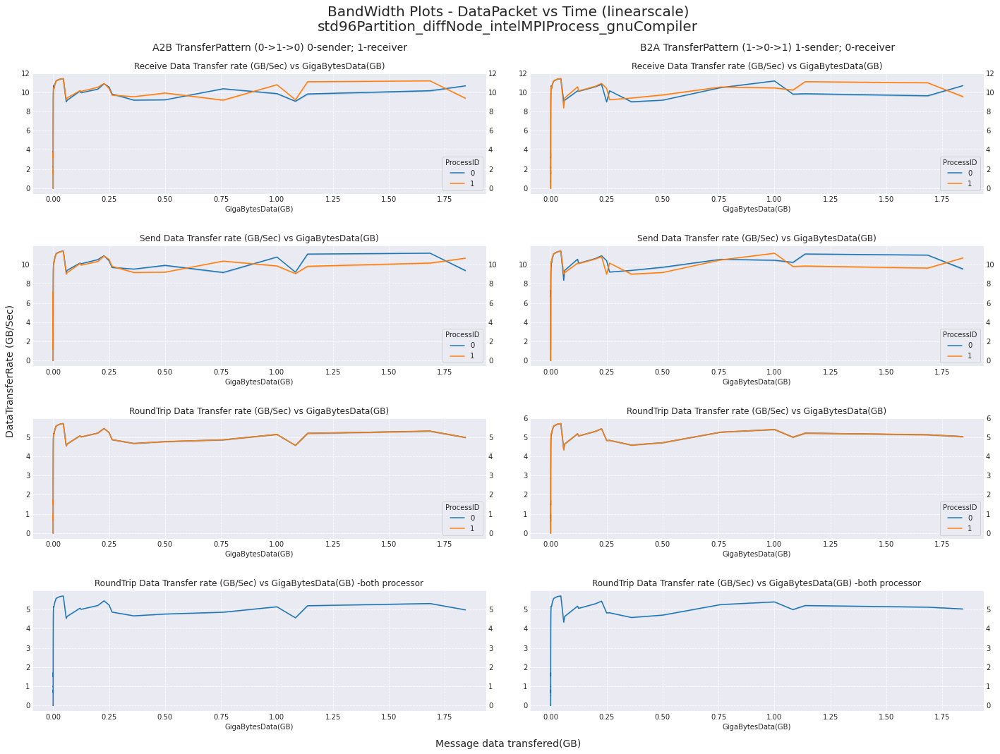

In [12]:
## linear scale plots for all setups
savePath = "/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results"
with open(f"{savePath}/pingPongDics.pickle", 'rb') as f:
    pingPongDfs = pickle.load(f)
    data_frames = pingPongDfs

xscale = yscale = 'linear'

for i, (name, df) in enumerate(data_frames.items()):
    parts = re.sub(r"\"|\[|\]|\'", "", name).split("_")
    print(name, '- separted:-', f'{parts[0]}',f'{parts[1]}',f'{parts[2]}',f'{parts[3]}')
    trasnferRateLinePlots(df, parts, savePath, xscale, yscale)   

## plotting %change in bandwidth vs packet size

In [14]:
## change in transfer rate with increase in data transfer size

def changeTrasnferRatePlots(df, parts, savePath, xscale, yscale, _estimator):

    """_summary_: Groups the data based on different message size. 
    Calculate the transfer rate. since there are multiple data points collected, the transfer rate data is grouped based on mean or median.
    Returns: dataframe with grouped data
    """

    data_h = df.groupby("TransferPattern")
    time_list = ['Receive', 'Send', 'RoundTrip']
    _dtype = 'GigaBytesData(GB)'
    _hue = "ProcessID"

    partition, nodeInfoText, process, compiler = f'{parts[0]}',f'{parts[1]}',f'{parts[2]}',f'{parts[3]}'
    plotName = f"ChangeInTransferRate_{yscale}ScalePlots_{partition}Partition_{nodeInfoText}Node_{process}Process_{compiler}Compiler"

    fig, axes = plt.subplots(4,2, figsize=(20, 15), sharex = False, sharey = False)
    fig.suptitle(f'Change in transfer rate (\u0394GB/Sec) vs Data (GB) -{xscale}_Scale\n{partition}Partition_{nodeInfoText}Node_{process}Process_{compiler}Compiler',
                     fontsize = 20)
    for i, (name, d) in enumerate(data_h):
        # print(name)
        if name == 'A2B': name = 'A2B TransferPattern (0->1->0) 0-sender; 1-receiver'
        elif name == 'B2A': name = 'B2A TransferPattern (1->0->1) 1-sender; 0-receiver'
        sns.set_style("darkgrid", {'grid.linestyle': '--'}) 
        for j, time in enumerate(time_list):
            _time = f'{time}'+'Time'
            y_value = (d[_dtype] / d[_time]).astype(float).pct_change()
            x_value = d[_dtype]
            sns.lineplot(data = d, x = x_value, y = y_value, hue = _hue, estimator = _estimator,
                         ax = axes[j+1][i] ).set_title(f'\u0394GB/Sec vs GB - {_time}')
            sns.lineplot(data = d, x = x_value, y = y_value, label = f'{_time}',
                         ax = axes[0][i] ).set_title(f'\u0394GB/Sec vs GB - Combined')
        fig.text(0.15 * (3.2 * i + 1), 0.92, f'{name}', fontsize = 14)
    
    for i, ax in enumerate(axes.flatten()):
        ax.grid(True)
        ax.set_yscale(xscale)
        ax.set_xscale(yscale)
        ax.tick_params(axis = 'both', direction = 'in', labelleft = True, labelright = True)

    fig.tight_layout(pad = 3.0)
    fig.text(0.01, 0.5, 'Change in DataTransferRate (\u0394GB/Sec)', va = 'center', ha = 'center', rotation = 'vertical', fontsize = 14)
    fig.text(0.5, 0.01, 'Message data transfered(GB)', va = 'center', ha = 'center',  fontsize = 14)
    plt.savefig(f"{savePath}/{plotName}.png")
    plt.show()
    return 



std96_same_openMPI_intel - separted:- std96 same openMPI intel


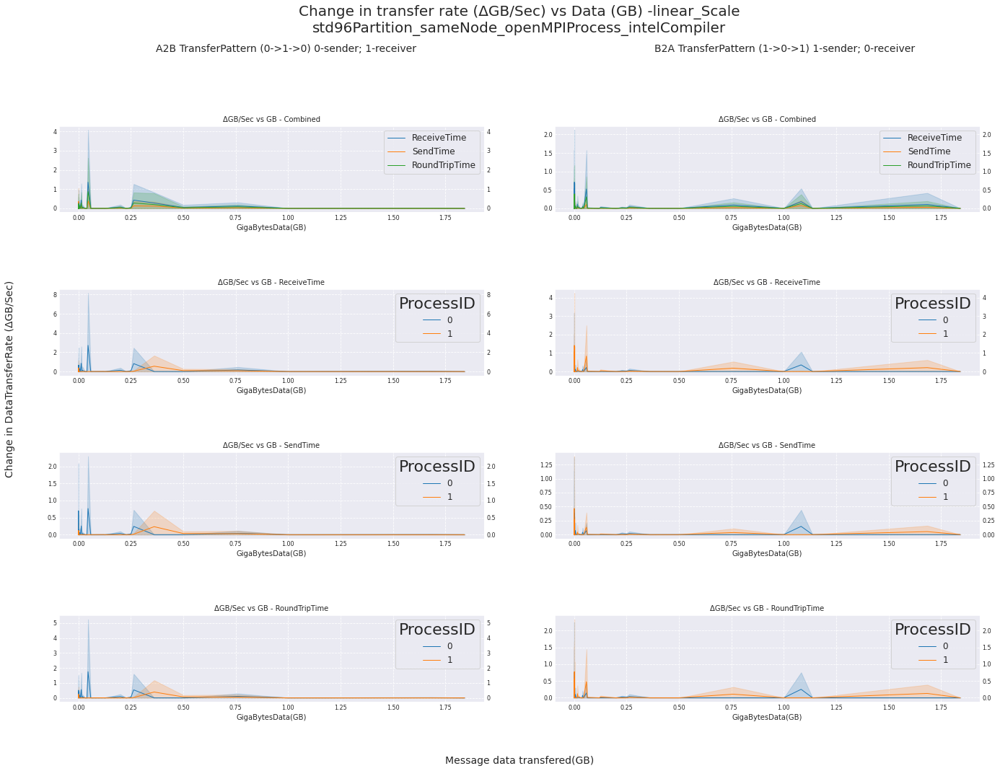

med40_same_openMPI_intel - separted:- med40 same openMPI intel


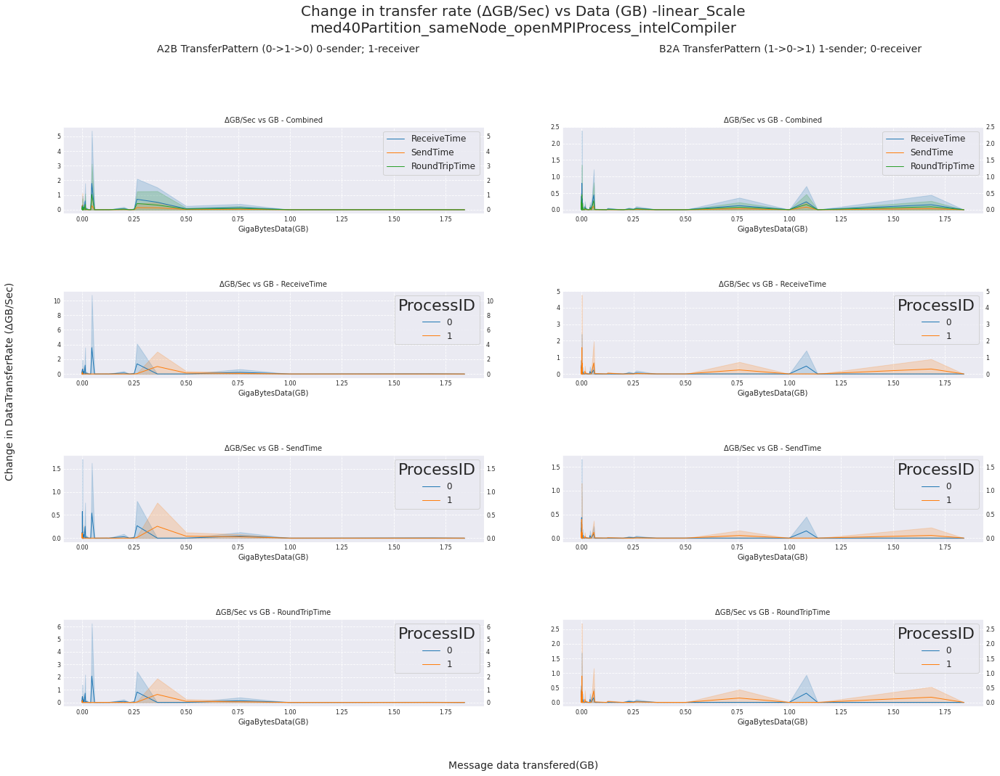

std96_diff_openMPI_intel - separted:- std96 diff openMPI intel


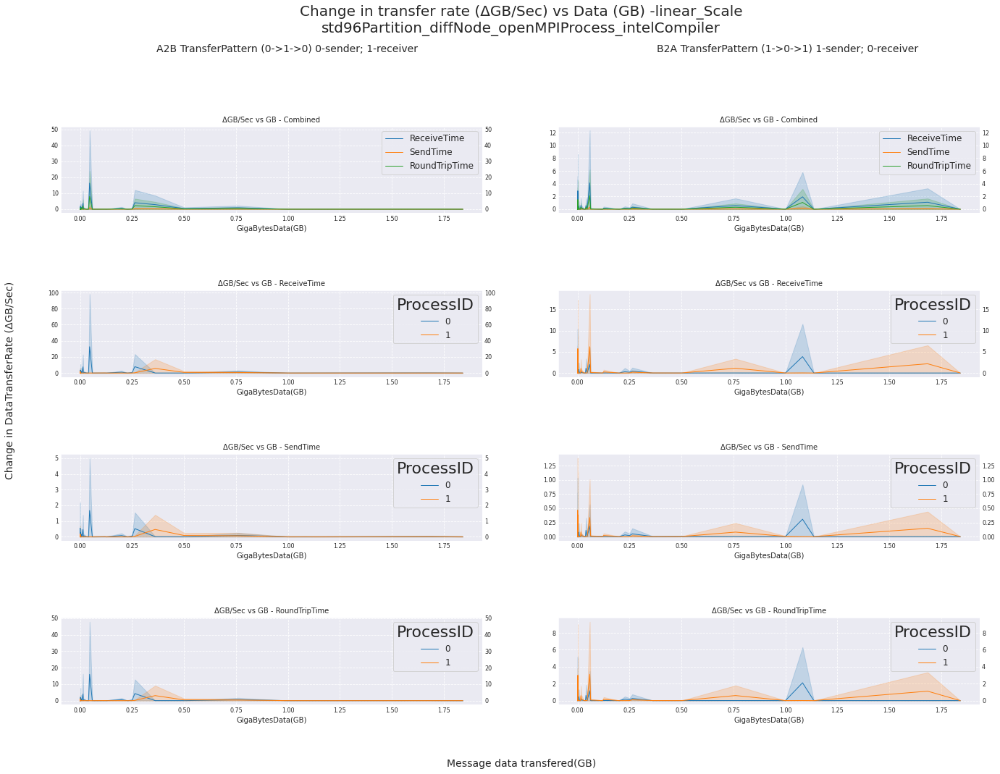

med40_diff_openMPI_intel - separted:- med40 diff openMPI intel


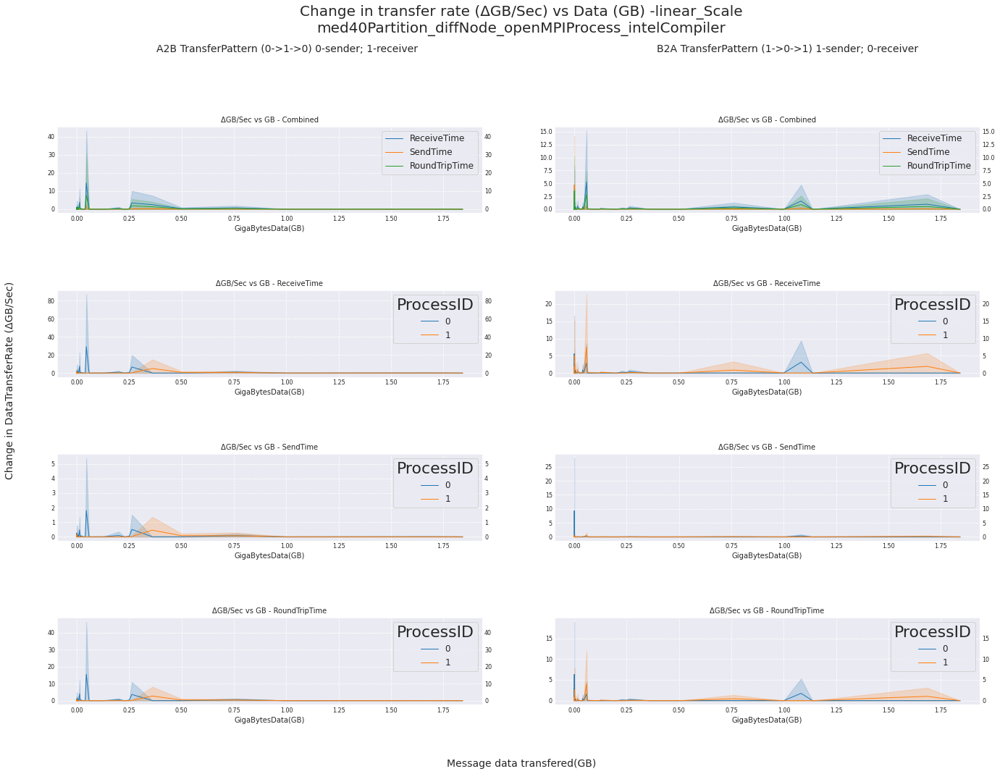

std96_same_openMPI_gnu - separted:- std96 same openMPI gnu


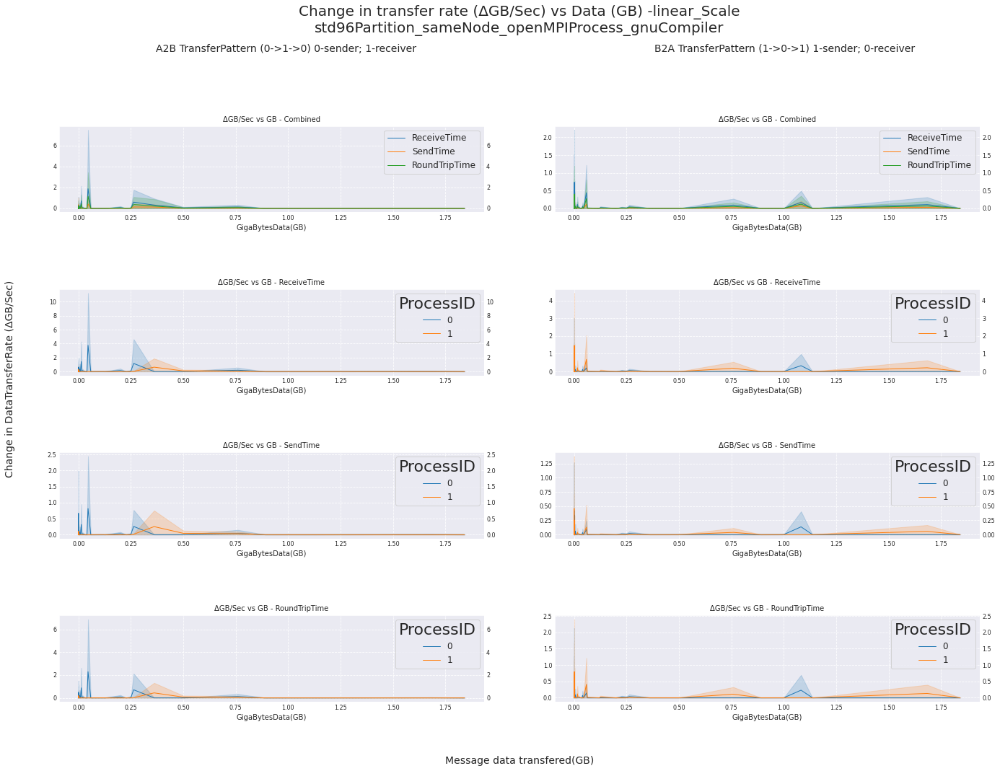

med40_same_openMPI_gnu - separted:- med40 same openMPI gnu


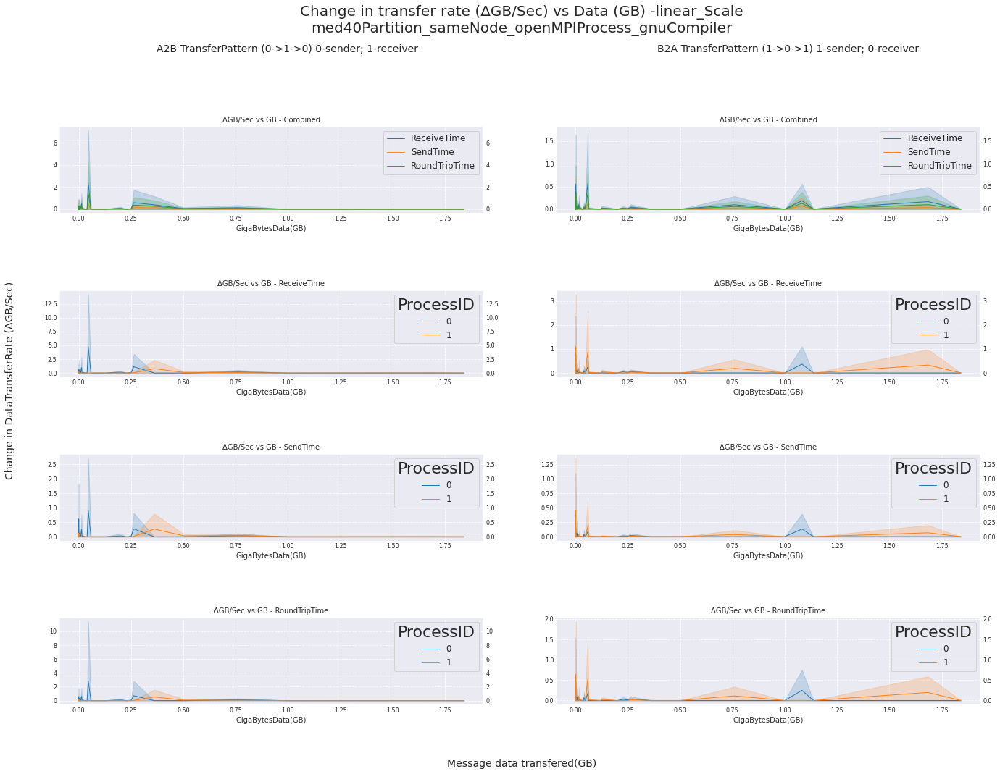

med40_diff_openMPI_gnu - separted:- med40 diff openMPI gnu


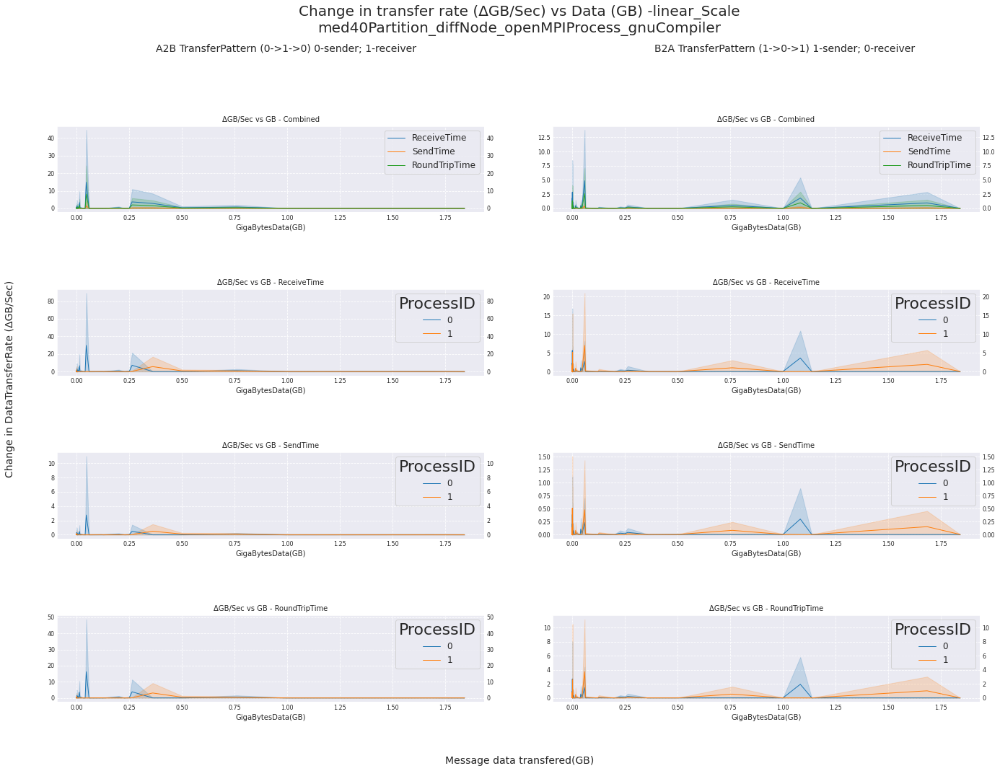

std96_diff_openMPI_gnu - separted:- std96 diff openMPI gnu


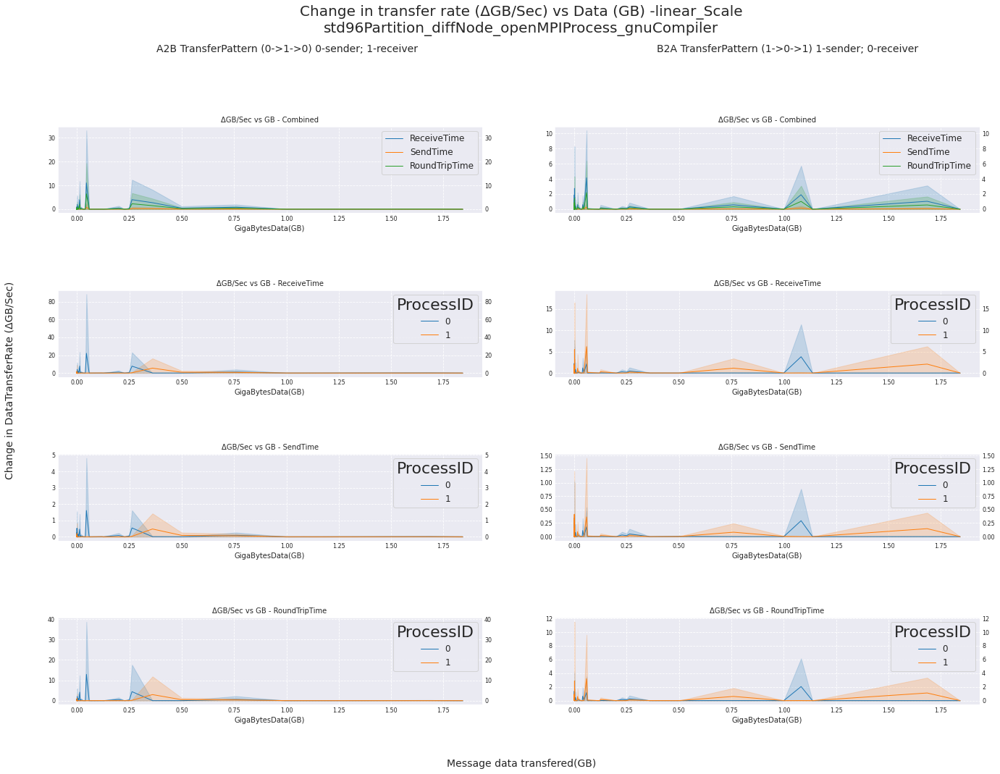

med40_same_intelMPI_intel - separted:- med40 same intelMPI intel


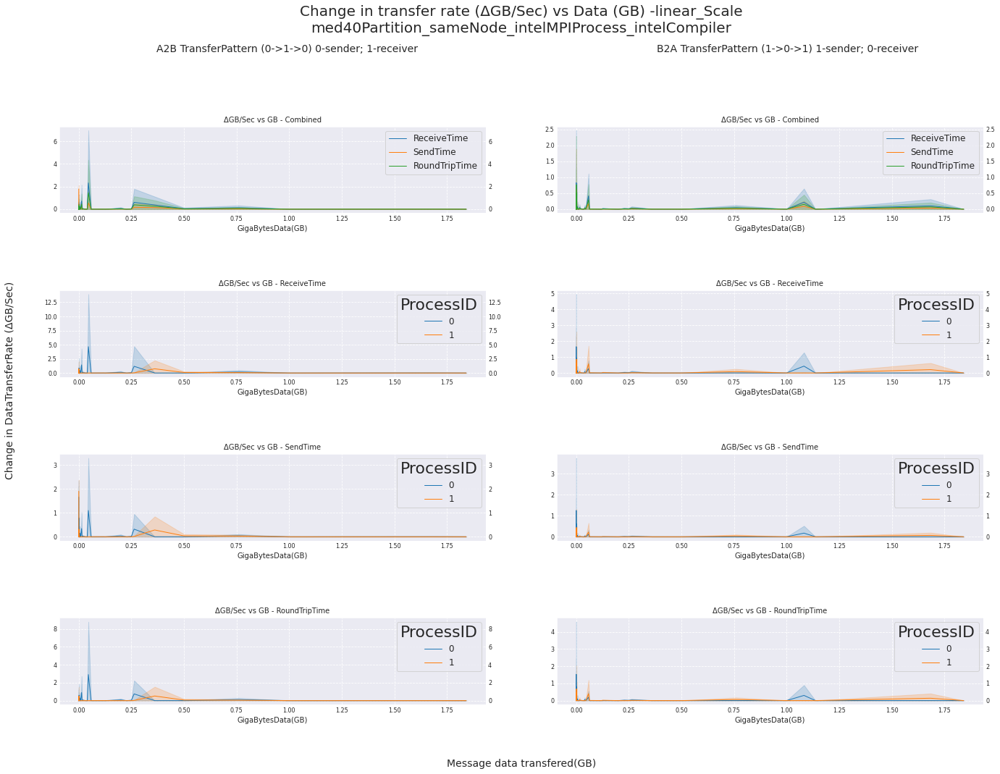

std96_same_intelMPI_intel - separted:- std96 same intelMPI intel


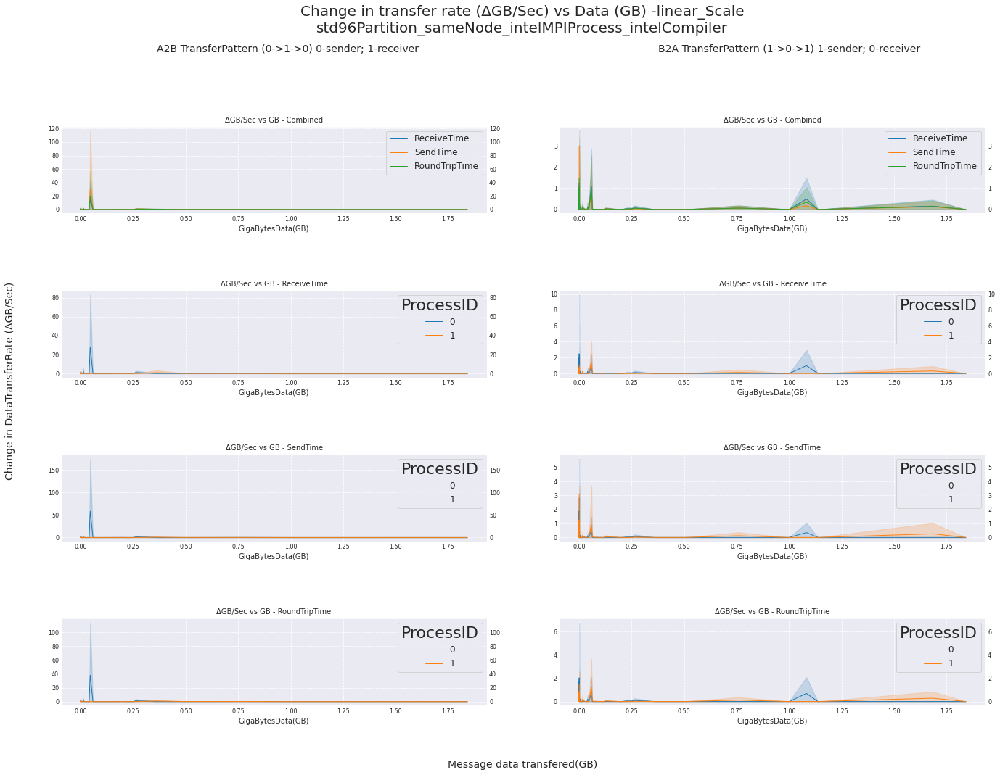

std96_diff_intelMPI_intel - separted:- std96 diff intelMPI intel


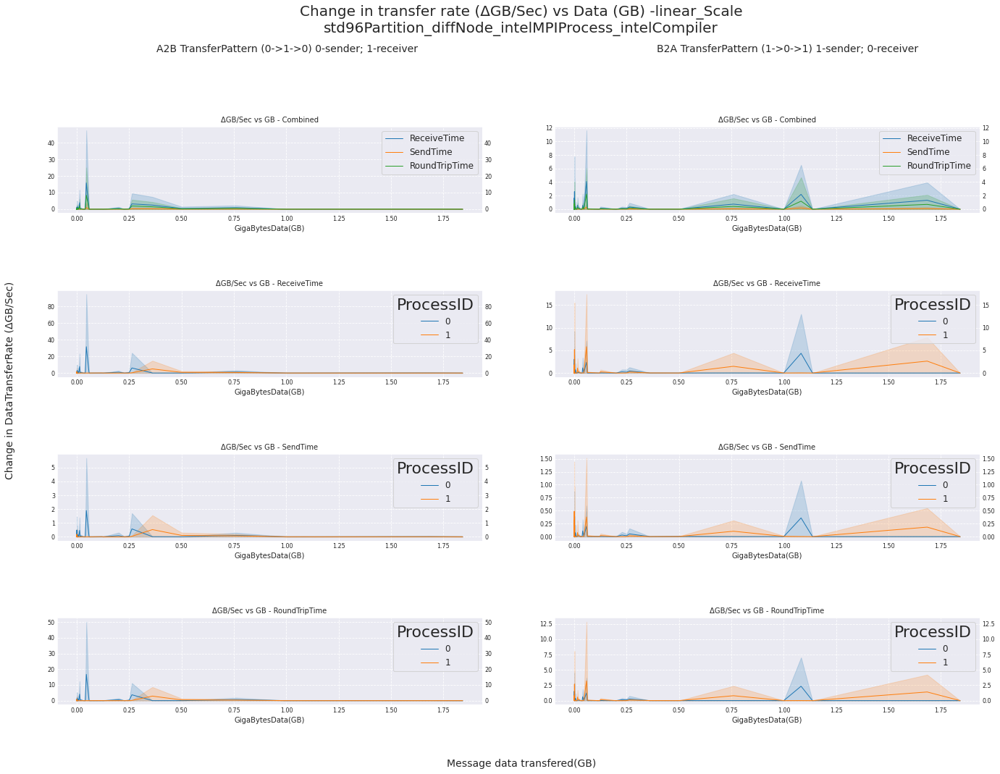

med40_diff_intelMPI_intel - separted:- med40 diff intelMPI intel


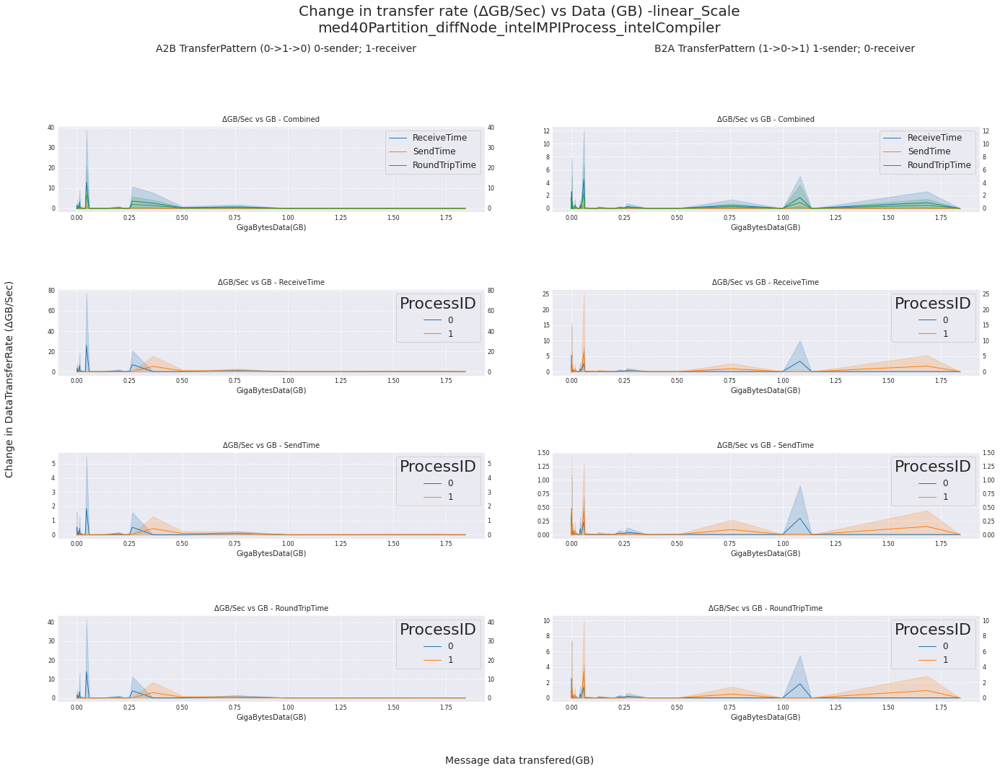

std96_same_intelMPI_gnu - separted:- std96 same intelMPI gnu


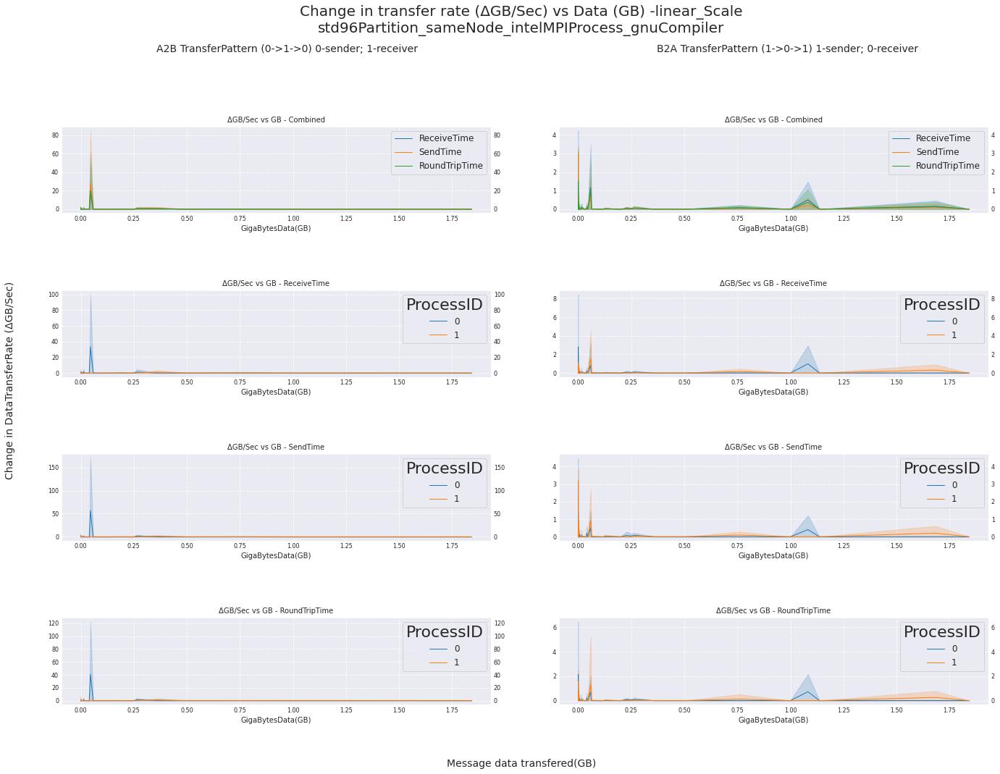

med40_same_intelMPI_gnu - separted:- med40 same intelMPI gnu


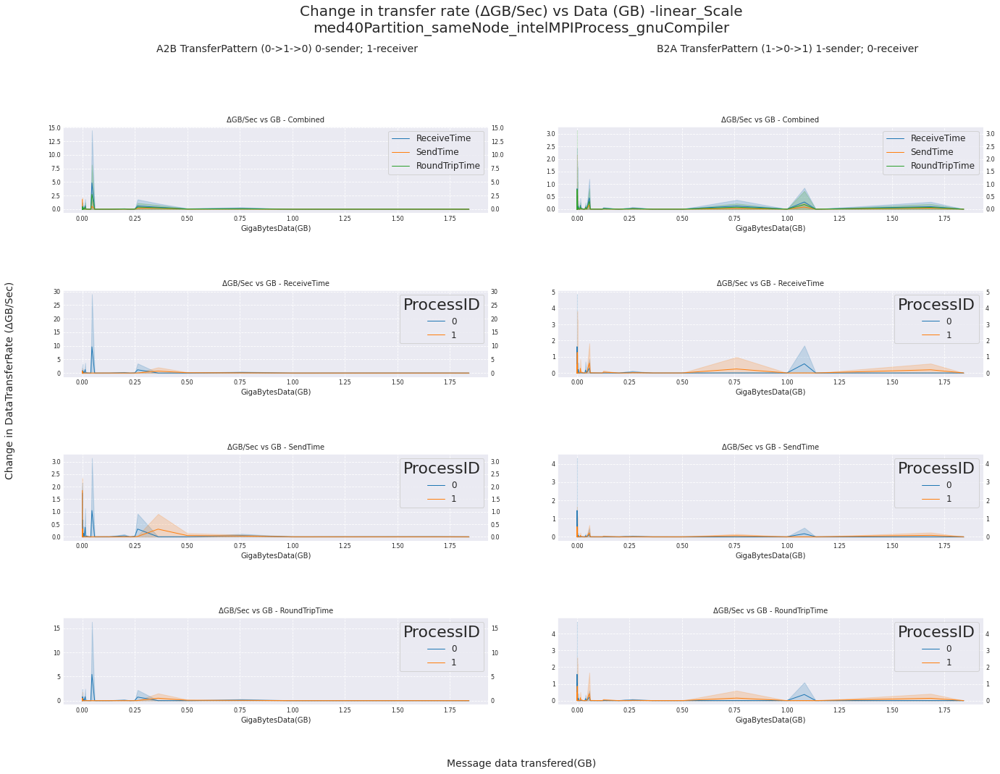

med40_diff_intelMPI_gnu - separted:- med40 diff intelMPI gnu


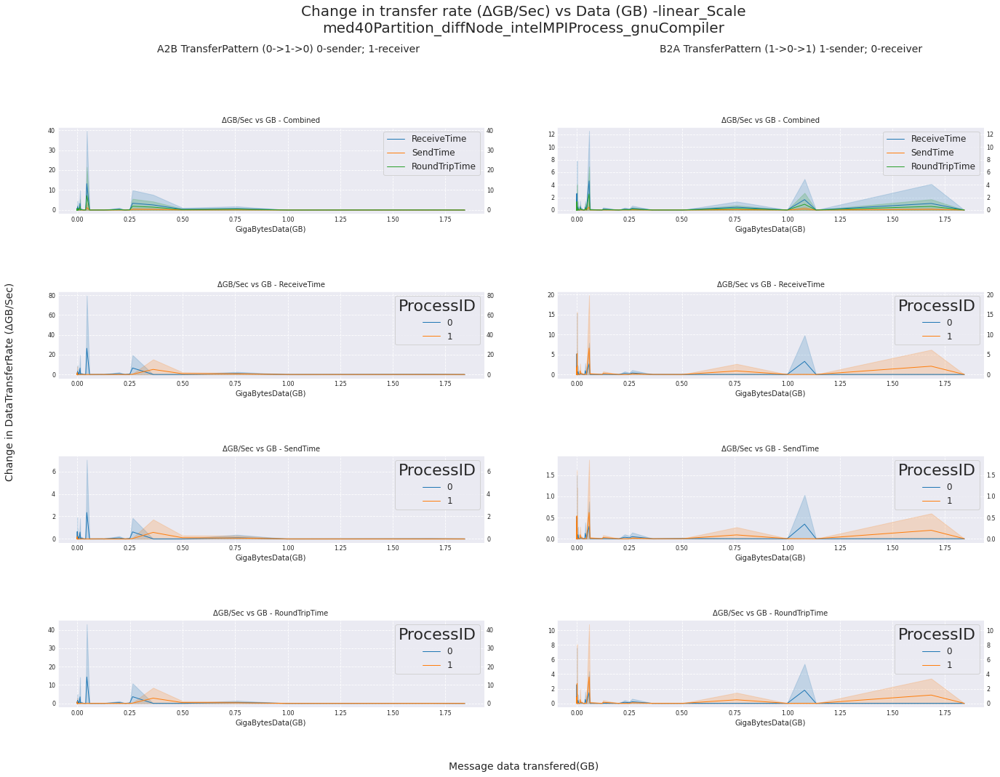

std96_diff_intelMPI_gnu - separted:- std96 diff intelMPI gnu


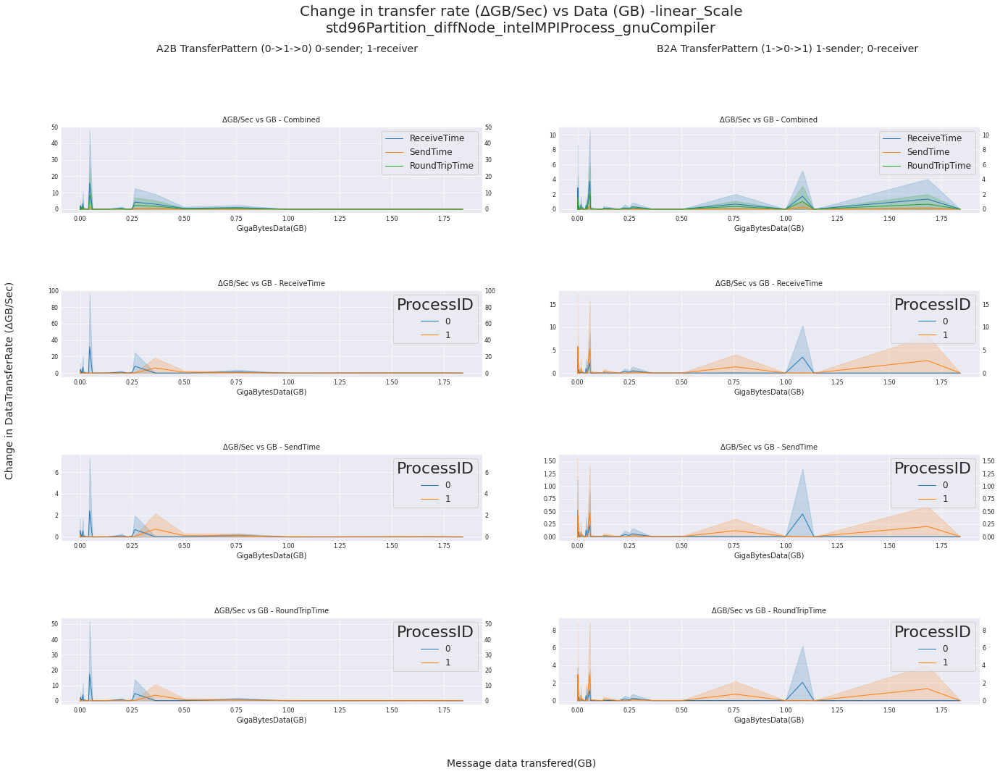

In [15]:
savePath = "/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results"
with open(f"{savePath}/pingPongDics.pickle", 'rb') as f:
    pingPongDfs = pickle.load(f)
    data_frames = pingPongDfs

xscale = yscale = 'linear'
_estimator = 'mean'

for name, df in data_frames.items():
    parts = re.sub(r"\"|\[|\]|\'", "", name).split("_")
    print(name, '- separted:-', f'{parts[0]}',f'{parts[1]}',f'{parts[2]}',f'{parts[3]}')
    changeTrasnferRatePlots(df, parts, savePath, xscale, yscale, _estimator)
    # break


## Comparing different systems 

### compare transfer rates

- inter process and partitions 
    - intelMPI vs openMPI
    - med40 vs std96
    - different vs same 
    - intel vs gcc
- intra process and partitions 
    - intel
    - gcc
    - MPI
    - same or different



In [ ]:
def extractComparingDfs(type1, type2, dataFrameList):

    dfListPair = []
    print(type1, '__vs__', type2)
    # print(dataFrameList.keys())
    for name, df in dataFrameList.items():
        # print(name)
        if (type1 not in name.split("_")) and (type2 not in name.split("_")):
             print("Case and spelling sensitive for type1 and/or type2")

        elif type1 in name.split("_"):
            newName = name.split("_")
            type1ID = newName.index(type1)
            newName[type1ID] = type2
            newName = ("_").join(newName)
            if newName in dataFrameList.keys():
                # print('type1_DF:-->', name, "type2_DF:-->", newName)
                dfListPair.append([name, newName])
            else: 
                return print("newName Formed is wrong, Check case and spelling of type2")
            
        # elif type2 in name.split("_"):
        #     newName = name.split("_")
        #     type2ID = newName.index(type2)
        #     newName[type2ID] = type1
        #     newName = ("_").join(newName)
        #     if newName in dataFrameList.keys():
        #         print('type1_DF:-->', name, "type2_DF:-->", newName)
        #         dfListPair.append([name, newName])
        #     else: 
        #         return print("newName Formed is wrong, Check case and spelling of type2")
           

    # print('Total pairs present', len(dfListPair))

    return dfListPair

# dfList = extractComparingDfs(type1 = 'MPI', type2 = 'openMP', dataFrameList = data_frames)
# dfList[0]

In [ ]:
def plotDiffSystems(type1, type2, df_list,  xscale, yscale, errorbar = None):
    df1 = data_frames[df_list[0]]
    df2 = data_frames[df_list[1]]

    grouped_df1 = transferRateChange_groupingData(df1, 1024*1024*1024, 'mean')
    grouped_df2 = transferRateChange_groupingData(df2, 1024*1024*1024, 'mean')

    fig, axes = plt.subplots(3,1, figsize=(20,20))
    fig.suptitle(fontsize = 15, y = 0.95,
                t = f'Comparing:{type1}__vs __{type2}\n using:--> {df_list[0]} __vs __ {df_list[1]}\n W.R.T change of Transfer Rate with increasing BytesData\n {xscale}_xScale & {yscale}_yScale')
    
    sns.lineplot(data = grouped_df1, x = grouped_df1['BytesData'], y = grouped_df1['roundPct_change'],estimator='mean', 
                 errorbar = errorbar, label = f'{type1}_{df_list[0]}_RoundTrip', ax = axes[0], linestyle = ':')
    sns.lineplot(data = grouped_df2, x = grouped_df2['BytesData'], y = grouped_df2['roundPct_change'], estimator='mean', 
                 errorbar =errorbar, label = f'{type2}_{df_list[1]}RoundTrip', ax = axes[0], linestyle = '-').set_title(f'Data Transfer rate vs BytesData')
    
    sns.lineplot(data = grouped_df1, x = grouped_df1['BytesData'], y = grouped_df1['receivePct_change'], label = f'{type1}_{df_list[0]}_receiveTrip',
                 errorbar = errorbar, ax = axes[1]).set_title(f'Receive Data Transfer rate vs BytesData')
    sns.lineplot(data = grouped_df2, x = grouped_df2['BytesData'], y = grouped_df2['receivePct_change'], label = f'{type2}_{df_list[1]}receiveTrip',
                 errorbar = errorbar,  ax = axes[1]).set_title(f'Receive Data Transfer rate vs BytesData')
    
    sns.lineplot(data = grouped_df1, x = grouped_df1['BytesData'], y = grouped_df1['sendPct_change'], label = f'{type1}_{df_list[0]}_sendTrip',
                 errorbar = errorbar,   ax = axes[2]).set_title(f'Send Data Transfer Rate vs BytesData')
    sns.lineplot(data = grouped_df2, x = grouped_df2['BytesData'], y = grouped_df2['sendPct_change'], label = f'{type2}_{df_list[1]}_sendTrip',
                 errorbar = errorbar,    ax = axes[2]).set_title(f'Send Data Transfer Rate vs BytesData')
    
    for ax in axes:
        ax.grid(True)
        ax.set_yscale(yscale)
        ax.set_xscale(xscale)
        ax.set_ylabel('Change in DataTransferRate (\u0394GB/Sec)') 
        ax.set_xlabel('Data Transfered (GB)')
        ax.tick_params(axis='both', direction='in', labelleft=True, labelright=True)
    


# compareDiffSystem(df_list, errorbar = ('ci',95))
def compareDiffSystems(type1, type2, dataFrameList, xscale, yscale):
    df_pairs = extractComparingDfs(type1, type2, dataFrameList)

    for i, list in enumerate (df_pairs) :
        print(i+1, 'Pair:--->', list[0], '__vs__', list[1])
        plotDiffSystems(type1, type2, list, xscale = xscale, yscale = yscale)
        break

x_ = 'log'
y_ = 'log'#'linear'
# MPI_vs_openMP = 
compareDiffSystems(type1 = 'MPI', type2 = 'openMP', dataFrameList = data_frames, xscale = x_, yscale = y_)

In [ ]:
grouped_df = d.groupby('BytesData').mean()['transferRate'].reset_index()
print(grouped_df.head(5))
grouped_df['pct_change'] = grouped_df['transferRate'].pct_change()
print(grouped_df.head(5))
grouped_df.plot(x='BytesData', y='transferRate', kind='line')



In [ ]:
2+2

## Arrange the file into different folders 

In [ ]:
import dataUtility as du

du.transferPdfAnalysis(resultFolder = 'Results_1')

In [ ]:
def transferPdfAnalysis(resultFolder, pdfSourceDataPath = None):
    """Folder name : resultFolder
    Subfolder 1: ajapath to the source folder
    """

    if pdfSourceDataPath == None:
        pdfSourceDataPath = os.getcwd()
        pdfs = Path(pdfSourceDataPath).glob("*.pdf")
    else:
        pdfs = Path(pdfSourceDataPath).glob("*.pdf")

    # resultPath = os.getcwd() + f'/{resultFolder}'
    resultPath = os.path.join(os.getcwd(), resultFolder)
    os.makedirs(resultPath, exist_ok=True) 
    
    global printed
    for pdf in pdfs:
        # print(pdf)
        pdfName = str(pdf).split("/")[-1:]
        pdfName = re.sub(r"\"|\[|\'|\]", "", str(pdfName))
        compiler = pdfName.split('.')[0].split('_')[-1]
        library = pdfName.split('.')[0].split('_')[-2]
        # print(f'Compiler: {compiler} Library: {library}')

        validSubFolders = ['openMPIProcess', 'intelMPIProcess', 
                           'gnuCompiler', 'intelCompiler']
        if library not in validSubFolders or compiler not in validSubFolders:
            print(f'Invalid sub folder library->{library} and compiler->{compiler} used in\n{pdf}')
            continue
    

        
        if library in ['openMPIProcess', 'intelMPIProcess'] and compiler in ['gnuCompiler', 'intelCompiler']:
            subFolderPath = os.path.join(resultPath, library, compiler)
            # print(subFolderPath)
            os.makedirs(subFolderPath, exist_ok=True)
        else:
            print(f'UnIdentified {compiler}/{library} name used in {pdf}')

transferPdfAnalysis(resultFolder = 'Results_1')

In [ ]:
x = str(['logScaleTransfeRatePlots_med40Partition_sameNode_openMPIProcess_gnuCompiler.pdf'])
xe = re.sub(r"\"|\[|\'|\]", "", str(x))
xe.split('_')[0]


## data analysis

- latency modelling https://durham-phys52015.github.io/exercises/mpi-ping-pong/

In [ ]:

for name, df in data_frames.items():
    print(f'tansfer details for {name} with unique dataPackets present {df['BytesData'].nunique()}')

# df.head()

In [ ]:
# df[df['BytesData'] == 19208.0]['RoundTripTime'].mean()
x, y = [], []

def plotting(x, y, linestyle, label, color, marker):
    plt.plot(x, y, label = label, color = color, linestyle = linestyle, marker = marker)
    # plt.yscale(yScale)
    # plt.xscale(xScale)
    # plt.xlabel(xlabel)
    # plt.ylabel(ylabel)
    plt.legend()
    plt.grid(True)
    plt.show()

uniqueDataPackets = df['BytesData'].unique()
for packet in uniqueDataPackets:
    # print(packet, df[df['BytesData'] == packet]['RoundTripTime'].mean())
    x.append(packet)#/(1024*1024*1024))
    y.append(df[df['BytesData'] == packet]['RoundTripTime'].mean())

x = np.array(x)
y = np.array(y)
z = np.polyfit(x, y, 1)
slope = z[0]
intercept = z[1]
# print(x, '\n', y)
# plt.figure(figsize=(20, 8))
# Create the fitted line equation using y = mx + b

fitted_line_y = slope * x + intercept

for i in range(2):
    if i==0: plt.plot(x, fitted_line_y, '.-.', label='Fitted line', color='pink')
    if i == 1: plt.plot(x, y, 'o', label='Data')
    plt.xlabel("X-axis")
    plt.ylabel("Y-axis-seconds")
    plt.legend()
    plt.grid(True)
    # plt.plot(x, fitted_line_y, '.-.', label='Fitted line', color='pink')
# plt.plot(x, y, 'o', label='Data')  # Plot the data 
# plt.title("Linear Regression")
# plt.xlabel("X-axis")
# plt.ylabel("Y-axis-seconds")
# plt.legend()
# plt.grid(True)
# plotting(x, fitted_line_y, '--', label = 'fitted line', color = 'blue', marker = 'p')
# plotting(x, y, ':', label = 'Data', color = 'red', marker = 'o')
# plt.show()
# -', '--', '-.', ':', 'None', ' ', '', 'solid', 'dashed', 'dashdot', 'dotted'
rate = 1/slope
rate = rate/(1024*1024*1024)
rate # in gb/sec



In [ ]:
x = np.array([0.0, 1.0, 2.0, 3.0,  4.0,  5.0])
y = np.array([0.0, 0.00_00_01, 0.00_00_02000, 0.00_00_03000,  0.00_00_04000,  0.00_00_05000])
z = np.polyfit(x, y, 1)
plt.plot(x, y, 'b')
z

In [ ]:
x = np.array([0.0, 1.0, 2.0, 3.0,  4.0,  5.0])
y = np.array([0.0, 100.0, 200.0, 300.0,  400.0,  500.0])
z = np.polyfit(x, y, 1)
plt.plot(x, y, 'b')
z

In [ ]:
def transferRateChange_groupingData(df, scale, groupType):

    """_summary_: Groups the data based on different message size. 
    Calculate the transfer rate. since there are multiple data points collected, the transfer rate data is grouped based on mean or median.


    Returns: dataframe with grouped data
    """

    # print(df['BytesData'].unique())
    grouped_df = pd.DataFrame()
    grouped_df['BytesData'] = df['BytesData'] / scale
    grouped_df['ProcessID'] = df['ProcessID']

    grouped_df['receivePct_change'] = (df['BytesData']/df['ReceiveTime']/scale).astype(float).pct_change()
    grouped_df['sendPct_change'] = (df['BytesData']/df['SendTime']/scale).astype(float).pct_change()
    grouped_df['roundPct_change'] = (df['BytesData']/df['RoundTripTime']/scale).astype(float).pct_change()  
    grouped_df = grouped_df.dropna().reset_index(drop=True)  
    grouped_df.set_index('BytesData', inplace=True)
    
    if (groupType == 'mean'):
        grouped_df = grouped_df.groupby(['BytesData', 'ProcessID']).mean().reset_index()
    elif (groupType == 'median'):
        grouped_df = grouped_df.groupby(['BytesData', 'ProcessID']).median().reset_index()
    
    # print(grouped_df.head())

    return grouped_df

# data packet vs time to get alpha and beta
- https://durham-phys52015.github.io/exercises/mpi-ping-pong/

std96_same_openMPI_intel
med40_same_openMPI_intel
std96_diff_openMPI_intel
med40_diff_openMPI_intel
std96_same_openMPI_gnu
med40_same_openMPI_gnu
med40_diff_openMPI_gnu
std96_diff_openMPI_gnu
med40_same_intelMPI_intel
std96_same_intelMPI_intel
std96_diff_intelMPI_intel
med40_diff_intelMPI_intel
std96_same_intelMPI_gnu
med40_same_intelMPI_gnu
med40_diff_intelMPI_gnu
std96_diff_intelMPI_gnu


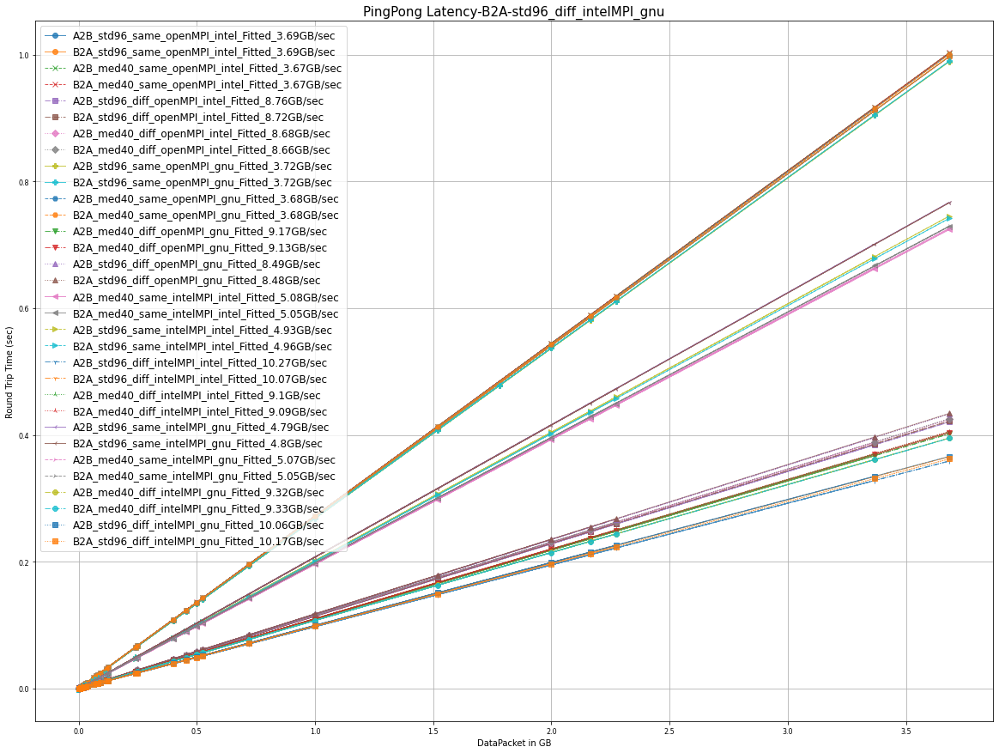

In [6]:
# data_frames
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
i = 0
markers = ['o', 'x', 's', 'D', 'P', 'H', 'v', '^', '<', '>', '1', 
           '2', '3', '4', '8', 's', 'p', '*', '+', 'x', 'D', 'd', '|', '_']
linestyles = ['-', '--', '-.', ':', 'solid', 'dashed', 'dashdot', 'dotted']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'w']

savePath = "/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results"
with open(f"{savePath}/pingPongDics.pickle", 'rb') as f:
    pingPongDfs = pickle.load(f)
    data_frames = pingPongDfs
    

for name, dfs in data_frames.items():
    print(name)
    for pattern, df in dfs.groupby('TransferPattern'):
        uniqueDataPackets = df['GigaBytesData(GB)'].unique()
        x, y = [], []
        for packet in uniqueDataPackets:
            x.append(packet * 2)
            y.append(df[df['GigaBytesData(GB)'] == packet]['RoundTripTime'].mean())
    
        x = np.array(x, dtype=np.float32)
        y = np.array(y, dtype=np.float32)
        z = np.polyfit(x, y, 1)
        # print(y)
        slope = z[0]
        intercept = z[1]
        # Create the fitted line equation using y = mx + b
        fitted_line_y = slope * x + intercept
        rate = round(1/slope, 2)
        label = str(f"{pattern}_{name}_Fitted_{rate}GB/sec")

        plt.rcParams.update({'font.size': 22,
                             "figure.figsize" : [20,15],
                             "axes.titlesize" : 10,
                             "axes.labelsize" : 10,
                             "lines.linewidth" : 1,
                             "lines.markersize" : 6,
                             "xtick.labelsize" : 8,
                             'ytick.labelsize' : 8, 
                             'legend.fontsize': 12})
        plt.plot(x, fitted_line_y, marker = markers[i], label=label, linestyle = linestyles[i % len(linestyles)], alpha = 0.8)
        plt.xlabel("DataPacket in GB")
        plt.ylabel('Round Trip Time (sec)')
        plt.title(f"PingPong Latency-{pattern}-{name}", fontsize = 15)
        plt.legend()
        plt.grid(True)
    i += 1
plt.savefig(f"{savePath}/CombinedPingPongLatency.png")
    # if  i == 3: break

In [4]:
! pip install plotly
import plotly

     |████████████████████████████████| 15.6 MB 7.2 MB/s            
  Using cached packaging-21.3-py3-none-any.whl (40 kB)


In [8]:
# data_frames
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
i = 0
markers = ['o', 'x', 's', 'D', 'P', 'H', 'v', '^', '<', '>', '1', 
           '2', '3', '4', '8', 's', 'p', '*', '+', 'x', 'D', 'd', '|', '_']
linestyles = ['-', '--', '-.', ':', 'solid', 'dashed', 'dashdot', 'dotted']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'w']

savePath = "/home/gzextschak/Code_Files/Analysis_pyhton_transferData/transferAnalysis/results"
with open(f"{savePath}/pingPongDics.pickle", 'rb') as f:
    pingPongDfs = pickle.load(f)
    data_frames = pingPongDfs
    
dummy_ = {}
for name, dfs in data_frames.items():
    # print(name)
    for pattern, df in dfs.groupby('TransferPattern'):
        uniqueDataPackets = df['GigaBytesData(GB)'].unique()
        # print(len(uniqueDataPackets))
        x, y = [], []
        for packet in uniqueDataPackets:
            x.append(packet * 2)
            y.append(df[df['GigaBytesData(GB)'] == packet]['RoundTripTime'].mean())
    
        x = np.array(x, dtype = np.float32)
        y = np.array(y, dtype = np.float32)
        z = np.polyfit(x, y, 1)
        # print(y)
        slope = z[0]
        intercept = z[1]
        # Create the fitted line equation using y = mx + b
        fitted_line_y = slope * x + intercept
        rate = round(1/slope, 2)
        label = str(f"{pattern}_{name}_Fitted_{rate}GB/sec")
        # dummy['dataPacket'] = x
        dummy_[f'{label}'] = fitted_line_y
        dummy_['dataPacket'] = x

# fig = px.line(df = dummy, x = 'dataPacket' ,
#               title = f'{label}')
dummy = pd.DataFrame([dummy_])
dummy.head()
# fig = px.line(dummy, x = dummy.dataPacket, y = dummy.columns, template = 'plotly_dark')
# fig.show()



,A2B_std96_same_openMPI_gnu_Fitted_3.66GB/sec,dataPacket,B2A_std96_same_openMPI_gnu_Fitted_3.66GB/sec,A2B_med40_same_openMPI_gnu_Fitted_3.76GB/sec,B2A_med40_same_openMPI_gnu_Fitted_3.76GB/sec,A2B_med40_diff_openMPI_gnu_Fitted_8.94GB/sec,B2A_med40_diff_openMPI_gnu_Fitted_8.9GB/sec,A2B_std96_diff_openMPI_gnu_Fitted_8.64GB/sec,B2A_std96_diff_openMPI_gnu_Fitted_8.63GB/sec,A2B_std96_same_intelMPI_gnu_Fitted_4.82GB/sec,B2A_std96_same_intelMPI_gnu_Fitted_4.83GB/sec,A2B_med40_same_intelMPI_gnu_Fitted_5.11GB/sec,B2A_med40_same_intelMPI_gnu_Fitted_5.08GB/sec,A2B_med40_diff_intelMPI_gnu_Fitted_9.41GB/sec,B2A_med40_diff_intelMPI_gnu_Fitted_9.41GB/sec,A2B_std96_diff_intelMPI_gnu_Fitted_9.65GB/sec,B2A_std96_diff_intelMPI_gnu_Fitted_9.98GB/sec
0,"[-0.00043013933, 0.91963625, -0.000430237, 0.1...","[3.6662444e-05, 0.2405423, 7.450581e-09, 0.000...","[-0.00035494936, 0.06537634, -0.00036496733, -...","[-0.00026060204, 0.89655656, -0.00026069727, 0...","[-0.00020582502, 0.063780166, -0.000215577, -0...","[3.556048e-06, 0.37673622, 3.516053e-06, 0.055...","[4.6764253e-06, 0.027024629, 5.583669e-07, 1.6...","[-0.00011223323, 0.38988513, -0.00011227463, 0...","[-4.2252217e-05, 0.02781668, -4.6498146e-05, -...","[-0.0011045706, 0.6978958, -0.0011046448, 0.10...","[-0.001083258, 0.048739053, -0.0010908513, -0....","[-0.00058423606, 0.6591722, -0.0005843061, 0.0...","[-0.000116482246, 0.04720544, -0.00012369448, ...","[0.00017858841, 0.3580262, 0.00017855041, 0.05...","[0.0001933973, 0.025760198, 0.0001895007, 0.00...","[-0.00037290194, 0.34883973, -0.000372939, 0.0...","[2.1710492e-05, 0.024114437, 1.8038565e-05, 3...."


In [1]:
import plotly.express as px

 
x = [1,2,3,4,5]
y = [1,3,4,5,6]
fig = px.line( x = x ,
              y = y,
              title = 'A simple line graph')
fig.show()

In [ ]:
for name, dfs in data_frames.items():
    print(name)
    x, y = [], []

    # Group by TransferPattern and iterate through groups
    for pattern, group_df in dfs.groupby('TransferPattern'):
        print(f"Pattern: {pattern}")
        print(group_df['BytesData(B)'].unique())

        # Create a new DataFrame with unique BytesData values
        unique_data_packets_df = group_df['BytesData(B)'].drop_duplicates().to_frame('UniqueBytesData')
        # unique_data_packets_df = group_df.to_frame()

        # Print or further process the unique_data_packets_df
        # print(unique_data_packets_df.head())
        
        break
unique_data_packets_df.head()

In [ ]:
for name, dfs in data_frames.items():
    print(name)
    x, y = [], []
    patternTransferGroup = dfs.groupby('TransferPattern')
    print(patternTransferGroup)
    for df in patternTransferGroup:
        # print(df)
        df = pd.DataFrame(df)
        print(df.head())
        uniqueDataPackets = df['BytesData(B)'].unique()
        for packet in uniqueDataPackets:
            x.append(packet*2/(1024*1024*1024))
            y.append(df[df['BytesData(B)'] == packet]['RoundTripTime'].mean())
        x = np.array(x)
        y = np.array(y)
        z = np.polyfit(x, y, 1)
        slope = z[0]
        intercept = z[1]
        # Create the fitted line equation using y = mx + b
        fitted_line_y = slope * x + intercept
        rate = round(1/slope, 2)
        label = str(f"{name}_Fitted_{rate}Gb/sec")
        plt.rcParams.update({'font.size': 22,
                             "figure.figsize" : [20,15],
                             "axes.titlesize" : 10,
                             "axes.labelsize" : 10,
                             "lines.linewidth" : 1,
                             "lines.markersize" : 6,
                             "xtick.labelsize" : 8,
                             'ytick.labelsize' : 8, 
                             'legend.fontsize': 12})
        # plt.plot(x, y, marker = markers[i], label=name, color = colors[i%len(colors)], alpha = 0.3)
        plt.plot(x, fitted_line_y, marker = markers[i], label=label, linestyle = linestyles[i%len(linestyles)], alpha = 0.8)

        plt.xlabel("DataPacket in GB")
        plt.ylabel('Round Trip Time (sec)')
        plt.title("PingPong Latency", fontsize = 15)
        plt.legend()
        plt.grid(True)
    

    # i += 1

In [ ]:
i = 0
for name, df in data_frames.items():
    # print(name)
    x, y = [], []
    uniqueDataPackets = df['BytesData'].unique()
    for packet in uniqueDataPackets:
        x.append(packet/(1024*1024*1024))
        y.append(df[df['BytesData'] == packet]['RoundTripTime'].mean())
    x = np.array(x)
    y = np.array(y)
    z = np.polyfit(x, y, 1)
    slope = z[0]
    intercept = z[1]
    # Create the fitted line equation using y = mx + b
    fitted_line_y = slope * x + intercept
    rate = round(1/slope, 2)
    print(f'Process: {name} ---> bandwidth: {rate}Gb/sec, latency: {intercept}sec')
